In [ ]:
!nvidia-smi

Tue Feb 25 08:07:26 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   58C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
import os, natsort, re
from tqdm import tqdm
import time, random

In [ ]:
from itertools import repeat, chain

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_squared_log_error as msle

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats("png2x")
# 테마 설정: "default", "classic", "dark_background", "fivethirtyeight", "seaborn"
mpl.style.use("fivethirtyeight")
# 이미지가 레이아웃 안으로 들어오도록 함
mpl.rcParams.update({"figure.constrained_layout.use": True})
mpl.rcParams['axes.unicode_minus'] = False

In [ ]:
from google.colab import drive

drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [ ]:
cd /content/drive/MyDrive/kdt-EST-AI/project/project2/

/content/drive/MyDrive/kdt-EST-AI/project/project2


In [ ]:
# 로컬에서

#plt.rc("font", family = "D2Coding")
#plt.rcParams["axes.unicode_minus"] = False

In [ ]:
#PRJCT_PATH = '/home/doeun/code/AI/ESTSOFT2024/workspace/2.project_text/aladin_usedbook/'
PRJCT_PATH = '/content/drive/MyDrive/kdt-EST-AI/project/project2/'
save_dir = 'processed/model_input'
dir_path = os.path.join(PRJCT_PATH,save_dir)
#dir_path = './'

In [ ]:
import sys
sys.path.append(PRJCT_PATH)

In [ ]:
RSLT_DIR = PRJCT_PATH + 'processed/'

bookinfo_name = 'bookinfo_ver{}.pkl'.format(0.75)
bookinfo_path = os.path.join(RSLT_DIR,bookinfo_name)

sys.path.append(PRJCT_PATH)
from module_aladin.file_io import load_pkl, save_pkl
from module_aladin.reg_tool import make_reg_score_dict

from module_aladin.util import read_run_rslt
from module_aladin.plot import plot_area

In [ ]:
input_dir = os.path.join(RSLT_DIR,'model_input')
files = list(filter(lambda x : 'scaled-scalar' in x,os.listdir(input_dir)))
files

['scaled-scalar.v1.0_st-0_X_vld.pkl',
 'scaled-scalar.v1.0_st-0_X_trn.pkl',
 'scaled-scalar.v1.0_st-0_y_vld.pkl',
 'scaled-scalar.v1.0_st-0_y_trn.pkl',
 'scaled-scalar.v1.0_st-0_y_tst.pkl',
 'scaled-scalar.v1.0_st-0_X_tst.pkl']

In [ ]:
from collections import defaultdict

data_dict=defaultdict(dict)
for f in files:
    data_dict[f[-7:-4]][f[-9]] = load_pkl(os.path.join(input_dir,f))

In [ ]:
data_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [ ]:
cols_tknz = ['Category','BName','BName_sub']
cols_scalar = ['Author','Author_mul','Publshr','Pdate', 'SalesPoint']
maxlens={
    'Category' : 5,
    'BName' : 30,
    'BName_sub' : 25
}
col_idx = [0,5,35,60,61,62,63,64,65]
col_start = [0,5,35,60,65]

In [ ]:

import torch

# GPU device setting
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

torch.set_default_device(device)

In [ ]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
os.environ["TORCH_USE_CUDA_DSA"] = '1'

In [ ]:
device

device(type='cuda', index=0)

# train & evaluation module

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!pip install torcheval
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 16.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 927.3/927.3 kB 59.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 63.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 49.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 37.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 66.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-

In [ ]:
from module_aladin.torch_train import trainer_setting, train, evaluate, run, test_n_plot, test_plot_err_dist, get_test_rslt, test_plot_reg_val

cuda:0


# Make model & setting

## Attention based model

In [ ]:
import math
import time

from torch import nn, optim
from torch.optim import Adam


In [ ]:
from module_aladin.attention_based_model import EncoderWithEmbedding

cuda:0


In [ ]:
#col_start = np.array([0,5,35,60,64])
col_start = np.array([0,60,64])
col_len = col_start[1:]- col_start[:-1]
col_len

array([60,  4])

In [ ]:
class Model4_5(nn.Module):
  def __init__(self,col_start,d_model,head,d_ff,dropout,n_layers,device):
    super().__init__()
    self.device=device
    self.d_model = d_model #300 # should be common multiplyer of col_len[:-1]
    self.col_start=col_start
    col_len = col_start[1:]- col_start[:-1]
    self.embd_encoder = nn.ModuleList([EncoderWithEmbedding(seq_len,d_model,head,d_ff,seq_len,dropout,n_layers,device)
                          for seq_len in col_len[:-1]])
    d_out= d_model*np.sum(col_len[:-1])+col_len[-1]
    self.fc1 = nn.Linear(d_out,d_out//2)
    self.fc2 = nn.Linear(d_out//2,d_out//2)
    self.fc3 = nn.Linear(d_out//2,1)
    self.relu = nn.ReLU()
    self.dropout = nn.Dropout(dropout)

  def cut_vec(self,src,col_start):
    return [src[:,i:j] for i,j in zip(col_start[:-1],col_start[1:])]

  def forward(self,src): #차원 체크해봐야 함
    vecs = self.cut_vec(src,self.col_start)
    intrmd, masks = [], []
    batch_size,_ = src.size()

    for vec,encoder in zip(vecs[:-1],self.embd_encoder):
      out = encoder(vec.to(torch.int32))
      intrmd.append(out.view(batch_size,-1))

    intrmd.append(vecs[-1])
    output = torch.cat(intrmd,dim=1)

    output = self.dropout(self.relu(self.fc1(output)))
    output = self.dropout(self.relu(self.fc2(output)))
    output = self.fc3(output)

    return output


In [ ]:
from math import sqrt

print((len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5) /8.228676261460045e-05 )
print(1/((len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5) /8.228676261460045e-05 ))
print((len(data_dict['trn']['X'])/8192* 60 *6 * 450)**(-0.5) /8.228676261460045e-05 )
print(1/((len(data_dict['trn']['X'])/8192* 60 *6 * 450)**(-0.5) /8.228676261460045e-05 ))

13.446615507153101
0.07436815602171692
8.591622253746467
0.11639245423807355


In [ ]:
(len(data_dict['trn']['X'])/(8192*2.5)* 60 *sqrt(6) * 450)**(-0.5)/(13.45)

0.000130074056128077

In [ ]:
display(np.mean(data_dict['trn']['y'] <= 60000))
display(np.mean(data_dict['vld']['y'] <= 60000))
display(np.mean(data_dict['tst']['y'] <= 60000))

0.9948108685123501

0.995413932157824

0.9944966315589714

In [ ]:
display(np.mean(data_dict['trn']['y'] < 60000))
display(np.mean(data_dict['vld']['y'] < 60000))
display(np.mean(data_dict['tst']['y'] < 60000))

0.9940893321340674

0.9947813710761445

0.993832431919537

In [ ]:
display(np.max(data_dict['trn']['y']))
display(np.max(data_dict['vld']['y']))
display(np.max(data_dict['tst']['y']))

770000

288000

596000

In [ ]:
# model parameter setting
batch_size = 20480

# optimizer parameter setting
factor = 0.92
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 550
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

## make dataloader

In [ ]:
from module_aladin.load_data import load_dataloader_iters
from module_aladin.plot import plot_area

cuda:0


In [ ]:
iter_dict = load_dataloader_iters(data_dict,batch_size)

In [ ]:
class answer_out(nn.Module):
  def __init__(self,iter):
    super().__init__()
    self.input, self.output = zip(*iter)
  def forward(self,src):
    for i,x in enumerate(self.input):
      if x.shape != src.shape: continue
      cond = x.reshape(-1) == src.reshape(-1)
      if torch.sum(cond) == len(cond) : return self.output[i]
    else : return False

answer_trn = answer_out(iter_dict['trn'])
answer_vld = answer_out(iter_dict['vld'])
answer_tst = answer_out(iter_dict['tst'])

In [ ]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [ ]:
def expt_config(title='test',coeff=1,init='auto',date='250101'):
  if init == 'auto' : init_lr=(len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5)/(13.45)
  else : init_lr = init
  init_lr *= coeff
  model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
  model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

  model_name = 'model4.5'
  expt_name = f'{model_name}_{batch_size}_{title}_lr{str(init)}_{coeff}'
  save_dir = os.path.join(RSLT_DIR,'model_test',expt_name)
  if not os.path.exists(save_dir) : os.makedirs(save_dir)
  file_name = 'model_{}_{}.pt'.format(title,date)
  train_config =[optimizer, scheduler, criterion, clip]
  return model, train_config, init_lr,save_dir,file_name

# Expt.2


In [ ]:
def best_epoch_test(init,num,title,date,coeff=1,idx=0):
  for i in range(idx,idx+num):
    model, train_config, init_lr,save_dir,file_name = expt_config(title=f'{title}_{i}',coeff=coeff,init=init,date=date)
    model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,10100,save_dir,file_name[:-3])
    torch.save(model,os.path.join(save_dir,file_name))
    save_pkl(save_dir,'train_loss.pkl',train_loss)
    save_pkl(save_dir,'valid_loss.pkl',val_loss)
    save_pkl(save_dir,'valid_score.pkl',val_score)

### check rslt

In [ ]:
import natsort
from functools import reduce

def check_best_epoch(base_dir,exptname,feat='valid_score',high=True,set_print=False):
  dirs = list(filter(lambda x: exptname in x,os.listdir(base_dir)))
  dirs = natsort.natsorted(dirs)
  files = list(map(lambda x : os.path.join(base_dir,x,f'{feat}.pkl'),dirs))
  scores = {
      dir : load_pkl(file)
      for dir, file in zip(dirs,files)
  }
  rslt = {
      dir : np.argmax(score[:500])+1 if high else np.argmin(score)+1
      for dir,score in scores.items()
  }
  if set_print :
    for dir in dirs :
      print(dir,'\t',rslt[dir])
  return rslt

def get_total_coeff(rslt,unit=450):
  vals = list(map(lambda x : x/unit,rslt))
  return reduce(lambda x,y:x*y,vals,1)

In [ ]:
def get_expt1_rslt(base_dir,expt_name,expt_val,unit=450):
  feat = {
      'valid_score' : True,
      'valid_loss' : False
  }
  rslt_lr,rslt_coeff = dict(),dict()
  for key,val in feat.items():
    print(key,'\n','-'*10)
    rslt_best = check_best_epoch(base_dir,expt_name,key,val,True)
    temp = list(rslt_best.values())
    print(temp)
    for i in range(len(temp)):
      print(get_total_coeff(temp[:i+1]))

    if key == 'valid_loss' : rslt_coeff[key] = get_total_coeff(list(rslt_best.values()))
    else :
      last = list(rslt_best.keys())[-1]
      rslt_coeff[key] = float(last.split('_')[-1]) * (rslt_best[last]/unit)
    rslt_lr[key] = rslt_coeff[key] * expt_val
    print('total: ',rslt_lr[key])
    print('-'*30)
  return rslt_lr,rslt_coeff


In [ ]:
save_dir = os.path.join(RSLT_DIR,'model_test','model4.5_20480_2.4_8_lr0.000446_1')


In [ ]:
ls {save_dir}

best_model_2.4_8_250111.pt         rslt-trn_best_model_2.4_8_250111..pkl  valid_loss.pkl
model_2.4_8_250111.pt              rslt-vld_best_model_2.4_8_250111..pkl  valid_score.pkl
rslt_best_model_2.4_8_250111..pkl  train_loss.pkl


In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

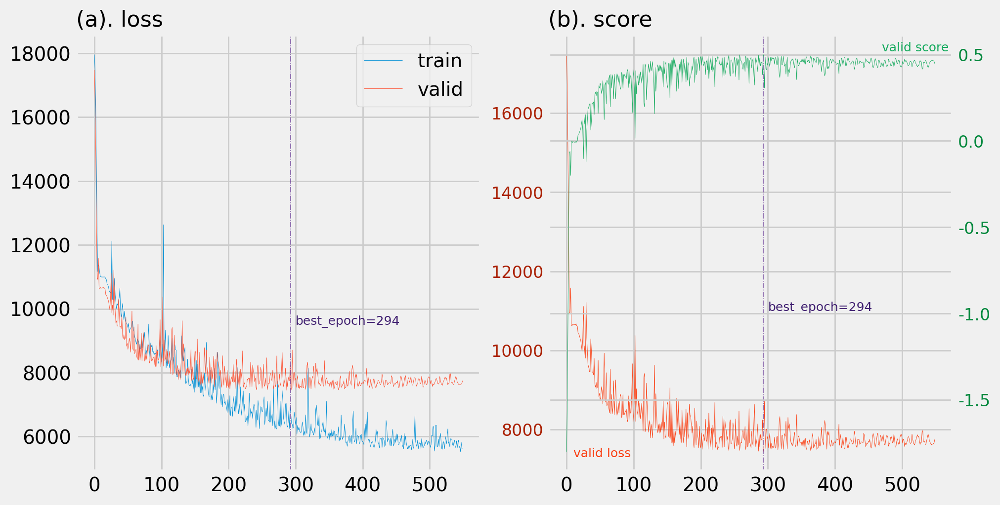

In [ ]:
np.argmin(valid_loss)


loss_train = np.array(train_loss)
loss_valid = np.array(valid_loss)
score_valid = np.array (valid_score)

fig, ax = plt.subplots(1,2,figsize=(10,5))

ax[0].plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax[0].plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
ax[1].plot(range(len(loss_valid)),loss_valid,label='loss',lw=0.3,c='#fa4014')
ax1r=ax[1].twinx()
ax1r.plot(range(len(score_valid)),score_valid,label='score',lw=0.3,c='#14aa5d')

best = np.argmin(loss_valid)

ax[0].axvline(x=best,lw=0.6,ls='dashdot',alpha=0.8,c='#633393')
ax[1].axvline(x=best,lw=0.6,ls='dashdot',alpha=0.8,c='#633393')

#ax.set_yscale('log')
ax[0].legend();
#ax[1].legend();
#ax1r.legend();
ax[1].yaxis.set_label_coords(0.85,0.1,)
ax1r.annotate(text='valid score',c='#14aa5d',fontsize=9,xy=(470,0.52))
ax[1].annotate(text='valid loss',c='#fa4014',fontsize=9,xy=(10,7300))
#ax1r.set_ylabel('valid score',c='#14aa5d',fontsize=9,rotation=0)

ax[0].annotate(text=f'best_epoch={best+1}',fontsize=9,xy=(best+7,9500),c='#422272')
ax[1].annotate(text=f'best_epoch={best+1}',fontsize=9,xy=(best+7,11000),c='#422272')

ax[0].set_title('(a). loss',fontsize=16,loc='left')
ax[1].set_title('(b). score',fontsize=16,loc='left')

ax[1].tick_params(axis="y", labelcolor='#aa2003',labelsize=12)
ax1r.tick_params(axis="y", labelcolor='#04883d',labelsize=12)

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_model_2.4_8_250111.pt'))
criterion = nn.MSELoss()

<ipython-input-41-649d675292a3>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_model_2.4_8_250111.pt'))


5656.028642077407 	r2 :  0.7356173992156982 	mape :  0.3088401257991791


/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5656.028642077407 	r2 :  0.7356173992156982 	mape :  0.3088401257991791


(<Figure size 640x480 with 1 Axes>, <Axes: >)

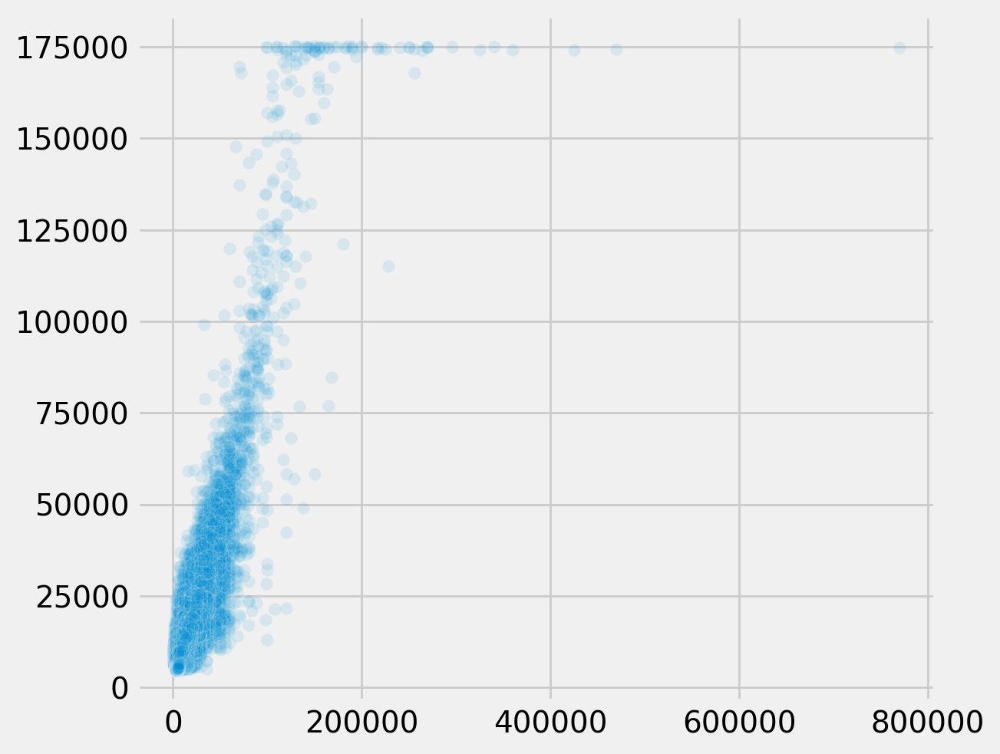

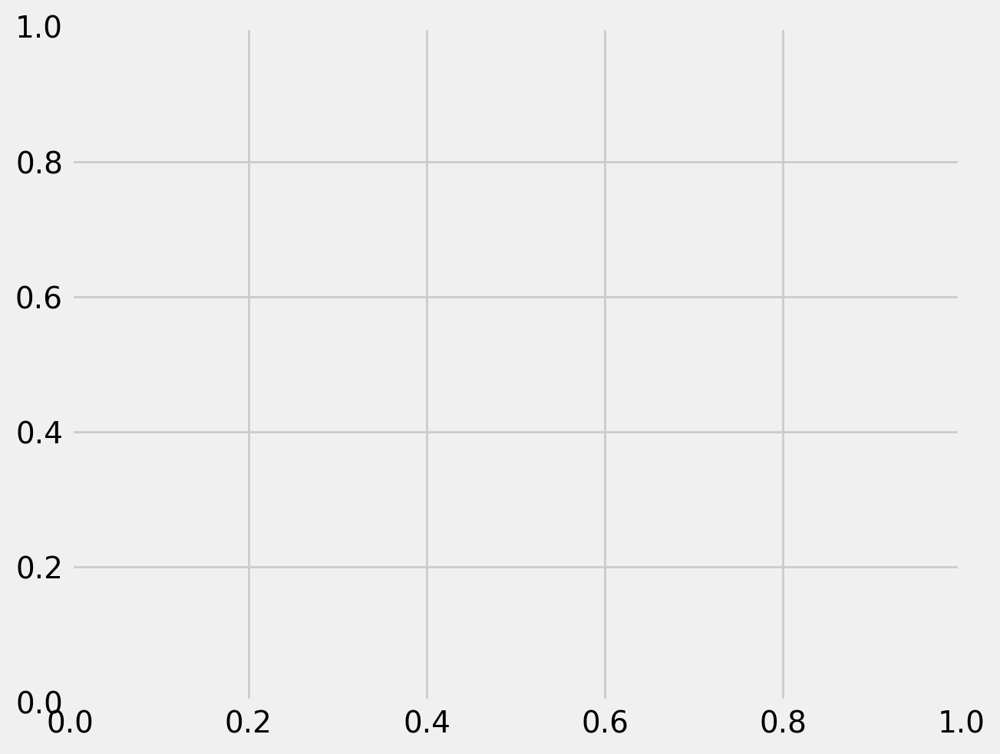

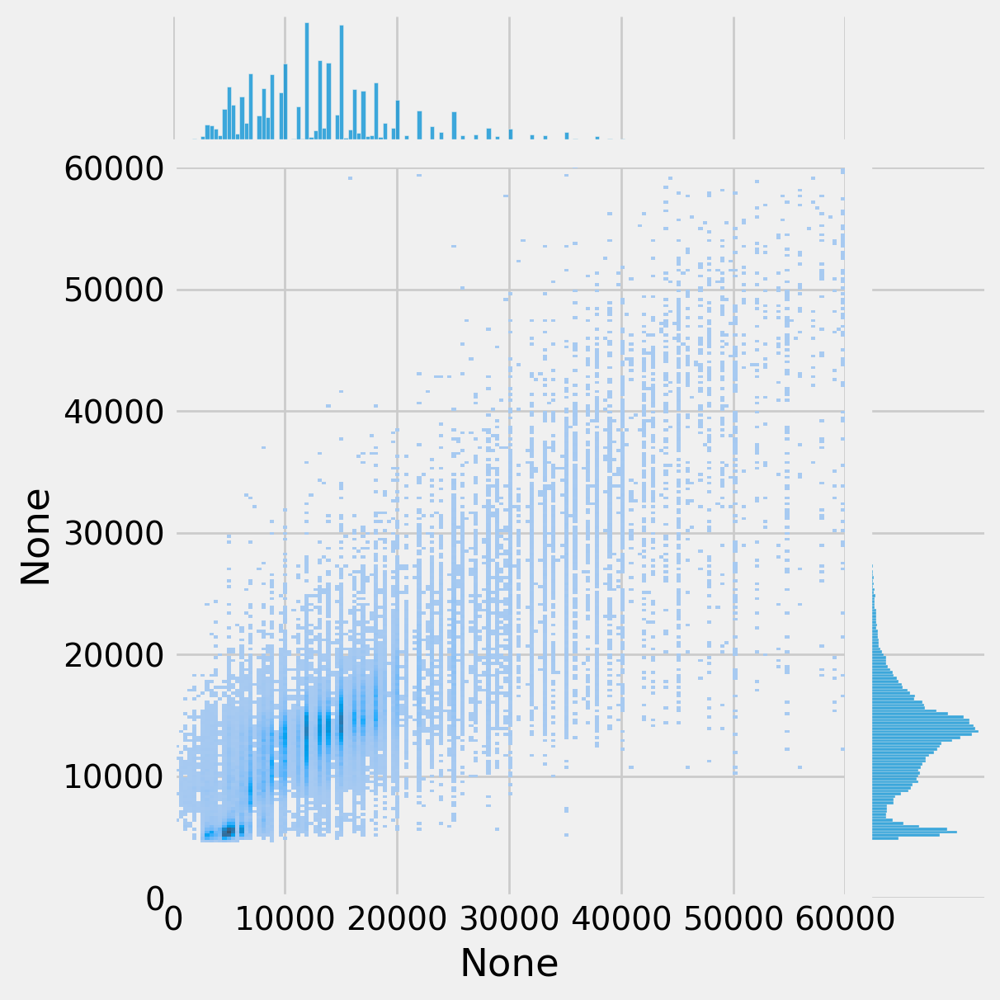

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device,alpha=0.1) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False) #gridsize 500

7308.697558388909 	r2 :  0.4999959468841553 	mape :  0.35717177391052246


/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7308.697558388909 	r2 :  0.4999959468841553 	mape :  0.35717177391052246


(<Figure size 640x480 with 1 Axes>, <Axes: >)

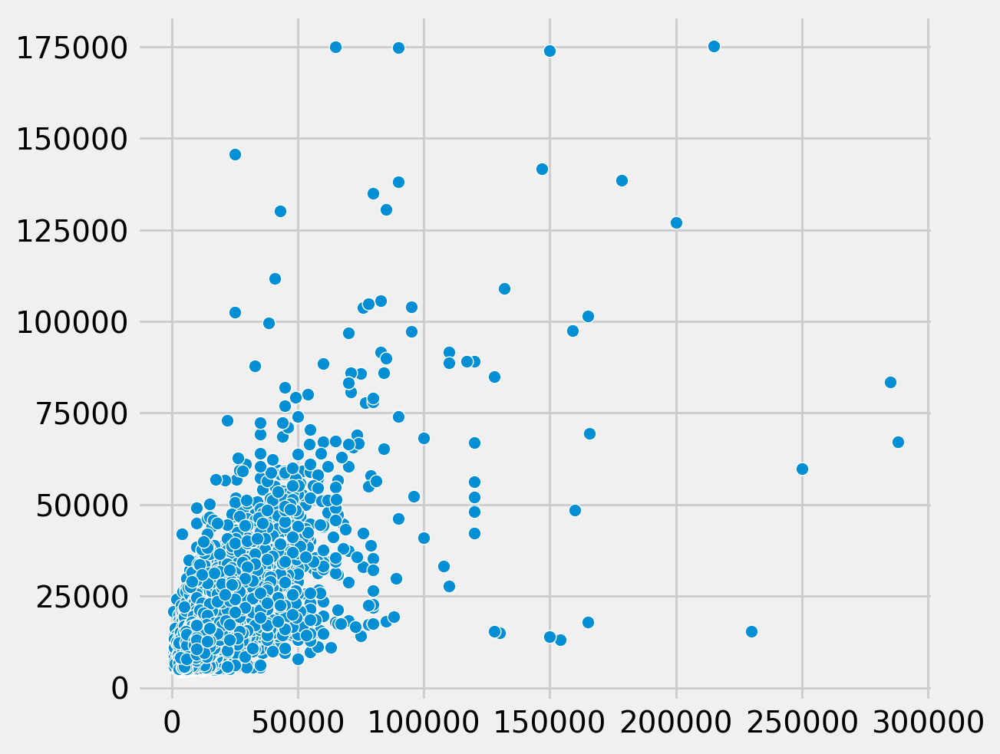

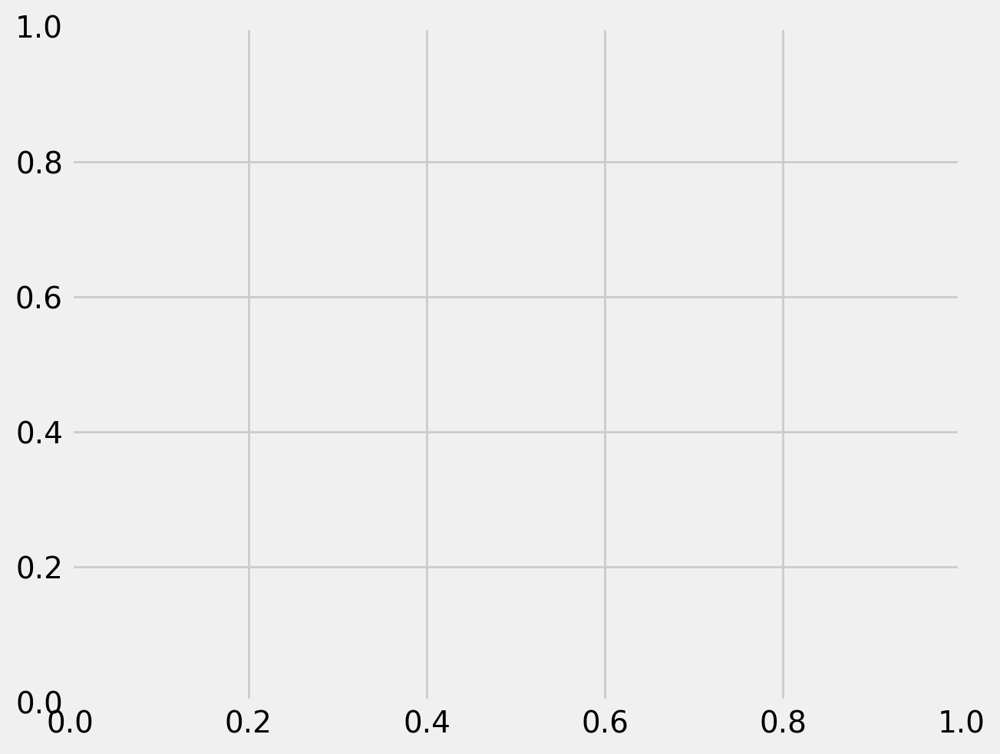

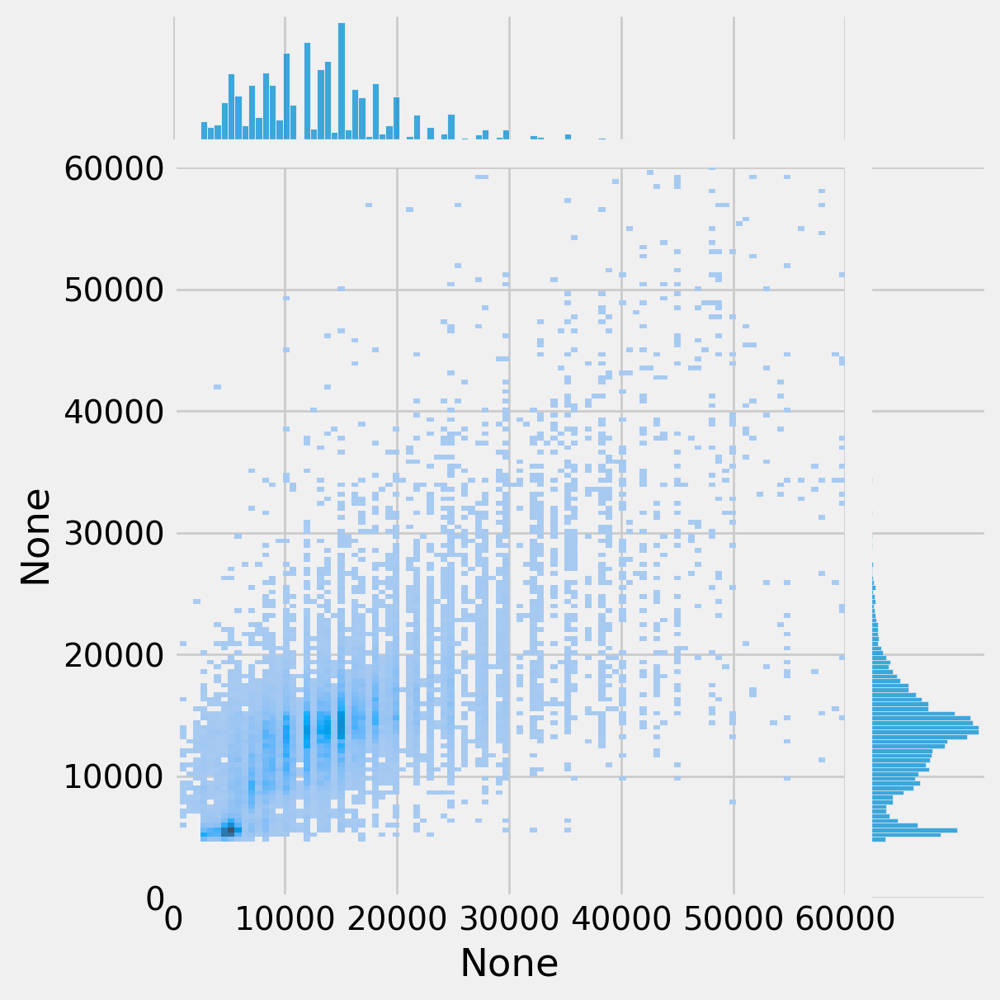

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False) #gridsize 180

8337.542563609495 	r2 :  0.47439950704574585 	mape :  0.35942184925079346


/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8337.542563609495 	r2 :  0.47439950704574585 	mape :  0.35942184925079346


(<Figure size 640x480 with 1 Axes>, <Axes: >)

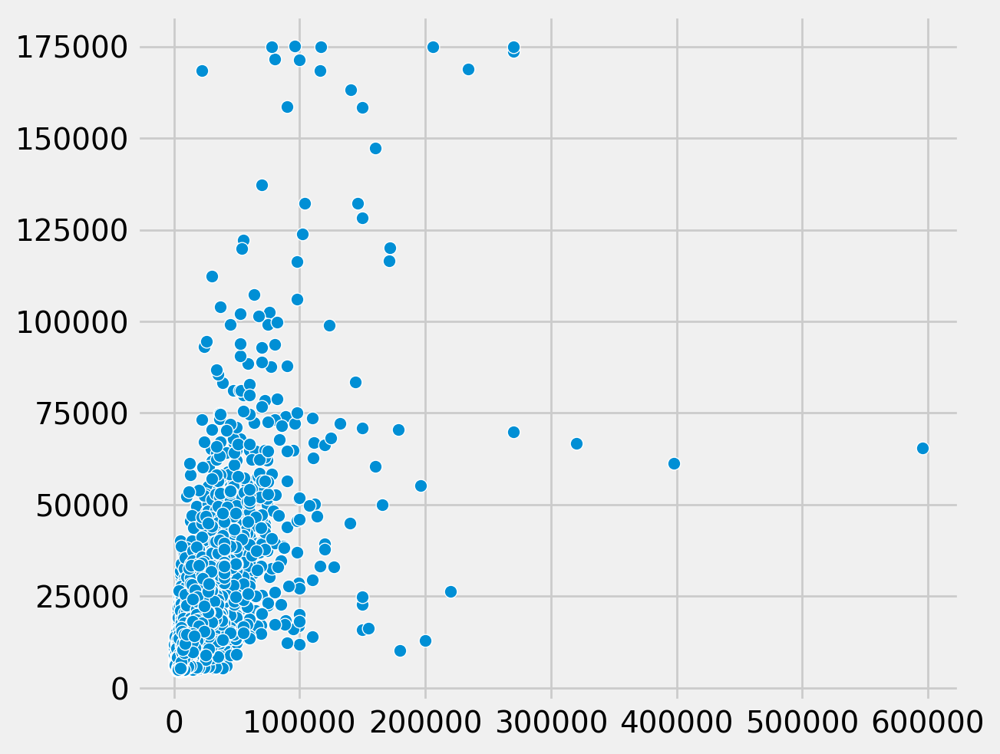

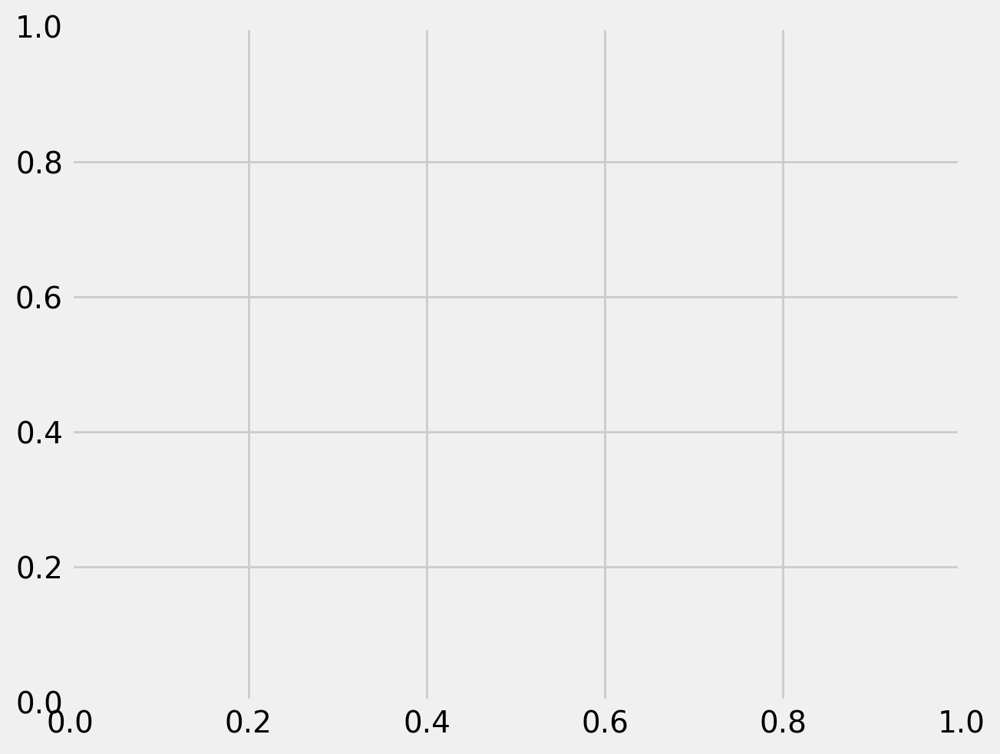

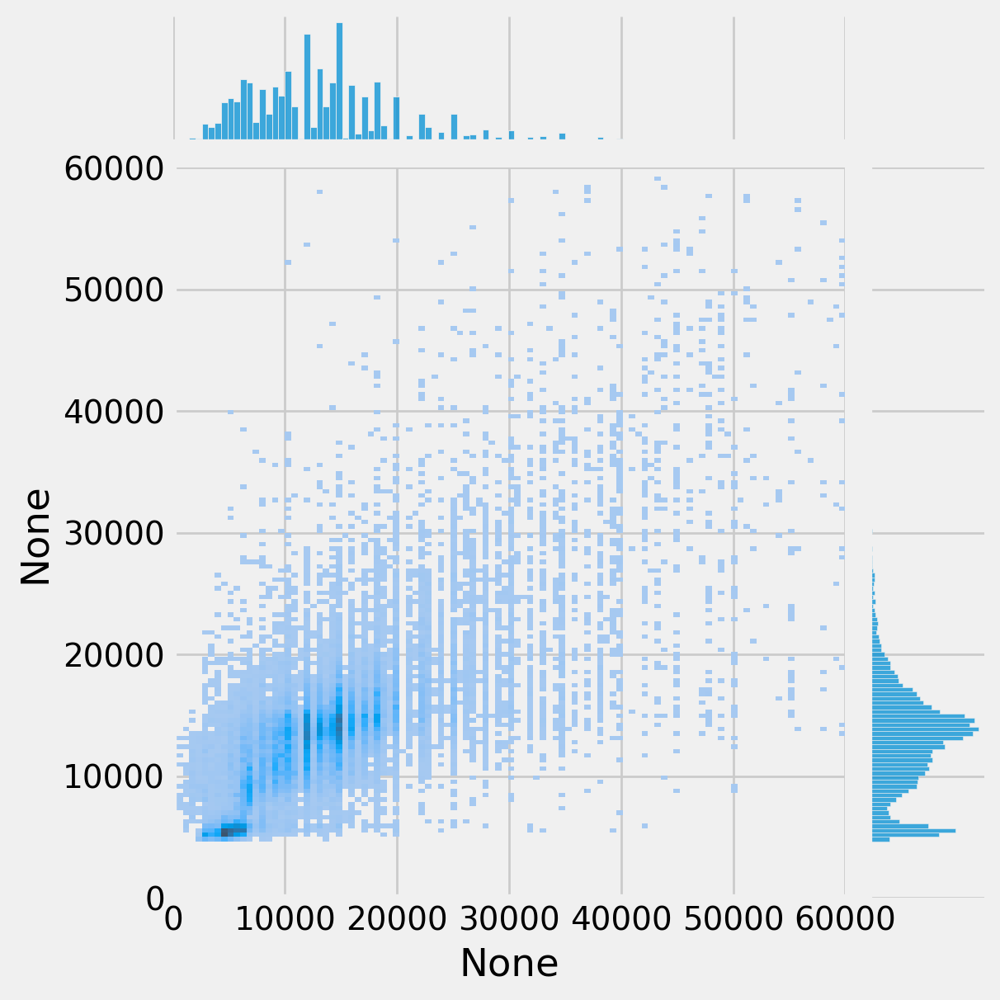

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False)

/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


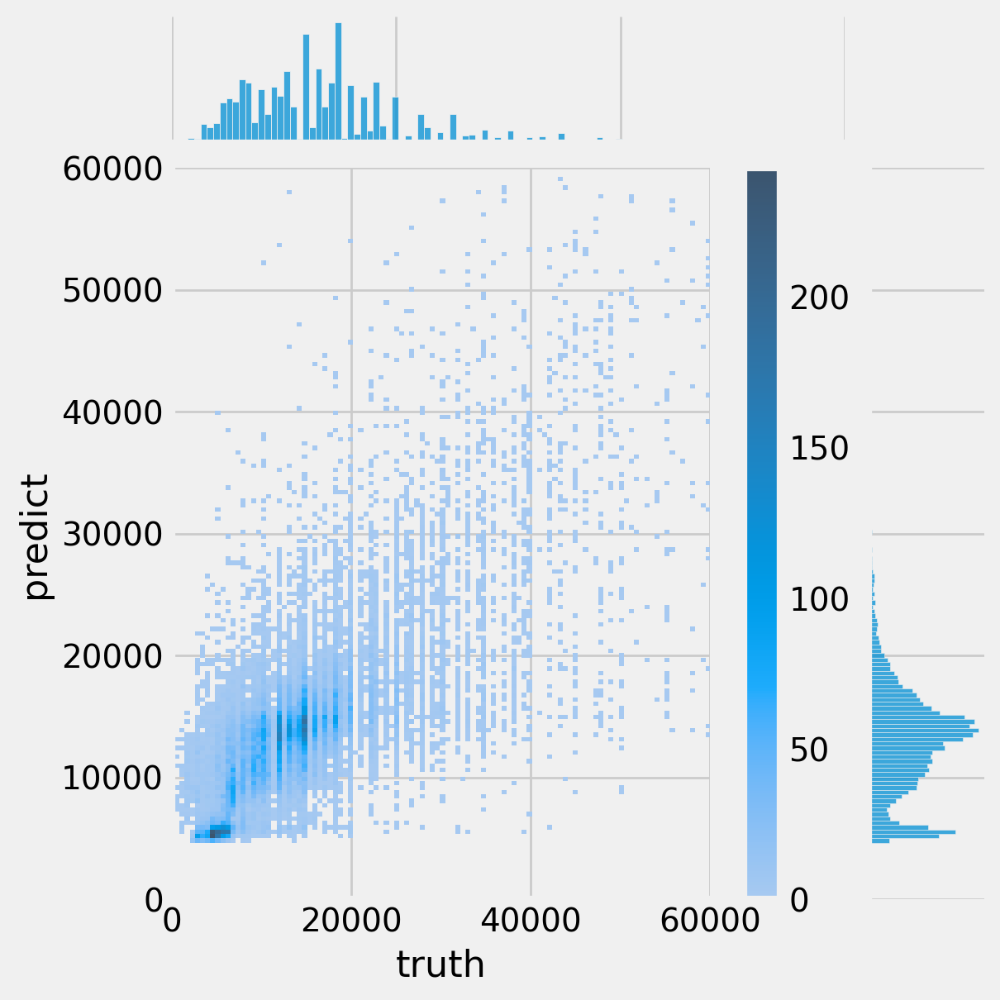

In [ ]:
def test_n_plot2(model, iterator, criterion,device,scatter=True,**kwargs):
    Y_rslt,Y_truth = get_test_rslt(model,iterator,criterion,device)
#    fig,ax = plt.subplots()
    if scatter: sns.scatterplot(x=Y_truth,y=Y_rslt,**kwargs)
    else :
      if 'kind' not in kwargs : kwargs['kind'] = 'hist'
      #g = sns.JointGrid(x=Y_truth, y=Y_rslt, xlim = (0,60000), ylim = (0,60000))
      #cax = g.figure.add_axes([.15, .55, .02, .2])
      g = sns.jointplot(x=Y_truth, y=Y_rslt, xlim = (0,60000), ylim = (0,60000),cbar=True,**kwargs)
      g.set_axis_labels('truth', 'predict', fontsize=16)
      #g.plot_joint(
      #  sns.histplot, discrete=(True, True),
      #   cbar=True, cbar_ax=cax,clip=((0,60000),(0,60000))
      #)#cmap="light:#03012d",
      #g.plot_marginals(sns.histplot, element="step",xlim=(0,60000))#, color="#03012d")

#    return fig,ax

test_n_plot2(best_model,iter_dict['tst'],criterion,device,scatter=False)

/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


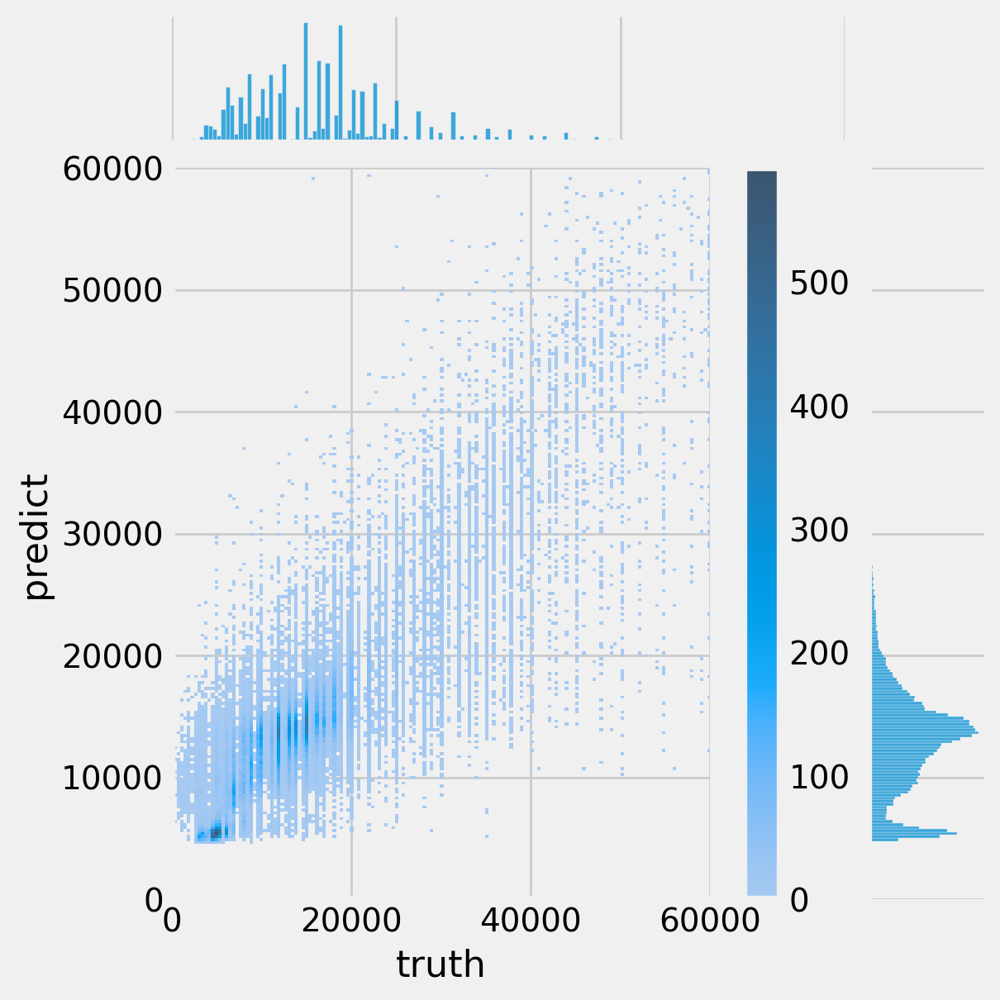

In [ ]:
test_n_plot2(best_model,iter_dict['trn'],criterion,device,scatter=False)

/usr/local/lib/python3.11/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


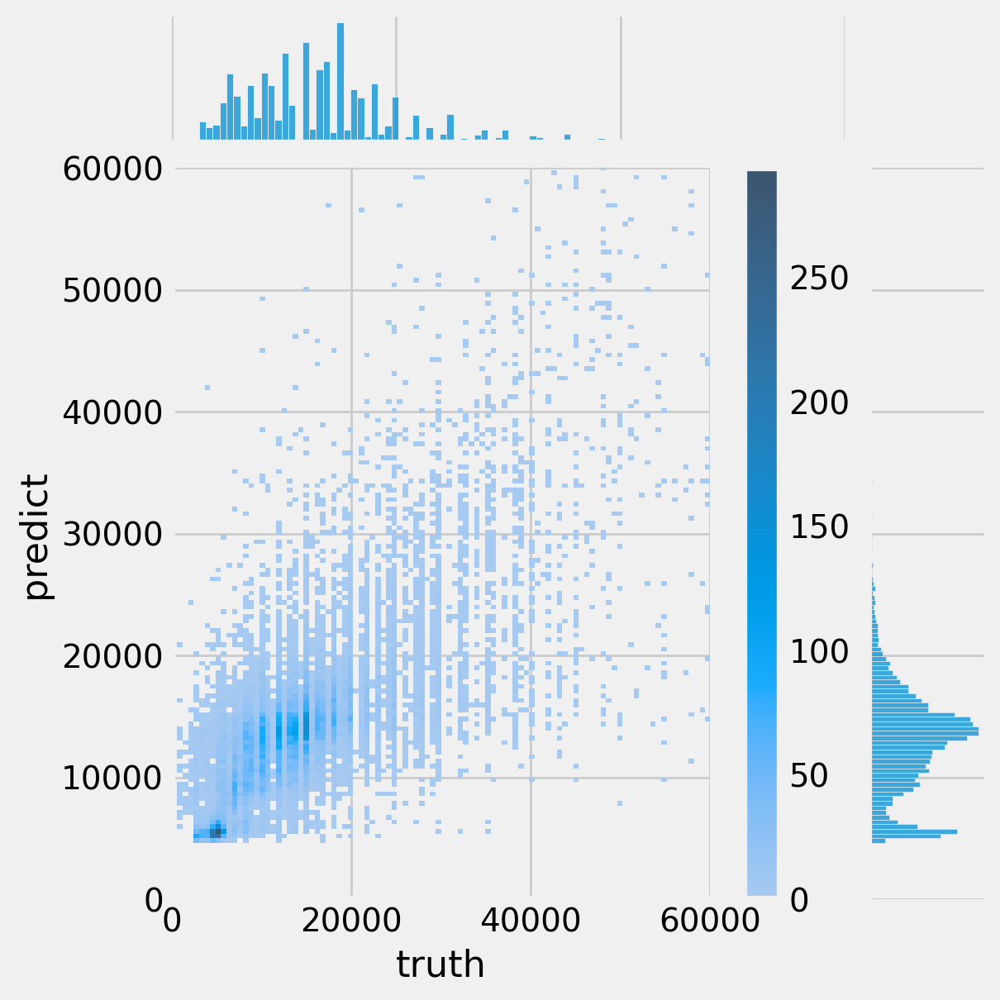

In [ ]:
test_n_plot2(best_model,iter_dict['vld'],criterion,device,scatter=False)

In [ ]:
Y_rslt,Y_truth = get_test_rslt(best_model,iter_dict['tst'],criterion,device)

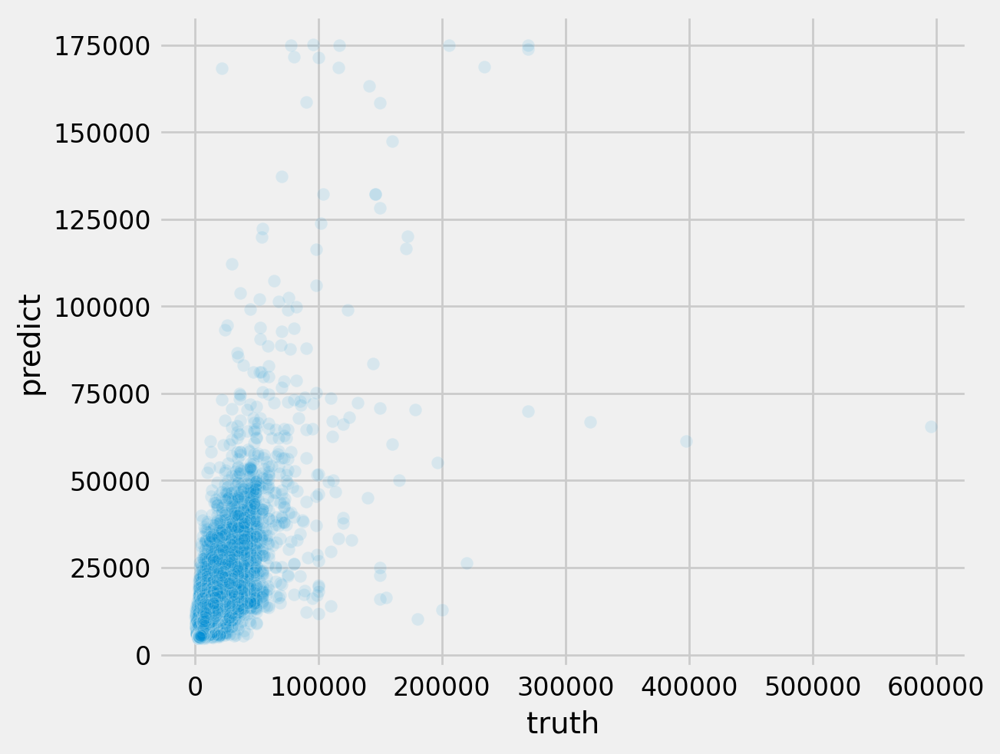

In [ ]:
fig,ax=plt.subplots()
sns.scatterplot(x=Y_truth,y=Y_rslt,alpha=0.1,ax=ax);
ax.set_xlabel('truth',fontsize=14)
ax.set_ylabel('predict',fontsize=14)
ax.tick_params(labelsize=12)

(0.0, 60000.0)

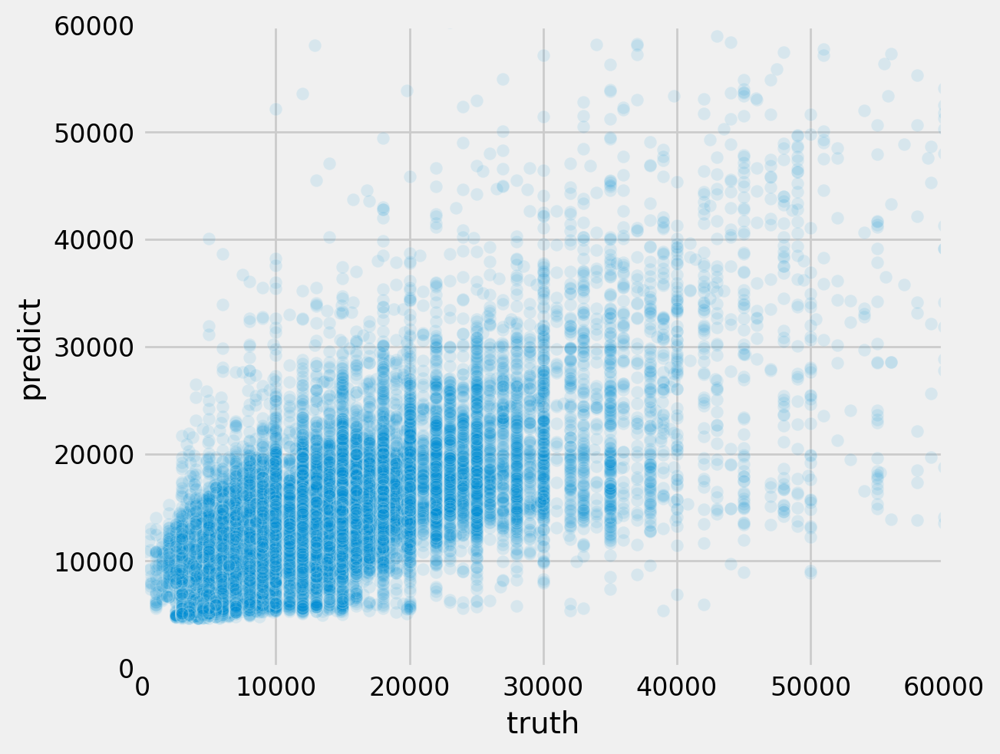

In [ ]:
fig,ax=plt.subplots()
sns.scatterplot(x=Y_truth,y=Y_rslt,alpha=0.1,ax=ax);
ax.set_xlabel('truth',fontsize=14)
ax.set_ylabel('predict',fontsize=14)
ax.tick_params(labelsize=12)
ax.set_xlim(0,60000)
ax.set_ylim(0,60000)

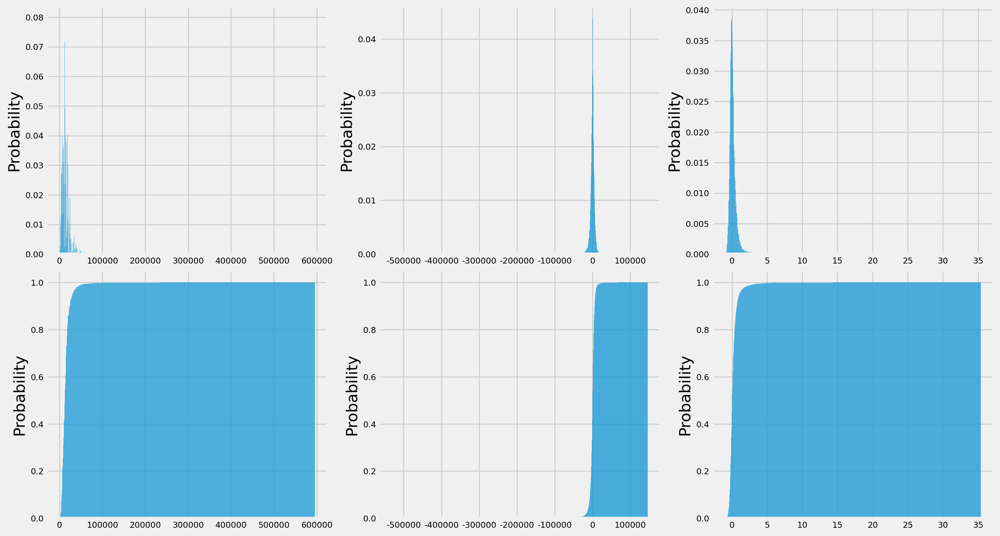

In [ ]:
fig,ax=plt.subplots(2,3,figsize=(15,8))
for i in range(2):
  sns.histplot(x=Y_truth,ax=ax[i][0],cumulative=i,stat='probability')
  sns.histplot(x=Y_rslt-Y_truth,ax=ax[i][1],cumulative=i,stat='probability')
  sns.histplot(x=(Y_rslt-Y_truth)/Y_truth,ax=ax[i][2],cumulative=i,stat='probability')

for ax_i in ax.flatten():
  ax_i.tick_params(labelsize=9)

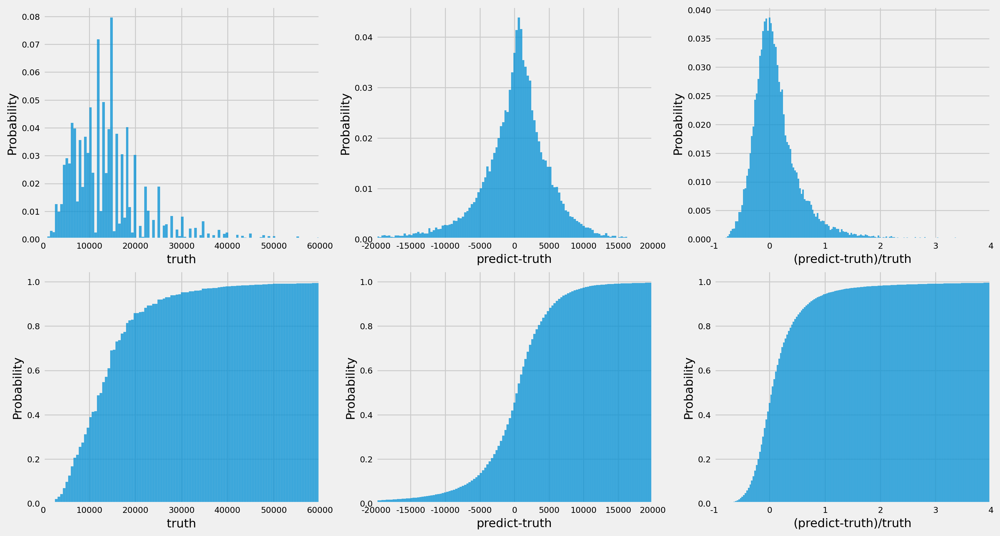

In [ ]:
fig,ax=plt.subplots(2,3,figsize=(15,8))
for i in range(2):
  sns.histplot(x=Y_truth,ax=ax[i][0],cumulative=i,stat='probability')
  ax[i][0].set_xlim(0,60000)
  ax[i][0].set_xlabel('truth',fontsize=13)
  sns.histplot(x=Y_rslt-Y_truth,ax=ax[i][1],cumulative=i,stat='probability')
  ax[i][1].set_xlim(-20000,20000)
  ax[i][1].set_xlabel('predict-truth',fontsize=13)
  sns.histplot(x=(Y_rslt-Y_truth)/Y_truth,ax=ax[i][2],cumulative=i,stat='probability')
  ax[i][2].set_xlim(-1,4)
  ax[i][2].set_xlabel('(predict-truth)/truth',fontsize=13)

for ax_i in ax.flatten():
  ax_i.tick_params(labelsize=9)
  ax_i.yaxis.label.set_size(13)

0.9008761109529684


Text(0.0, 1.0, '(b)')

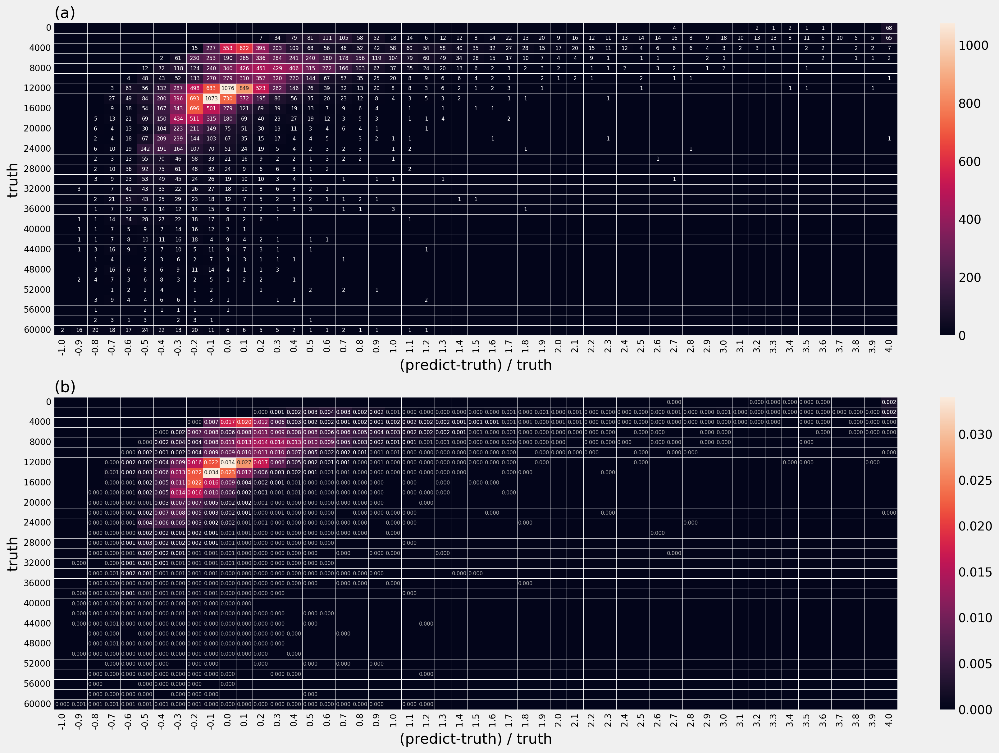

In [ ]:
perc_err = (Y_rslt-Y_truth)/Y_truth
y = (perc_err*100//10)*10/100
y[y > 4] =4
x = (Y_truth //2000)*2000
x[x>60000]=60000
x=x.astype(np.int64)
#sns.histplot(y)
#sns.histplot(x)
temp = pd.crosstab(x,y)

fig,ax=plt.subplots(2,1,figsize=(16,12))
sns.heatmap(temp,ax=ax[0],annot=True,annot_kws={'fontsize':6},fmt='d',linewidths=0.2)

show_annot_array = temp > 0
for text, show_annot in zip(ax[0].texts, show_annot_array.values.flatten()):
    text.set_visible(show_annot)

ax[0].set_ylabel('truth')
ax[0].set_xlabel('(predict-truth) / truth')
ax[0].tick_params(labelsize=10)
ax[0].set_title('(a)',fontsize=18,loc='left')

temp = temp/len(Y_truth)

sns.heatmap(temp,ax=ax[1],annot=True,annot_kws={'fontsize':6},fmt='.3f',linewidths=0.25)

show_annot_array = temp > 0
gray_annot_array = (temp < 0.001) & (temp > 0)
for text, show_annot,gray_annot in zip(ax[1].texts, show_annot_array.values.flatten(),gray_annot_array.values.flatten()):
    text.set_visible(show_annot)
    if gray_annot : text.set_color('#aaaaaa')

ax[1].set_ylabel('truth')
ax[1].set_xlabel('(predict-truth) / truth')


print((temp[temp>=0.001]).sum().sum())
ax[1].tick_params(labelsize=10)
ax[1].set_title('(b)',fontsize=18,loc='left')

0.9008761109529684
0.4818610241325869


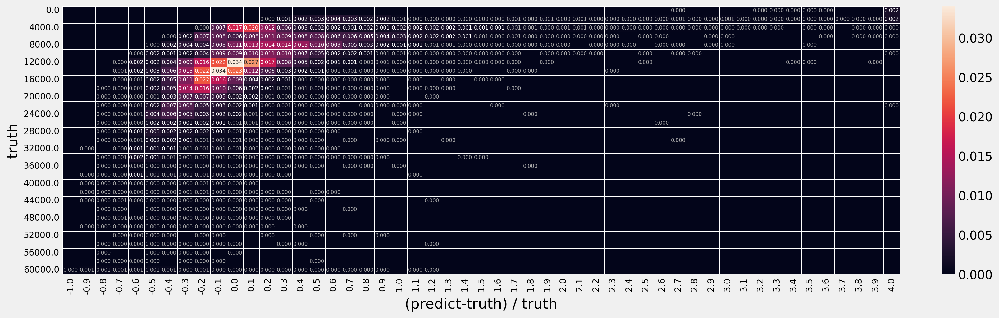

In [ ]:
perc_err = (Y_rslt-Y_truth)/Y_truth
y = (perc_err*100//10)*10/100
y[y > 4] =4
x = (Y_truth //2000)*2000
x[x>60000]=60000
#sns.histplot(y)
#sns.histplot(x)
temp = pd.crosstab(x,y)/len(Y_truth)

for i in range(0,62000,2000):
  if i not in temp.index: temp.loc[i]=np.zeros(len(temp.columns))
temp = temp.sort_index(axis=0)

fig,ax=plt.subplots(figsize=(16,5))
sns.heatmap(temp,ax=ax,annot=True,annot_kws={'fontsize':6},fmt='.3f',linewidths=0.25)

show_annot_array = temp > 0
gray_annot_array = (temp < 0.001) & (temp > 0)
for text, show_annot,gray_annot in zip(ax.texts, show_annot_array.values.flatten(),gray_annot_array.values.flatten()):
    text.set_visible(show_annot)
    if gray_annot : text.set_color('#aaaaaa')

#show_annot_array = (temp < 0.01) & (temp > 0)
#for text, show_annot in zip(ax.texts, show_annot_array.values.flatten()):
#    text.set_color('#aaaaaa')


ax.set_ylabel('truth')
ax.set_xlabel('(predict-truth) / truth')


print((temp[temp>=0.001]).sum().sum())
print((temp[temp>=0.009]).sum().sum())
ax.tick_params(labelsize=10)

In [225]:
perc_err.min(),perc_err.max(),np.abs(perc_err).min()

(-0.94343096, 35.383553, 5.0147805e-06)

In [227]:
np.mean((-1<perc_err)&(perc_err<4))

0.995445488186735

In [ ]:
display((temp[temp.columns[(-0.35 < temp.columns)&(temp.columns<0.3)]]).sum().sum())
display((temp[temp.columns[(-0.45 < temp.columns)&(temp.columns<0.4)]]).sum().sum())

0.6355757978302812

0.7427333396590442

In [ ]:
len(Y_rslt)*0.001

31.617

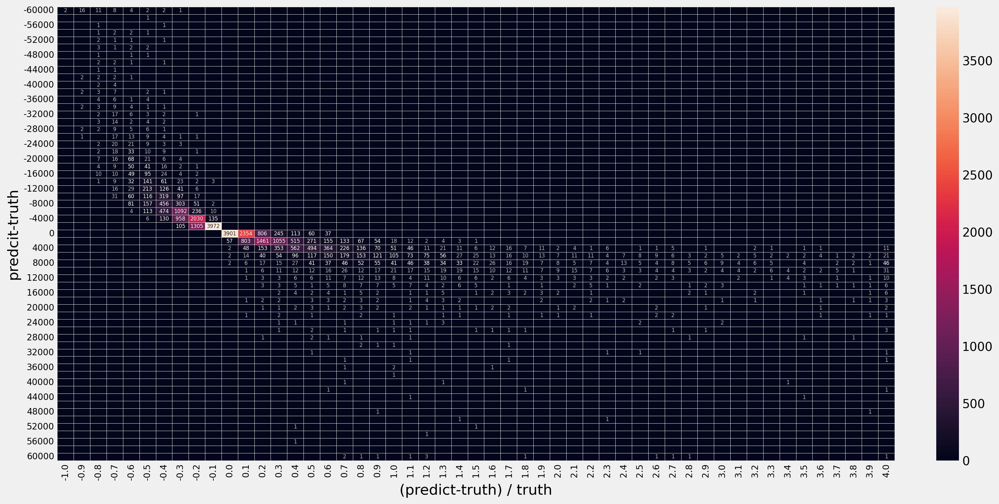

In [ ]:
perc_err = (Y_rslt-Y_truth)/Y_truth
y = (perc_err*100//10)*10/100
y[y > 4] =4
x = ((Y_rslt-Y_truth) //2000)*2000
x[x>60000]=60000
x[x<-60000]=-60000
x=x.astype(np.int64)
#sns.histplot(y)
#sns.histplot(x)
temp = pd.crosstab(x,y)

for i in range(-60000,62000,2000):
  if i not in temp.index: temp.loc[i]=np.zeros(len(temp.columns)).astype(np.int64)
temp = temp.sort_index(axis=0)

fig,ax=plt.subplots(figsize=(16,8))
sns.heatmap(temp,ax=ax,annot=True,annot_kws={'fontsize':6},fmt='d',linewidths=0.3)

show_annot_array = temp > 0
gray_annot_array = (temp < 0.001*len(Y_rslt)) & (temp > 0)
for text, show_annot,gray_annot in zip(ax.texts, show_annot_array.values.flatten(),gray_annot_array.values.flatten()):
    text.set_visible(show_annot)
    if gray_annot : text.set_color('#bbbbbb')

ax.set_ylabel('predcit-truth')
ax.set_xlabel('(predict-truth) / truth')
ax.tick_params(axis="y", labelsize=10)
ax.tick_params(axis="x", labelsize=10)

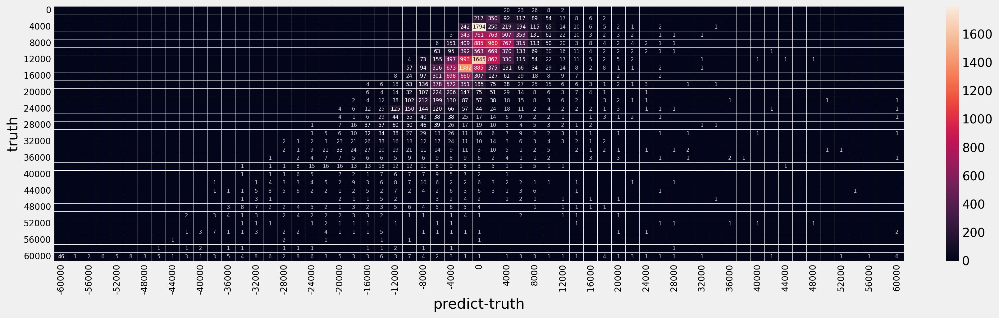

In [ ]:
y = ((Y_rslt-Y_truth) //2000)*2000
y[y>60000]=60000
y[y<-60000]=-60000
y=y.astype(np.int64)

x = (Y_truth //2000)*2000
x[x>60000] = 60000
x=x.astype(np.int64)

temp = pd.crosstab(x,y)
for i in range(-60000,62000,2000):
  if i not in temp.columns: temp[i]=np.zeros(len(temp)).astype(np.int64)

temp = temp.sort_index(axis=1)

fig,ax=plt.subplots(figsize=(16,5))
sns.heatmap(temp,ax=ax,annot=True,annot_kws={'fontsize':6},fmt='d',linewidths=0.3)

show_annot_array = temp > 0
gray_annot_array = (temp < 0.001*len(Y_rslt)) & (temp > 0)
for text, show_annot,gray_annot in zip(ax.texts, show_annot_array.values.flatten(),gray_annot_array.values.flatten()):
    text.set_visible(show_annot)
    if gray_annot : text.set_color('#c3c3c3')

ax.set_ylabel('truth')
ax.set_xlabel('predict-truth')
#ax.set_yticklabels(y_ticks, rotation=0, fontsize=8)
ax.tick_params(axis="y", labelsize=10)
ax.tick_params(axis="x", labelsize=10)

In [ ]:
temp.loc[60000]

,60000
col_0,
-60000,0.235897
-58000,0.005128
-56000,0.010256
-54000,0.030769
-52000,0.025641
...,...
52000,0.005128
54000,0.000000
56000,0.005128


<ipython-input-216-15f3b9fc6838>:17: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.25316455696202533' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()
<ipython-input-216-15f3b9fc6838>:17: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.2911392405063291' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()
<ipython-input-216-15f3b9fc6838>:17: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.3291139240506329' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()
<ipython-input-216-15f3b9fc6838>:17: FutureWarni

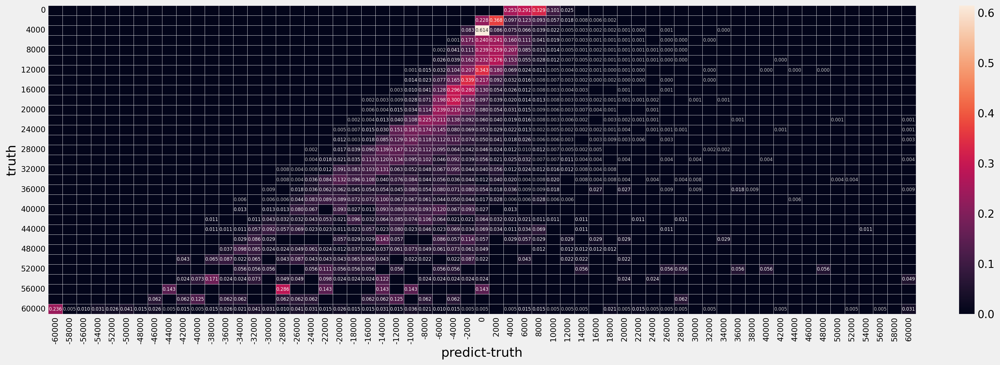

In [ ]:
y = ((Y_rslt-Y_truth) //2000)*2000
y[y>60000]=60000
y[y<-60000]=-60000
y=y.astype(np.int64)

x = (Y_truth //2000)*2000
x[x>60000] = 60000
x=x.astype(np.int64)

temp = pd.crosstab(x,y)
for i in range(-60000,62000,2000):
  if i not in temp.columns: temp[i]=np.zeros(len(temp)).astype(np.int64)

temp = temp.sort_index(axis=1)

for i in temp.index:
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()

fig,ax=plt.subplots(figsize=(18,6.5))
sns.heatmap(temp,ax=ax,annot=True,annot_kws={'fontsize':6},fmt='.3f',linewidths=0.3)

show_annot_array = temp > 0
gray_annot_array = (temp < 0.01) & (temp > 0)
for text, show_annot,gray_annot in zip(ax.texts, show_annot_array.values.flatten(),gray_annot_array.values.flatten()):
    text.set_visible(show_annot)
    if gray_annot : text.set_color('#c3c3c3')

ax.set_ylabel('truth')
ax.set_xlabel('predict-truth')
#ax.set_yticklabels(y_ticks, rotation=0, fontsize=8)
ax.tick_params(axis="y", labelsize=10)
ax.tick_params(axis="x", labelsize=10)

<ipython-input-218-47c297f8d1ca>:14: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.05063291139240506' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()
<ipython-input-218-47c297f8d1ca>:14: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.02531645569620253' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()
<ipython-input-218-47c297f8d1ca>:14: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0.012658227848101266' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()
<ipython-input-218-47c297f8d1ca>:14: FutureWa

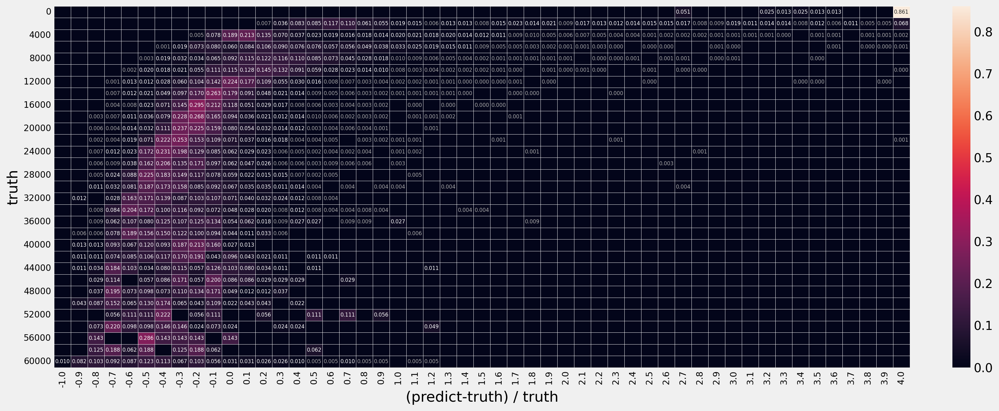

In [ ]:
perc_err = (Y_rslt-Y_truth)/Y_truth
y = (perc_err*100//10)*10/100
y[y > 4] =4
x = (Y_truth //2000)*2000
x[x>60000]=60000
x=x.astype(np.int64)
#sns.histplot(y)
#sns.histplot(x)
temp = pd.crosstab(x,y)

fig,ax=plt.subplots(figsize=(16,6.5))

for i in temp.index:
  temp.loc[i]=temp.loc[i]/temp.loc[i].sum()

sns.heatmap(temp,ax=ax,annot=True,annot_kws={'fontsize':6},fmt='.3f',linewidths=0.25)

show_annot_array = temp > 0
gray_annot_array = (temp < 0.01) & (temp > 0)
for text, show_annot,gray_annot in zip(ax.texts, show_annot_array.values.flatten(),gray_annot_array.values.flatten()):
    text.set_visible(show_annot)
    if gray_annot : text.set_color('#aaaaaa')

ax.set_ylabel('truth')
ax.set_xlabel('(predict-truth) / truth')


#print((temp[temp>=0.001]).sum().sum())
ax.tick_params(labelsize=10)
#ax.set_title('(b)',fontsize=18,loc='left')

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_truth<25000) & (Y_rslt<25000)]
Y = Y_rslt[(Y_truth<25000) & (Y_rslt < 25000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.3696497678756714, 0.3522627651691437, 3977.27392578125)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_truth<60000) & (Y_rslt<60000)]
Y = Y_rslt[(Y_truth<60000) & (Y_rslt < 60000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.49628329277038574, 0.35757118463516235, 5674.12060546875)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_rslt<25000)]
Y = Y_rslt[(Y_rslt < 25000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.34773772954940796, 0.3553493320941925, 5982.70166015625)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_rslt>25000)]
Y = Y_rslt[(Y_rslt>25000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.29057639837265015, 0.4302968978881836, 25620.09765625)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(25000<Y_rslt)&(Y_rslt<60000)]
Y = Y_rslt[(25000<Y_rslt)&(Y_rslt<60000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.18922102451324463, 0.4124962091445923, 15739.3837890625)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_rslt<50000)]
Y = Y_rslt[(Y_rslt<50000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.4521656036376953, 0.3579329550266266, 6675.97607421875)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_rslt<60000)]
Y = Y_rslt[(Y_rslt<60000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.4652721881866455, 0.35824015736579895, 6820.06787109375)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_rslt<70000)]
Y = Y_rslt[(Y_rslt<70000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.42898738384246826, 0.3585736155509949, 7969.5498046875)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_rslt>60000)]
Y = Y_rslt[(Y_rslt>60000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.006282627582550049, 0.6571485996246338, 76579.1640625)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_truth>60000)]
Y = Y_rslt[(Y_truth>60000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(-0.601321816444397, 0.46939244866371155, 78678.359375)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_truth>20000)]
Y = Y_rslt[(Y_truth>20000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.0963553786277771, 0.31052157282829285, 19583.708984375)

In [ ]:
from sklearn.metrics import root_mean_squared_error as rmse

X = Y_truth[(Y_truth<60000)]
Y = Y_rslt[(Y_truth<60000)]

r2_score(X,Y),mape(X,Y),rmse(X,Y)

(0.45871907472610474, 0.3588240444660187, 5939.2998046875)

In [ ]:
X = Y_truth[(Y_truth<25000) & (Y_rslt<25000)]
Y = Y_rslt[(Y_truth<25000) & (Y_rslt < 25000)]

r2_score(X,Y),mape(X,Y)

(0.3696497678756714, 0.3522627651691437)

In [ ]:
err = Y_rslt - Y_truth
np.mean((-20000 <= err) & (err < 20000))

0.9829205807002562

In [ ]:
err = Y_rslt - Y_truth
np.mean((-8337.54<= err) & (err < 8337.54))

0.8893633172027706

In [ ]:
err = Y_rslt - Y_truth
print(err.min(), err.max())
print(np.mean((-6000<= err) & (err < 6000)))
print(np.mean((-3000<= err) & (err < 3000)))

-530609.5 146356.1
0.8012777935920549
0.5503684726571149


In [ ]:
k = rmse(Y_truth,Y_rslt)
abs_err = np.abs(Y_rslt - Y_truth)
print(np.mean(abs_err < k))
print(abs_err.min(),abs_err.max())

0.8893633172027706
0.07421875 530609.5


In [ ]:
np.mean(abs_err)

4163.466

In [ ]:
print(rmse(Y_truth[abs_err<6000],Y_rslt[abs_err<6000]))
print(np.mean(abs_err[abs_err<6000]))

2777.884521484375
2261.5757


In [ ]:
print(rmse(Y_truth[abs_err<k],Y_rslt[abs_err<k]))
print(np.mean(abs_err[abs_err<k]))

3443.69775390625
2731.5464


<Axes: ylabel='Count'>

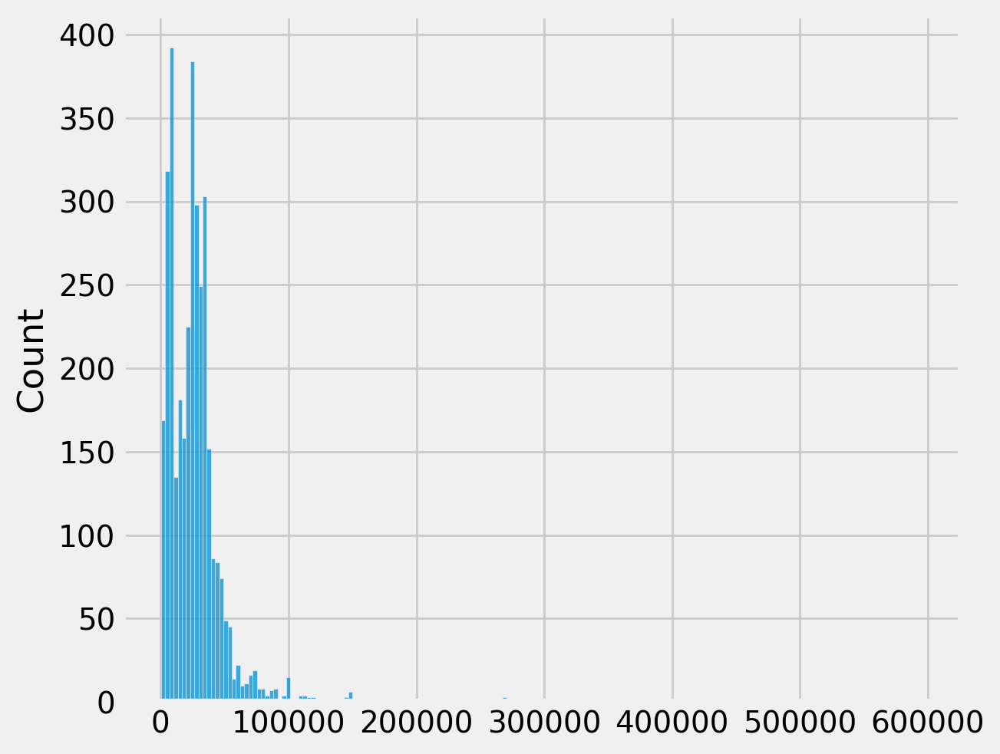

In [ ]:
sns.histplot(Y_truth[abs_err>k])

<Axes: ylabel='Count'>

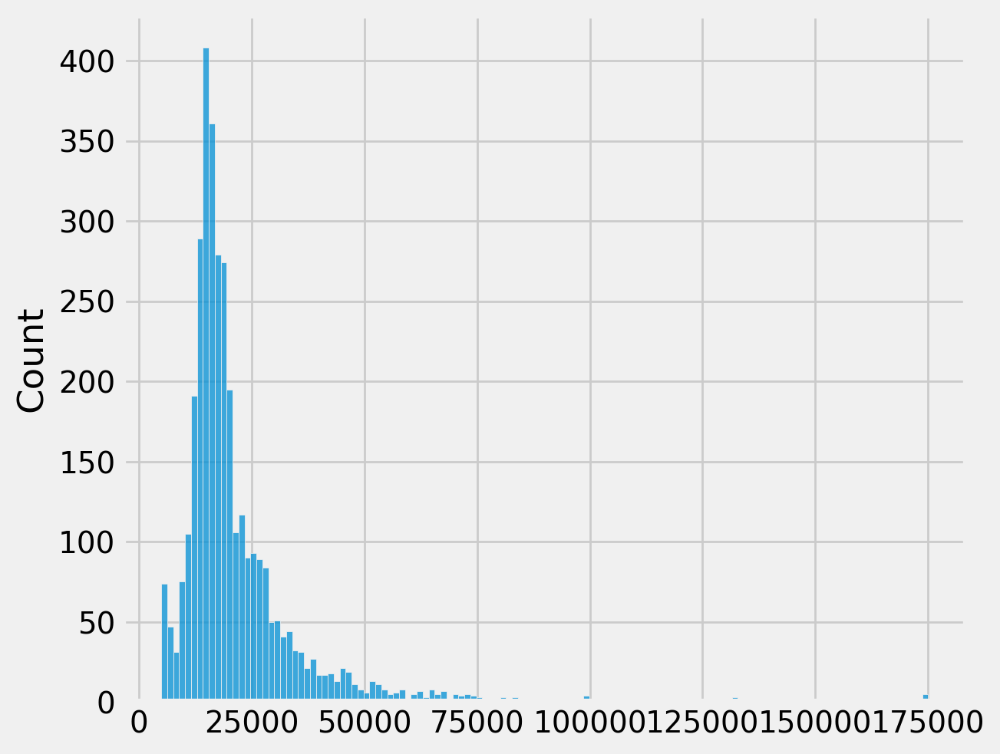

In [ ]:
sns.histplot(Y_rslt[abs_err>k])

In [ ]:
print(rmse(Y_truth[abs_err<6000],Y_rslt[abs_err<6000]))
print(np.mean(abs_err[abs_err<6000]))

2777.884521484375
2261.5757


In [ ]:
print(np.mean(abs_err < 3000))

0.5503684726571149


In [ ]:
err = Y_rslt - Y_truth
np.mean((-5000 <= err) & (err < 5000))

0.7393490843533542

In [ ]:
temp=[[0 for _ in range(3)] for _ in range(3)]

In [ ]:
temp

[[0, 0, 0], [0, 0, 0], [0, 0, 0]]

In [ ]:
ls {RSLT_DIR}

bookinfo_ver1.0.csv  etc/  model/  model_input/  model_test/


In [ ]:
data_dict_origin =load_pkl(os.path.join(RSLT_DIR,'model_input','data_splitted_ver1.0_strat-False.pkl'))
bookinfo_raw = pd.read_csv(os.path.join(RSLT_DIR,'bookinfo_ver1.0.csv'))

In [ ]:
data_dict_origin['test']['X'].columns

Index(['ItemId', 'used_idx', 'delivery_fee', 'quality', 'store', 'url'], dtype='object')

In [ ]:
test_data = data_dict_origin['test']['X'].set_index('ItemId')
#book_test = book_info[book_info['ItemId'].isin(test_data['ItemId'])]
bookinfo_raw = book_info.set_index('ItemId')
#test_data['Pdate'] = test_data['Pdate'].astype(str)

In [ ]:
from sklearn.model_selection import train_test_split

cols = bookinfo_raw.columns.to_list()
x_idxs, y_idx = [0,2,3,4,5,6,9,10], 7
x_cols = [cols[i] for i in x_idxs]
y_col = cols[y_idx]

data_X, data_y  = bookinfo_raw[x_cols], bookinfo_raw[y_col]

X_data, X_tst, y_data, y_tst = train_test_split(data_X,data_y,test_size=0.2,random_state=329)

In [ ]:
Pdate_test = pd.to_datetime(X_tst['Pdate'].astype(str),format='%Y%m%d')

In [ ]:
len(Pdate_test),len(abs_err),len(Y_truth),len(data_dict['tst']['X'])

(31617, 31617, 31617, 31617)

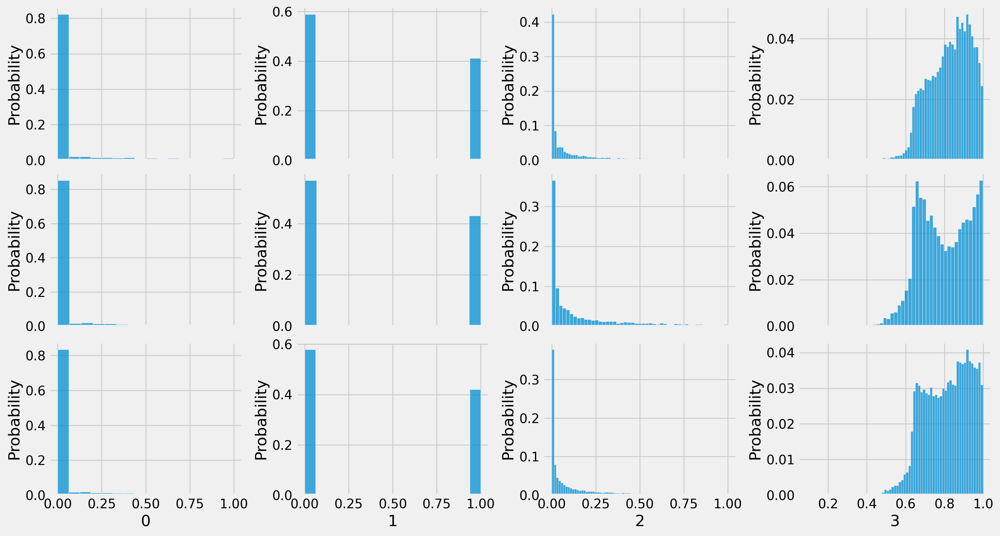

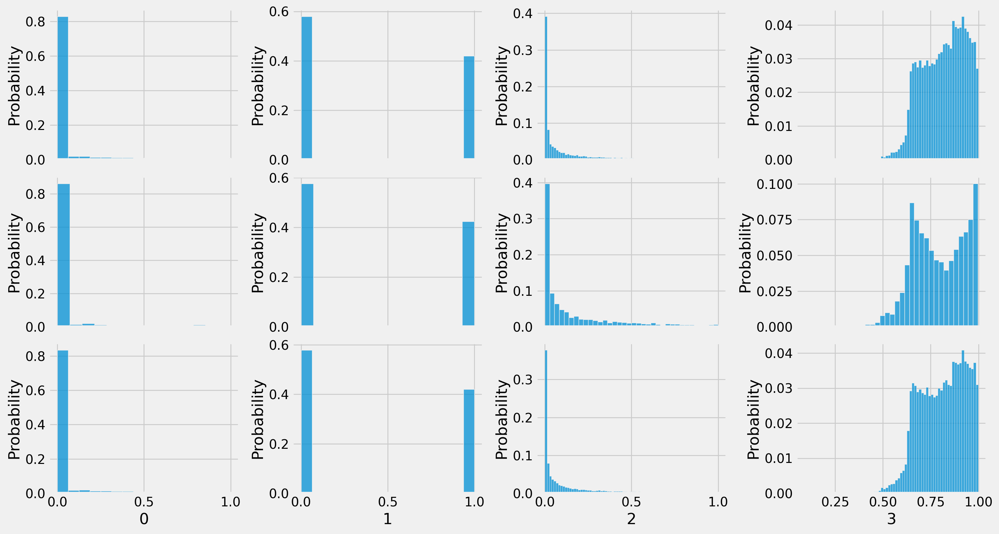

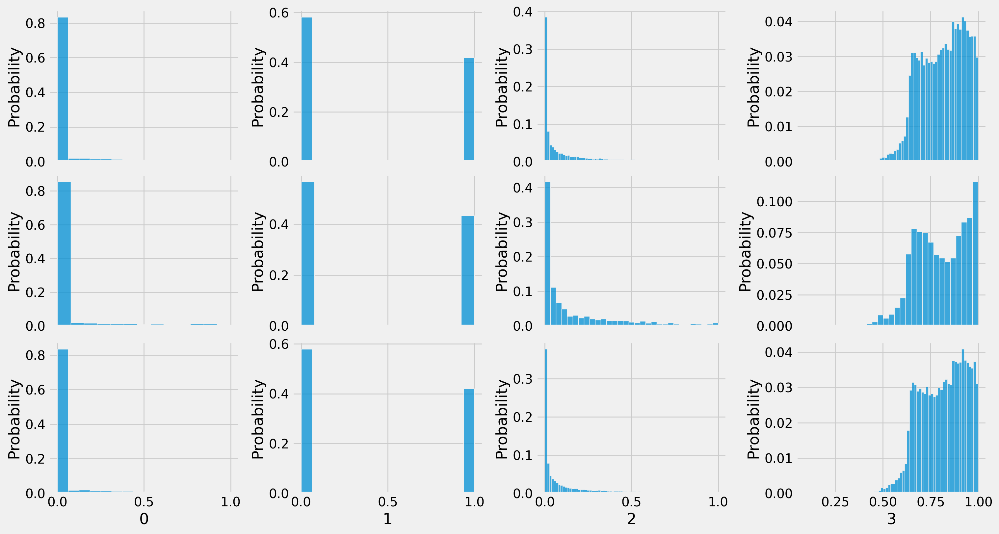

In [ ]:
ths_list1 = [3000,6000,rmse(Y_truth,Y_rslt)]

temp1 = defaultdict(list)

for ths in ths_list1:
  temp1[ths].append(pd.DataFrame(data_dict['tst']['X'][abs_err <= ths,-5:-1]))
  temp1[ths].append(pd.DataFrame(data_dict['tst']['X'][abs_err > ths,-5:-1]))
  temp1[ths].append(pd.DataFrame(data_dict['tst']['X'][:,-5:-1]))

  fig,ax = plt.subplots(3,4,figsize=(15,8),sharex='col')
  for i in range(4):
    for j in range(3):
      sns.histplot(data=temp1[ths][j],x=i,ax=ax[j][i],stat='probability')


In [ ]:
pd.DataFrame(Pdate_test[abs_err <= ths])

,Pdate
146028,2022-06-17
33656,2004-02-10
78736,2012-05-25
79497,2012-06-29
79130,2012-05-30
...,...
109628,2017-02-16
118894,2018-08-23
42715,2006-11-07
143307,2021-03-18


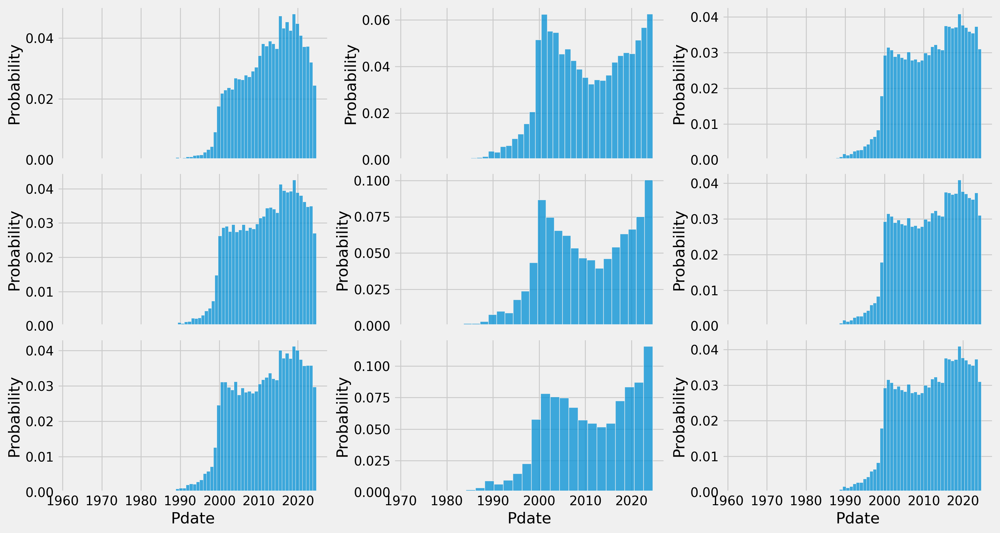

In [ ]:
ths_list1 = [3000,6000,rmse(Y_truth,Y_rslt)]

temp10 = defaultdict(list)

fig,ax = plt.subplots(3,3,figsize=(15,8),sharex='col')
for i,ths in enumerate(ths_list1):
  temp10[ths].append(pd.DataFrame(Pdate_test[abs_err <= ths]))
  temp10[ths].append(pd.DataFrame(Pdate_test[abs_err > ths]))
  temp10[ths].append(pd.DataFrame(Pdate_test[:]))

  for j in range(3):
    sns.histplot(data=temp10[ths][j],x='Pdate',ax=ax[i][j],stat='probability')


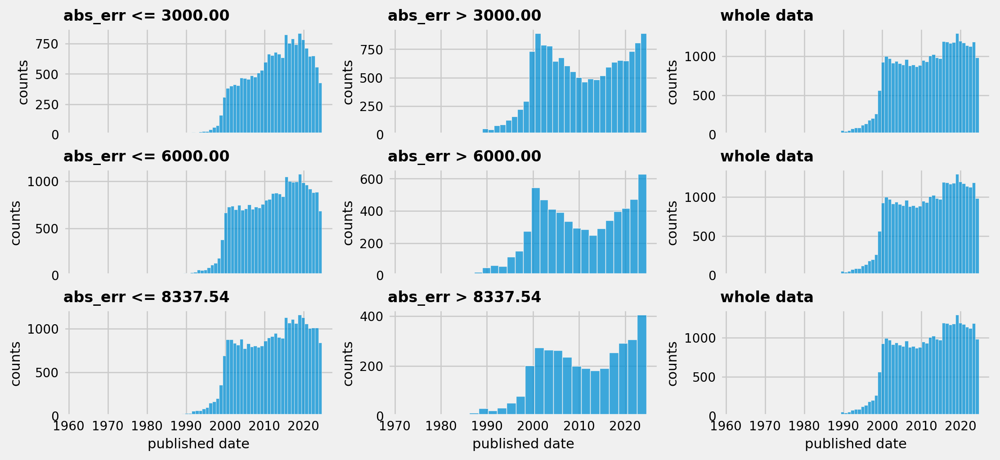

In [ ]:
temp10=defaultdict(list)

fig,ax = plt.subplots(len(ths_list1),3,figsize=(11,5),sharex='col')
for i,ths in enumerate(ths_list1):
  temp10[ths].append(pd.DataFrame(Pdate_test[abs_err <= ths]))
  temp10[ths].append(pd.DataFrame(Pdate_test[abs_err > ths]))
  temp10[ths].append(pd.DataFrame(Pdate_test[:]))
  for j in range(3):
    sns.histplot(data=temp10[ths][j],x='Pdate',ax=ax[i][j])
  ax[i][0].set_title(f'abs_err <= {ths:.2f}',fontsize=12,loc='left',fontweight='bold')
  ax[i][1].set_title(f'abs_err > {ths:.2f}',fontsize=12,loc='left',fontweight='bold')
  ax[i][2].set_title(f'whole data',fontsize=12,loc='left',fontweight='bold')
for ax_i in ax.flatten():
 ax_i.tick_params(axis="y", labelsize=10)
 ax_i.tick_params(axis="x", labelsize=10)
 ax_i.set_xlabel('published date',fontsize=11)
 ax_i.set_ylabel('counts',fontsize=11)


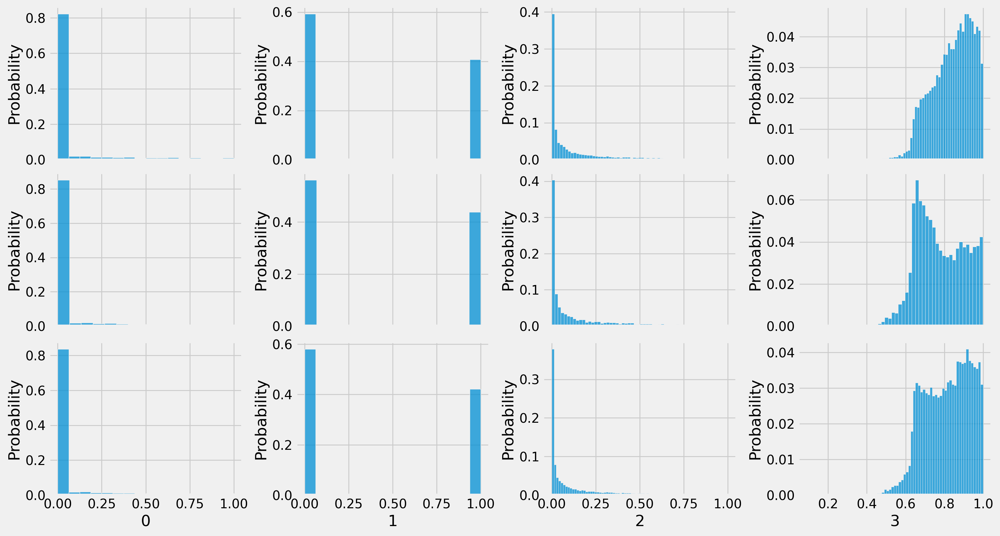

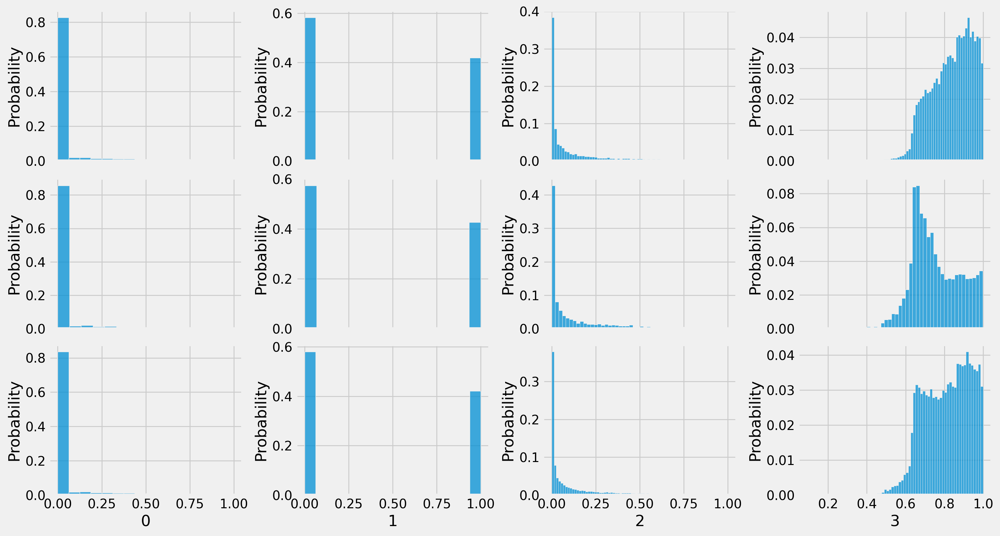

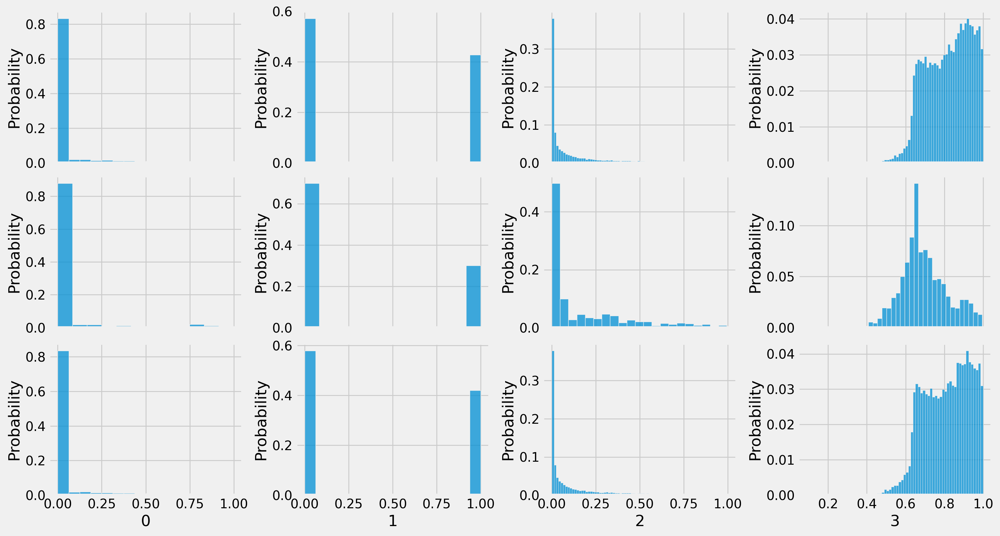

In [ ]:
ths_list2 = [0.25,mape(Y_truth,Y_rslt),1.0]

temp2 = defaultdict(list)

for ths in ths_list2:
  temp2[ths].append(pd.DataFrame(data_dict['tst']['X'][abs_err/Y_truth <= ths,-5:-1]))
  temp2[ths].append(pd.DataFrame(data_dict['tst']['X'][abs_err/Y_truth > ths,-5:-1]))
  temp2[ths].append(pd.DataFrame(data_dict['tst']['X'][:,-5:-1]))

  fig,ax = plt.subplots(3,4,figsize=(15,8),sharex='col')
  for i in range(4):
    for j in range(3):
      sns.histplot(data=temp2[ths][j],x=i,ax=ax[j][i],stat='probability')


In [ ]:
np.mean(abs_err/Y_truth) == mape(Y_truth,Y_rslt)

True

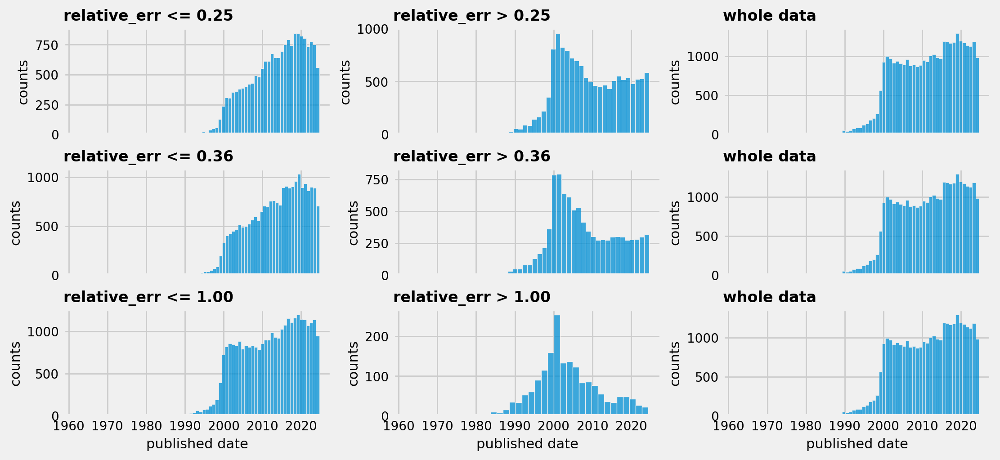

In [ ]:
temp20=defaultdict(list)

fig,ax = plt.subplots(len(ths_list2),3,figsize=(11,5),sharex='col')
for i,ths in enumerate(ths_list2):
  temp20[ths].append(pd.DataFrame(Pdate_test[abs_err/Y_truth <= ths]))
  temp20[ths].append(pd.DataFrame(Pdate_test[abs_err/Y_truth > ths]))
  temp20[ths].append(pd.DataFrame(Pdate_test[:]))
  for j in range(3):
    sns.histplot(data=temp20[ths][j],x='Pdate',ax=ax[i][j])
  ax[i][0].set_title(f'relative_err <= {ths:.2f}',fontsize=12,loc='left',fontweight='bold')
  ax[i][1].set_title(f'relative_err > {ths:.2f}',fontsize=12,loc='left',fontweight='bold')
  ax[i][2].set_title(f'whole data',fontsize=12,loc='left',fontweight='bold')
for ax_i in ax.flatten():
 ax_i.tick_params(axis="y", labelsize=10)
 ax_i.tick_params(axis="x", labelsize=10)
 ax_i.set_xlabel('published date',fontsize=11)
 ax_i.set_ylabel('counts',fontsize=11)


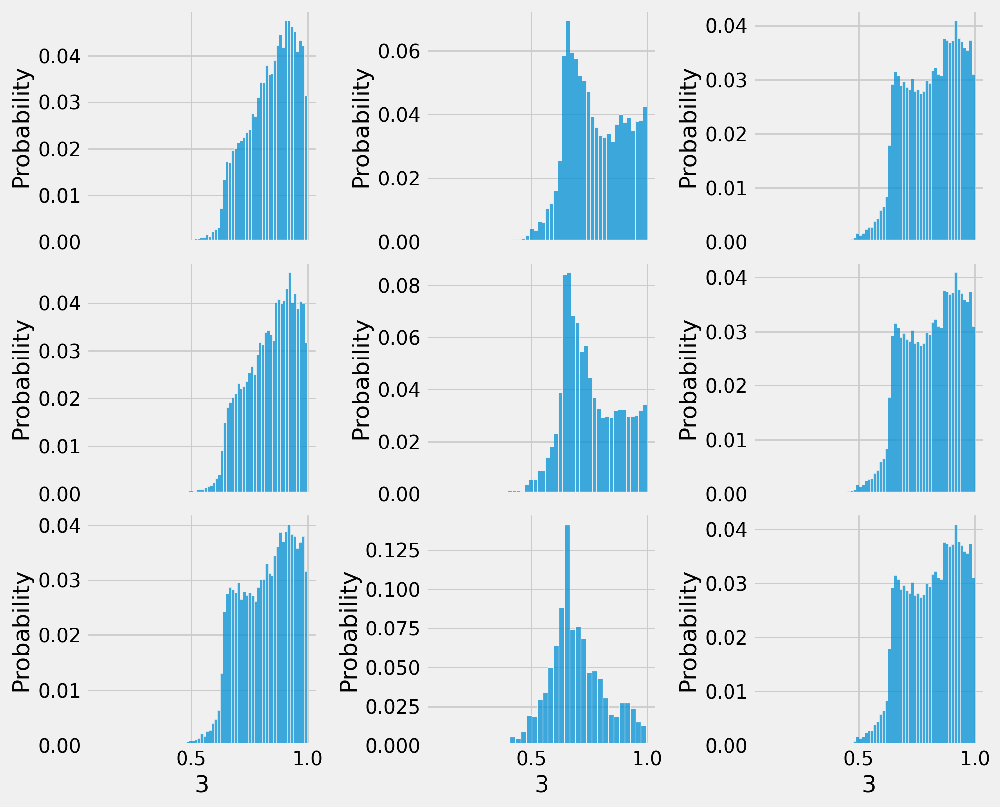

In [ ]:
fig,ax = plt.subplots(len(ths_list2),3,figsize=(10,8),sharex='col')
for i,ths in enumerate(ths_list2):
  for j in range(3):
    sns.histplot(data=temp2[ths][j],x=3,ax=ax[i][j],stat='probability')


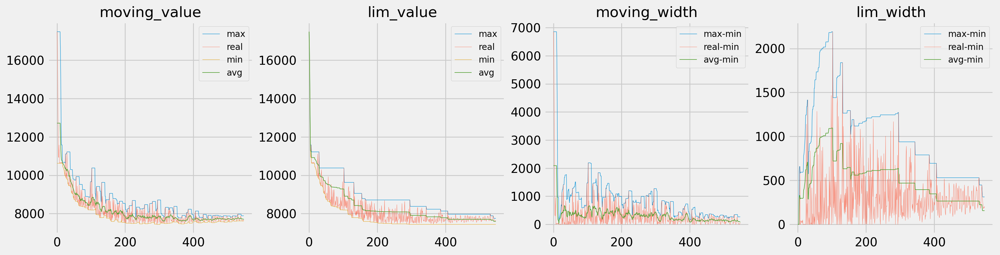

In [ ]:
x = valid_loss
plot_area(x,start=0,end=-1,log=False);
#plot_area(x,start=750,end=-1,log=False);

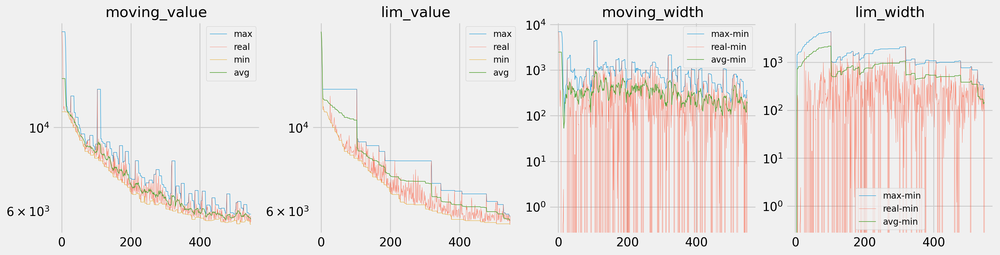

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

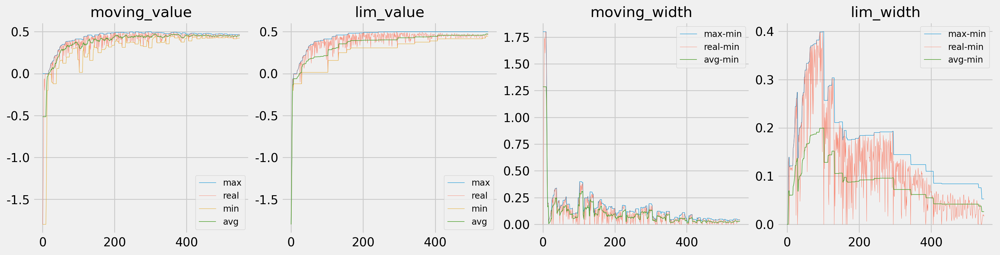

In [ ]:
x = valid_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 2

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-80-a271304ba049>", line 1, in <cell line: 0>
    model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
                                                      ^^^^^^^^^^^^^^^
NameError: name 'box_expt_config' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
          ^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/ultratb.py", line 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-80-e926ca88d701>", line 1, in <cell line: 0>
    model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
                                                      ^^^^^^^^^^^^^^^
NameError: name 'box_expt_config' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
          ^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/ultratb.py", line 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (353/450) * (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-80-7b72658d115d>", line 1, in <cell line: 0>
    model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
                                                      ^^^^^^^^^^^^^^^
NameError: name 'box_expt_config' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
          ^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/ultratb.py", line 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (best_epoch/450)* (353/450) * (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-80-fc7d72fa7778>", line 1, in <cell line: 0>
    model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
                                                      ^^^^^^^^^^^^^^^
NameError: name 'box_expt_config' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
          ^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/ultratb.py", line 

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-80-bdbfd3dfd8cc>", line 6, in <cell line: 0>
    loss_valid = np.array(val_loss)
                          ^^^^^^^^
NameError: name 'val_loss' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
          ^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/ultratb.py", line 1101, in get_records
    return _fixed_getinnerframes(etb, number_of_lines_of_c

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-80-a000df0fdf5f>", line 1, in <cell line: 0>
    best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
                                                          ^^^^^^^^^
NameError: name 'file_name' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 2099, in showtraceback
    stb = value._render_traceback_()
          ^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/ultratb.py", line 1101, in get_records
    return _fixed_getin

6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


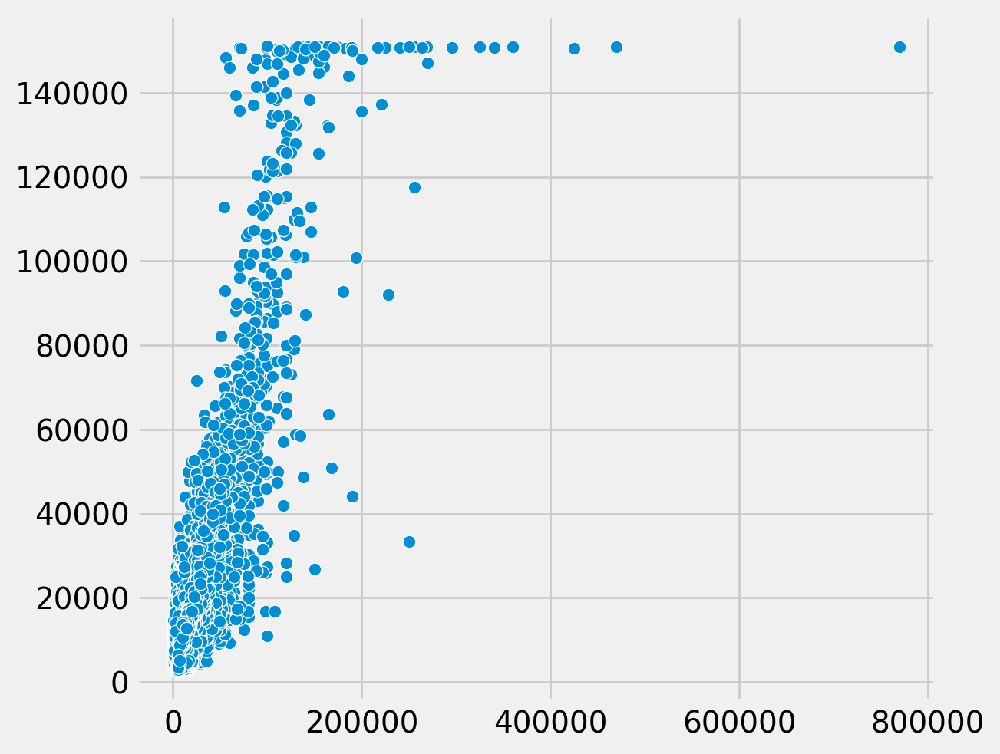

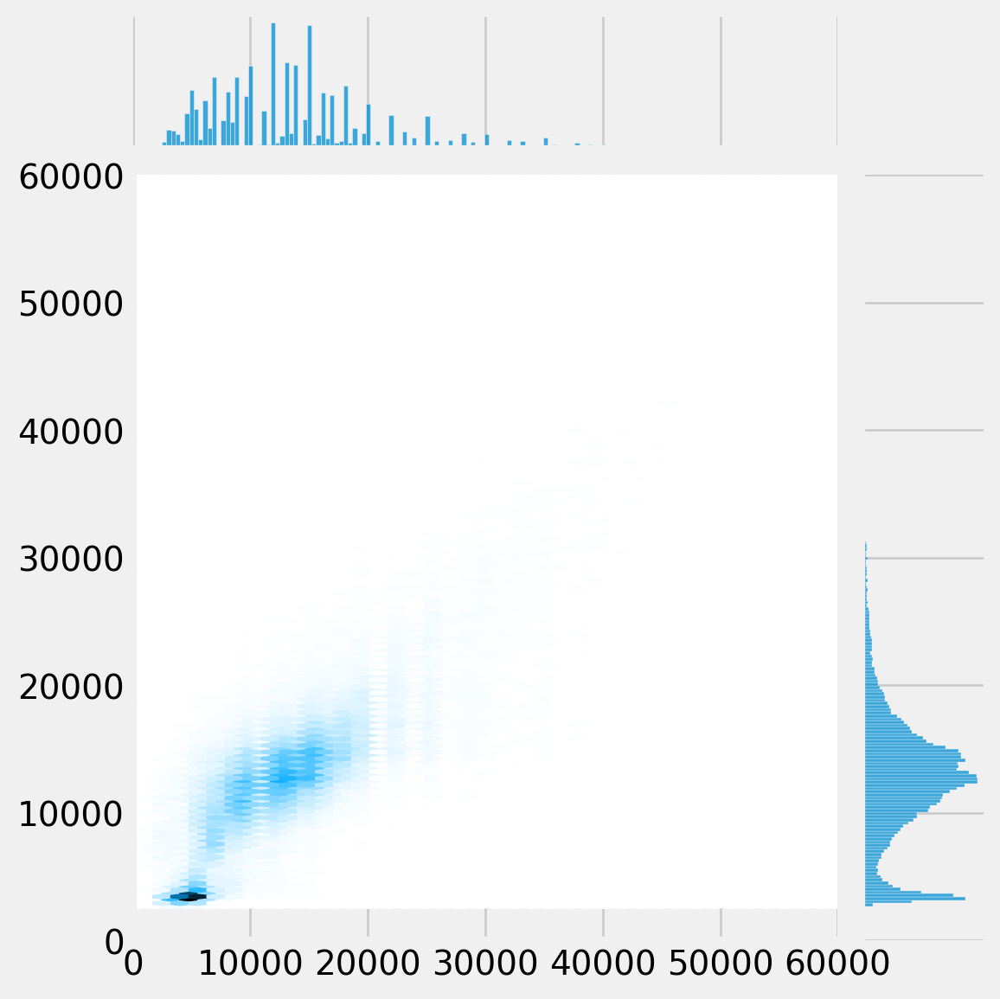

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


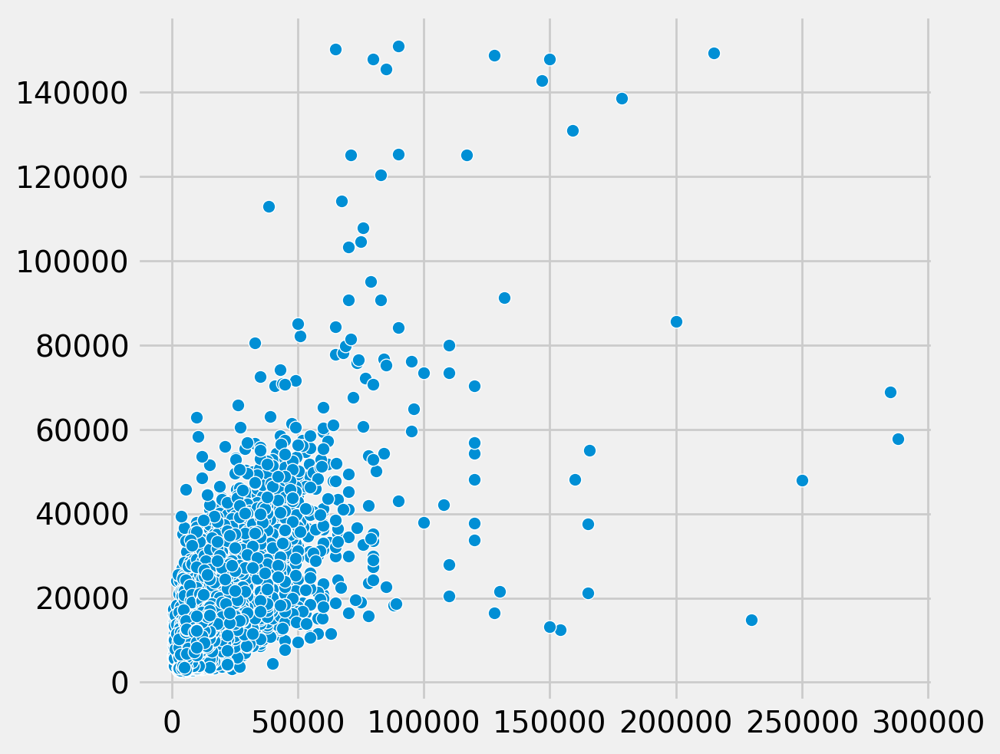

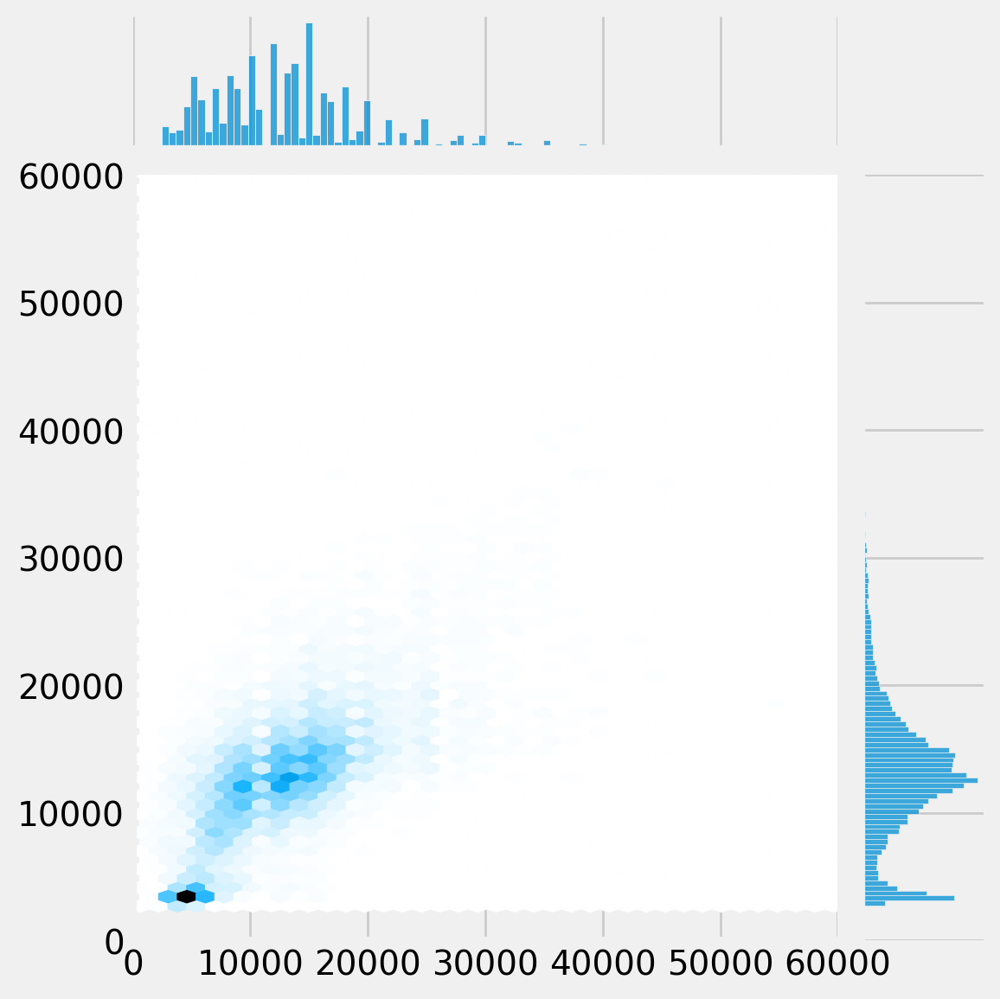

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


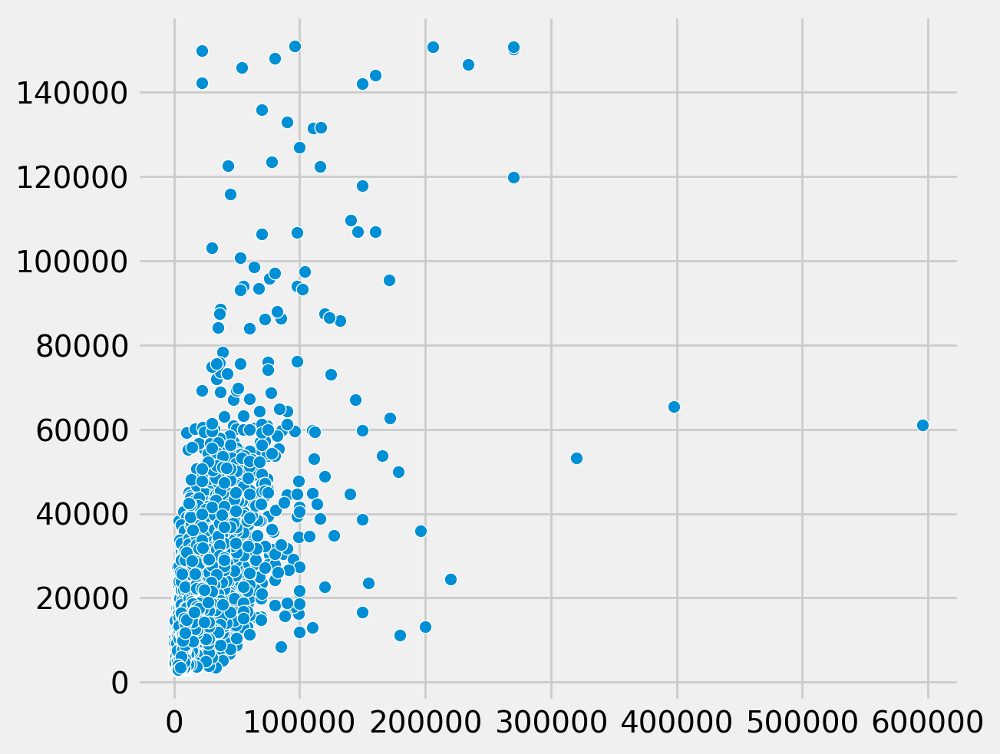

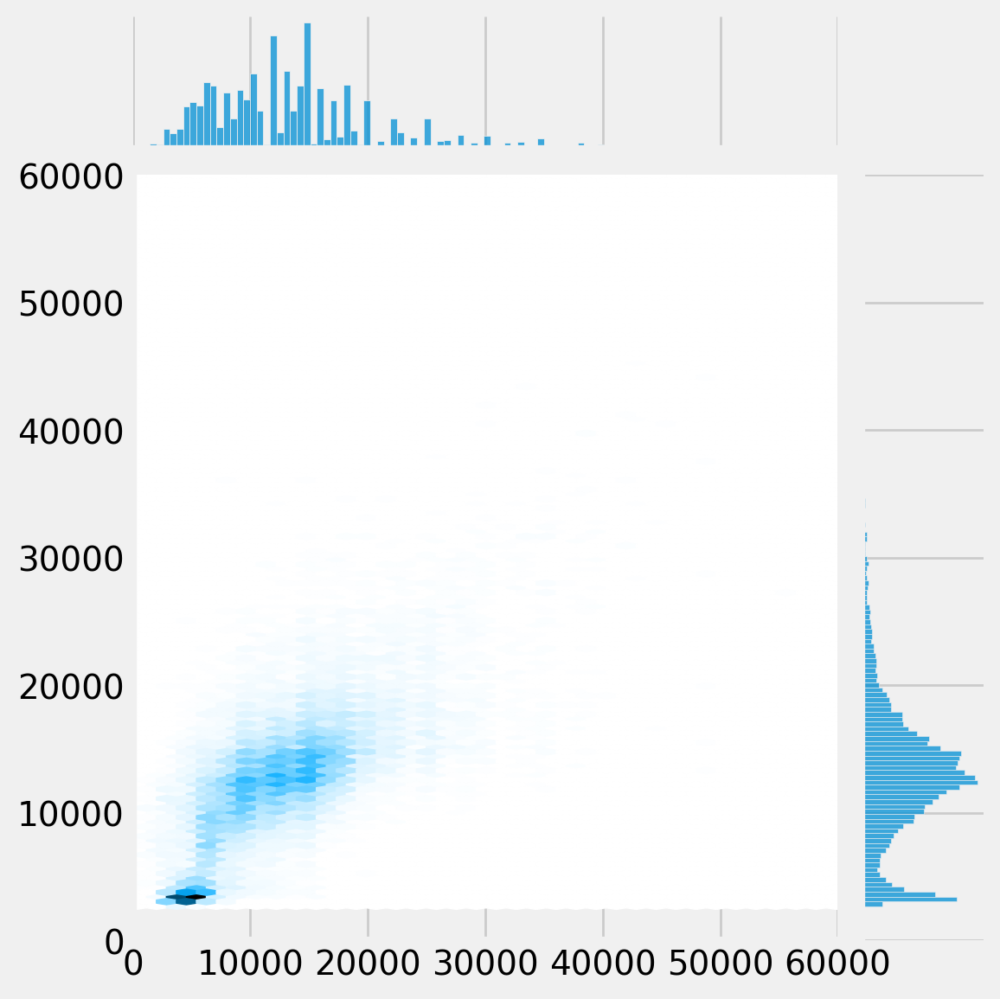

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


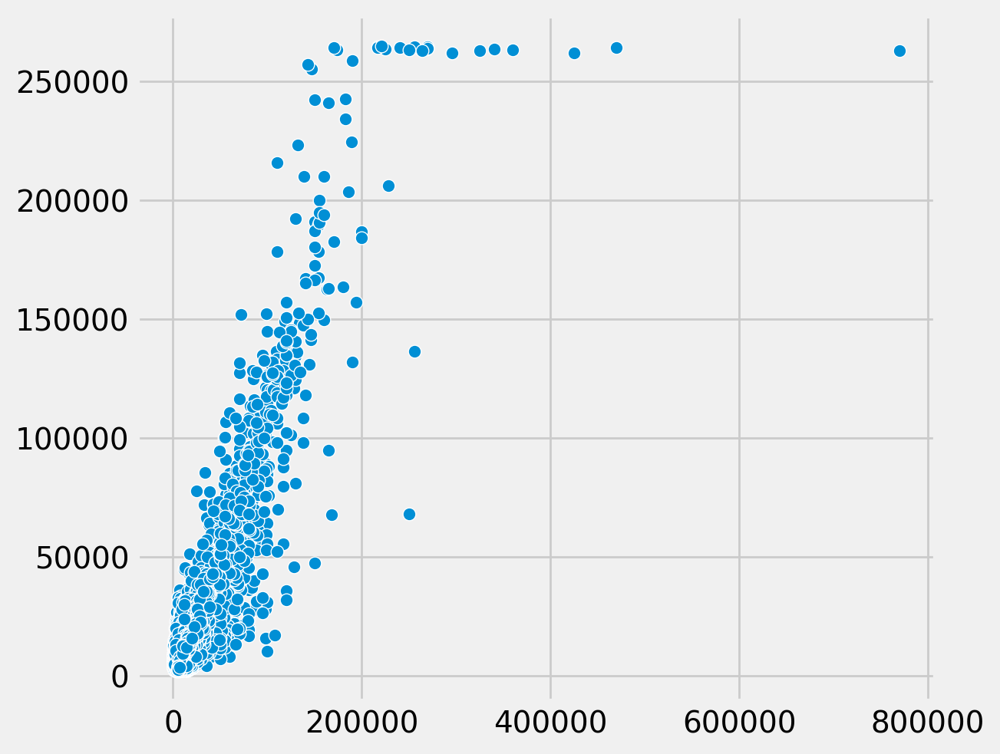

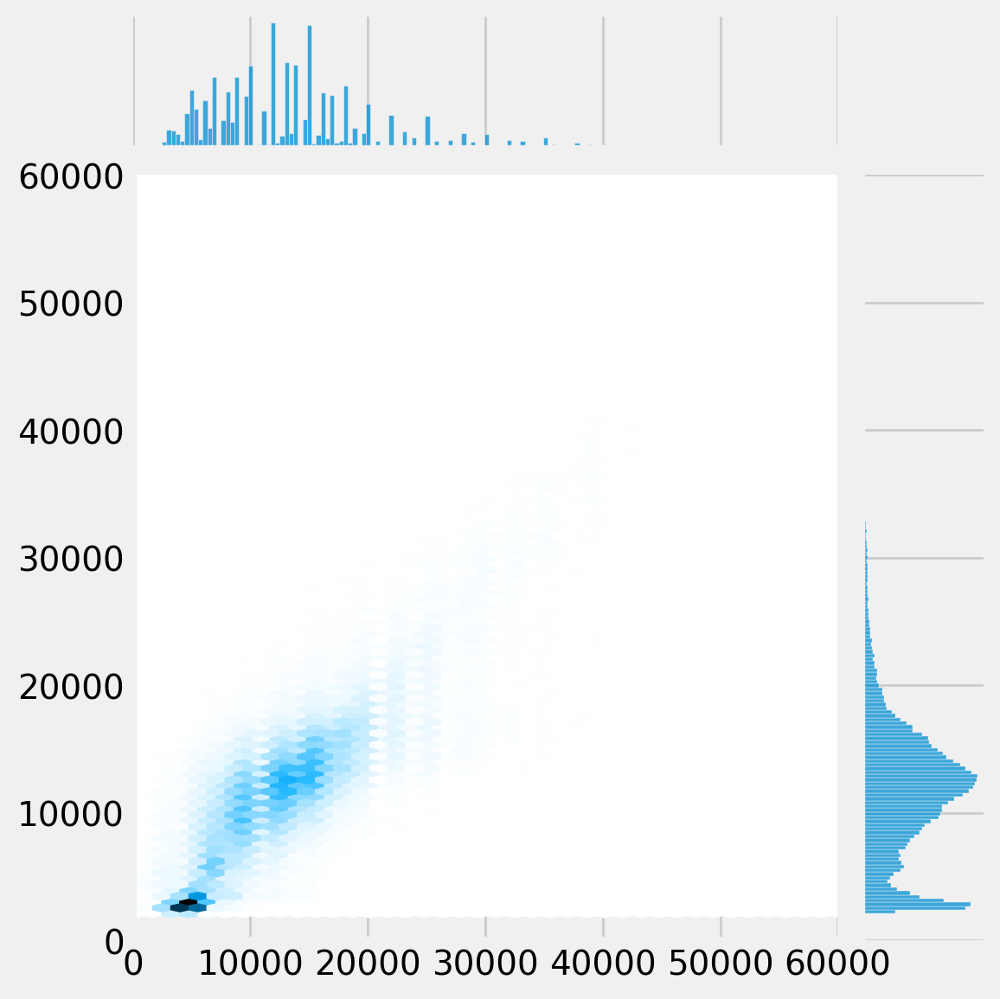

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


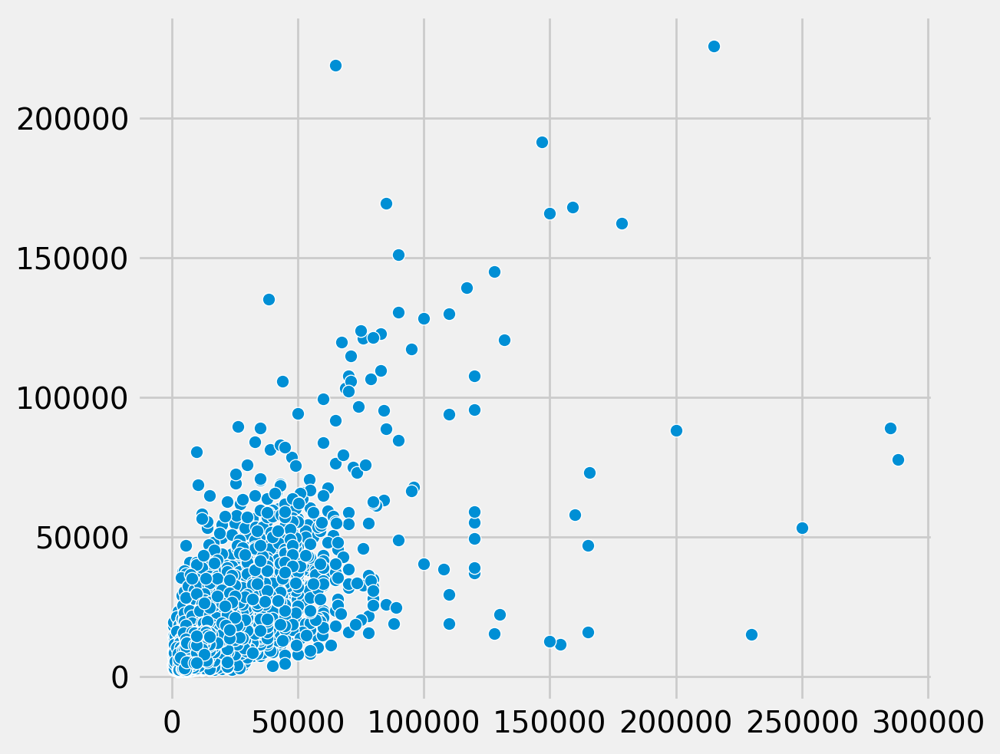

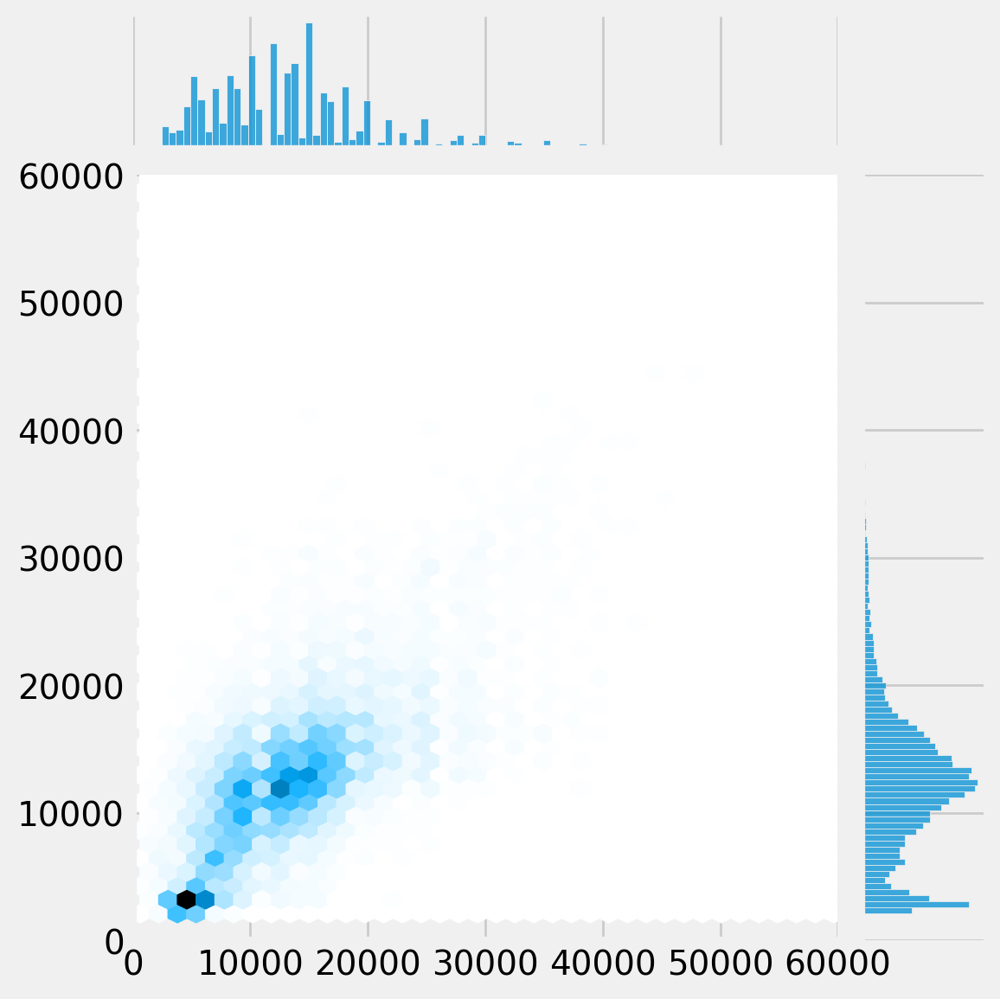

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


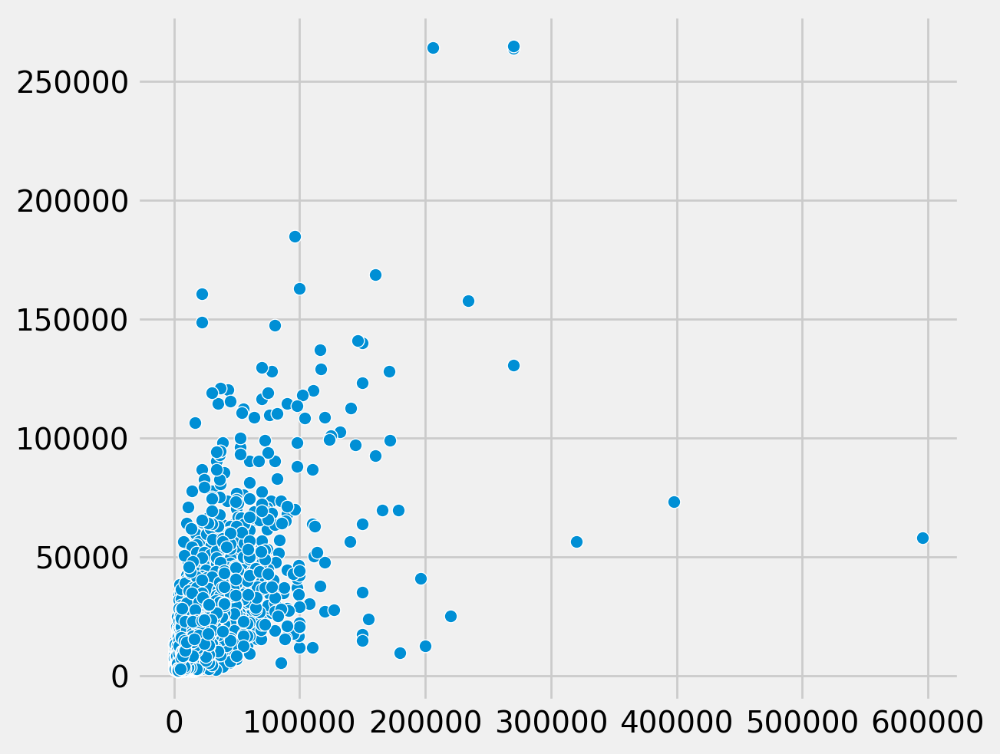

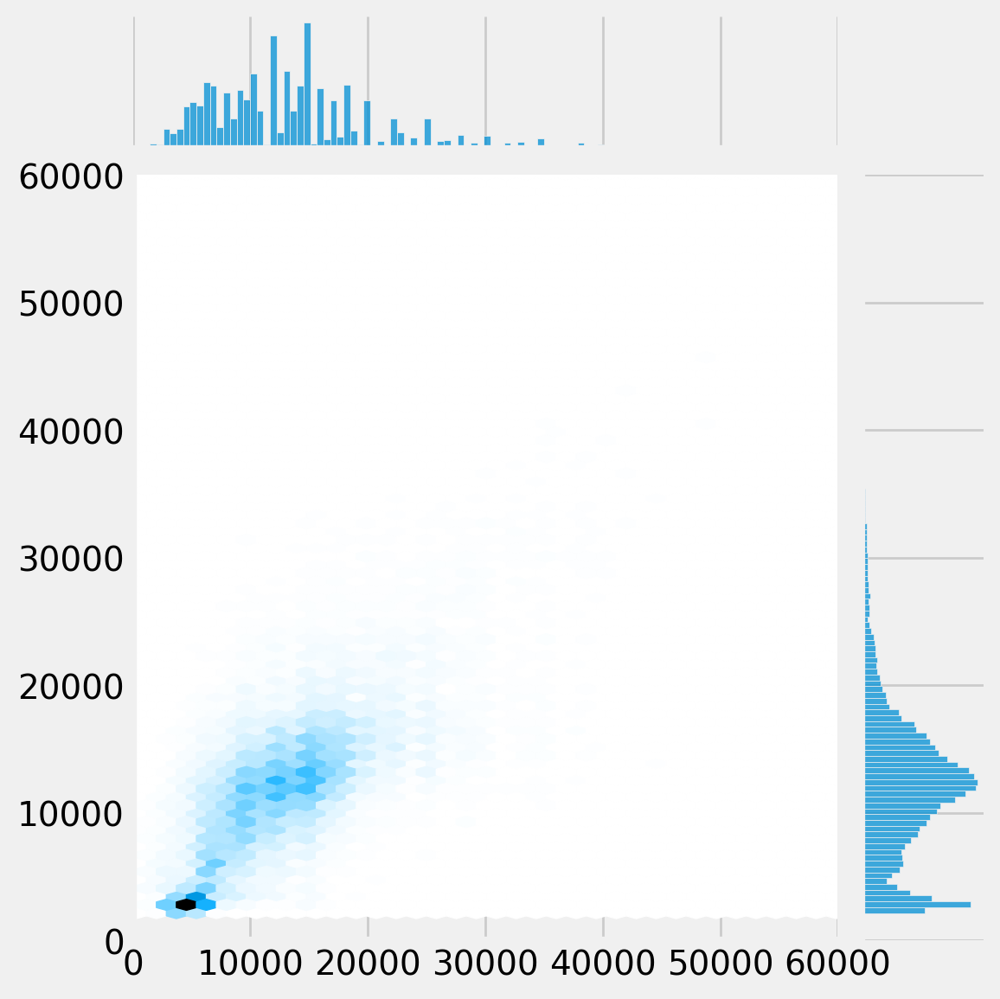

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

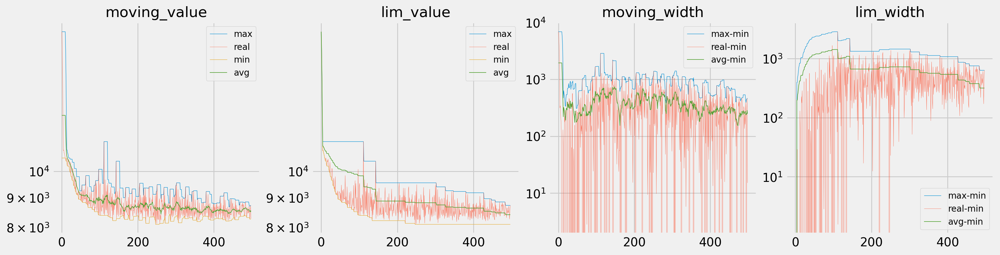

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

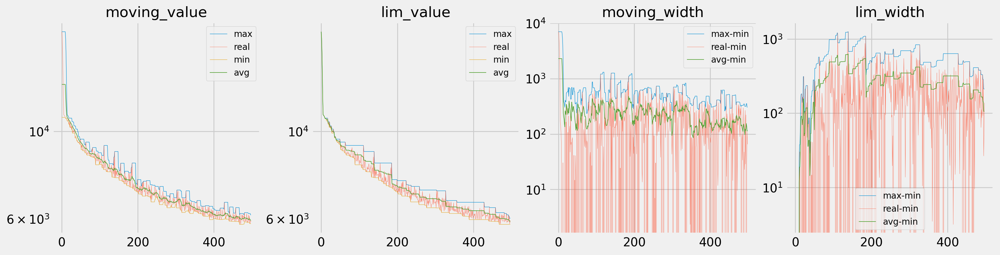

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

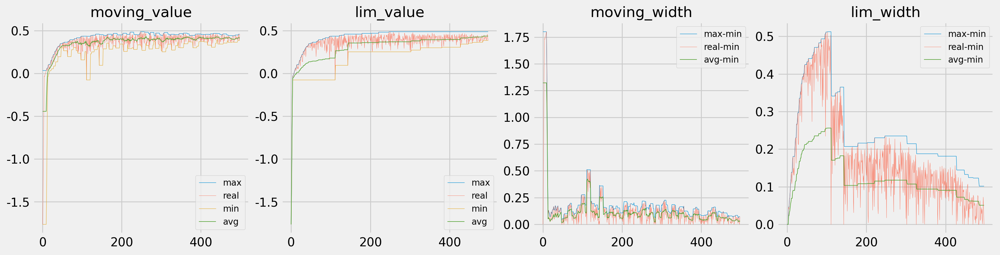

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 3

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16037.955	Train Score: -2.854	Val Loss: 15939.502	Val Score: -2.846
Epoch:     2		lr: 0.00008425
	Train Loss: 15855.209	Train Score: -2.769	Val Loss: 15645.640	Val Score: -2.706
Epoch:     3		lr: 0.00008425
	Train Loss: 15499.601	Train Score: -2.604	Val Loss: 15158.708	Val Score: -2.480


KeyboardInterrupt: 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16037.185	Train Score: -2.854	Val Loss: 15937.355	Val Score: -2.845
Epoch:     2		lr: 0.00008425
	Train Loss: 15850.333	Train Score: -2.767	Val Loss: 15635.160	Val Score: -2.701
Epoch:     3		lr: 0.00008425
	Train Loss: 15486.098	Train Score: -2.598	Val Loss: 15141.165	Val Score: -2.472
Epoch:     4		lr: 0.00008425
	Train Loss: 14948.232	Train Score: -2.355	Val Loss: 14475.010	Val Score: -2.174
Epoch:     5		lr: 0.00008425
	Train Loss: 14256.850	Train Score: -2.054	Val Loss: 13665.026	Val Score: -1.831
Epoch:     6		lr: 0.00008425
	Train Loss: 13432.604	Train Score: -1.713	Val Loss: 12723.813	Val Score: -1.456
Epoch:     7		lr: 0.00008425
	Train Loss: 12491.106	Train Score: -1.348	Val Loss: 11687.452	Val Score: -1.075
Epoch:     8		lr: 0.00008425
	Train Loss: 11461.972	Train Score: -0.979	Val Loss: 10597.133	Val Score: -0.709
Epoch:     9		lr: 0.00008425
	Train Loss: 10397.351	Train Score: -0.629	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (395/450) * (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16038.438	Train Score: -2.854	Val Loss: 15938.736	Val Score: -2.845
Epoch:     2		lr: 0.00008425
	Train Loss: 15853.203	Train Score: -2.768	Val Loss: 15635.549	Val Score: -2.701
Epoch:     3		lr: 0.00008425
	Train Loss: 15486.341	Train Score: -2.598	Val Loss: 15128.526	Val Score: -2.466
Epoch:     4		lr: 0.00008425
	Train Loss: 14933.152	Train Score: -2.348	Val Loss: 14439.569	Val Score: -2.159
Epoch:     5		lr: 0.00008425
	Train Loss: 14215.678	Train Score: -2.036	Val Loss: 13595.926	Val Score: -1.802
Epoch:     6		lr: 0.00008425
	Train Loss: 13355.918	Train Score: -1.682	Val Loss: 12620.300	Val Score: -1.417
Epoch:     7		lr: 0.00008425
	Train Loss: 12376.783	Train Score: -1.306	Val Loss: 11546.471	Val Score: -1.026
Epoch:     8		lr: 0.00008425
	Train Loss: 11313.046	Train Score: -0.928	Val Loss: 10424.905	Val Score: -0.654
Epoch:     9		lr: 0.00008425
	Train Loss: 10224.113	Train Score: -0.576	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (best_epoch/450) * (395/450) * (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16038.071	Train Score: -2.854	Val Loss: 15940.042	Val Score: -2.846
Epoch:     2		lr: 0.00008425
	Train Loss: 15853.134	Train Score: -2.768	Val Loss: 15645.513	Val Score: -2.706
Epoch:     3		lr: 0.00008425
	Train Loss: 15494.115	Train Score: -2.601	Val Loss: 15162.412	Val Score: -2.481
Epoch:     4		lr: 0.00008425
	Train Loss: 14961.391	Train Score: -2.360	Val Loss: 14503.952	Val Score: -2.187
Epoch:     5		lr: 0.00008425
	Train Loss: 14272.222	Train Score: -2.060	Val Loss: 13689.024	Val Score: -1.841
Epoch:     6		lr: 0.00008425
	Train Loss: 13439.944	Train Score: -1.716	Val Loss: 12739.658	Val Score: -1.462
Epoch:     7		lr: 0.00008425
	Train Loss: 12484.377	Train Score: -1.346	Val Loss: 11683.606	Val Score: -1.074
Epoch:     8		lr: 0.00008425
	Train Loss: 11435.822	Train Score: -0.970	Val Loss: 10569.112	Val Score: -0.700
Epoch:     9		lr: 0.00008425
	Train Loss: 10350.427	Train Score: -0.615	Va

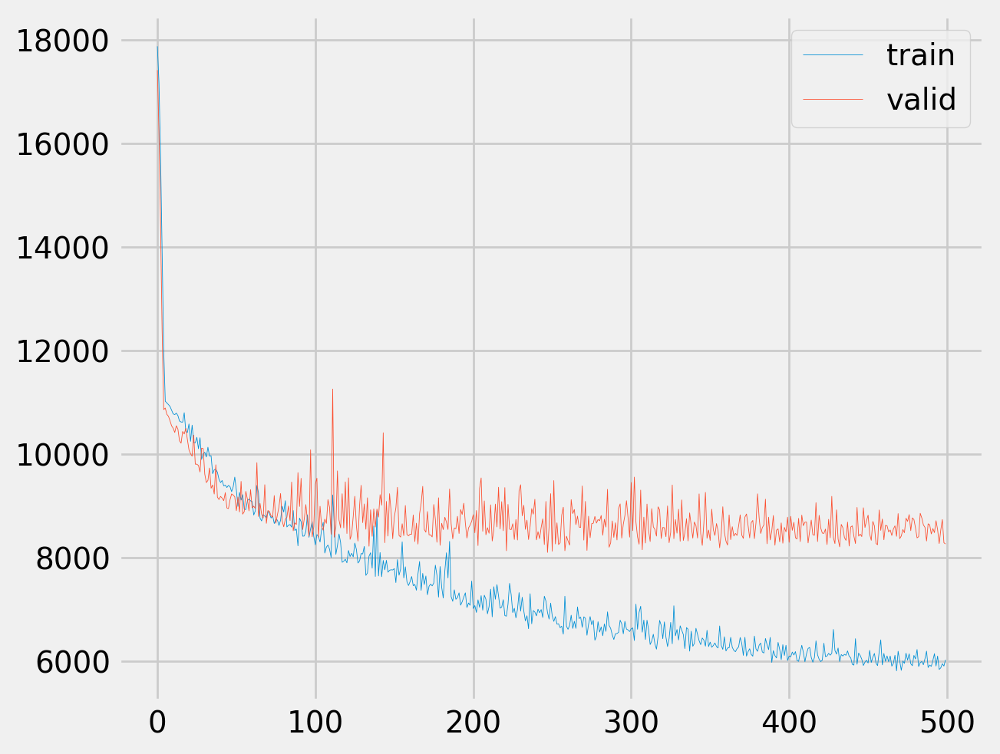

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

#### TEST

In [ ]:
total_model_path = os.path.join(RSLT_DIR,'model/model4.5_8192_500_N6_lr0.000082','best_model_241115.pt')

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
total_model = torch.load(total_model_path)
criterion = train_config[-2]

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:175: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
<ipython-input-44-ff201c90abf1>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to b

4160.324987305679 	r2 :  -0.486175537109375 	mape :  0.24889141


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


4160.324987305679 	r2 :  -0.486175537109375 	mape :  0.24889141


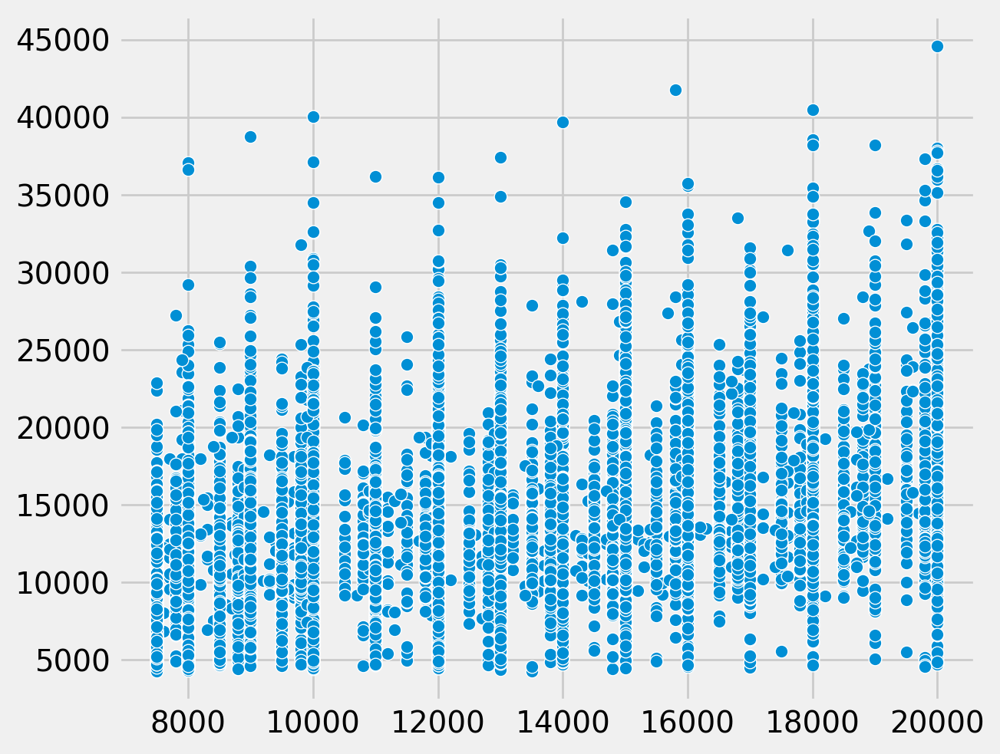

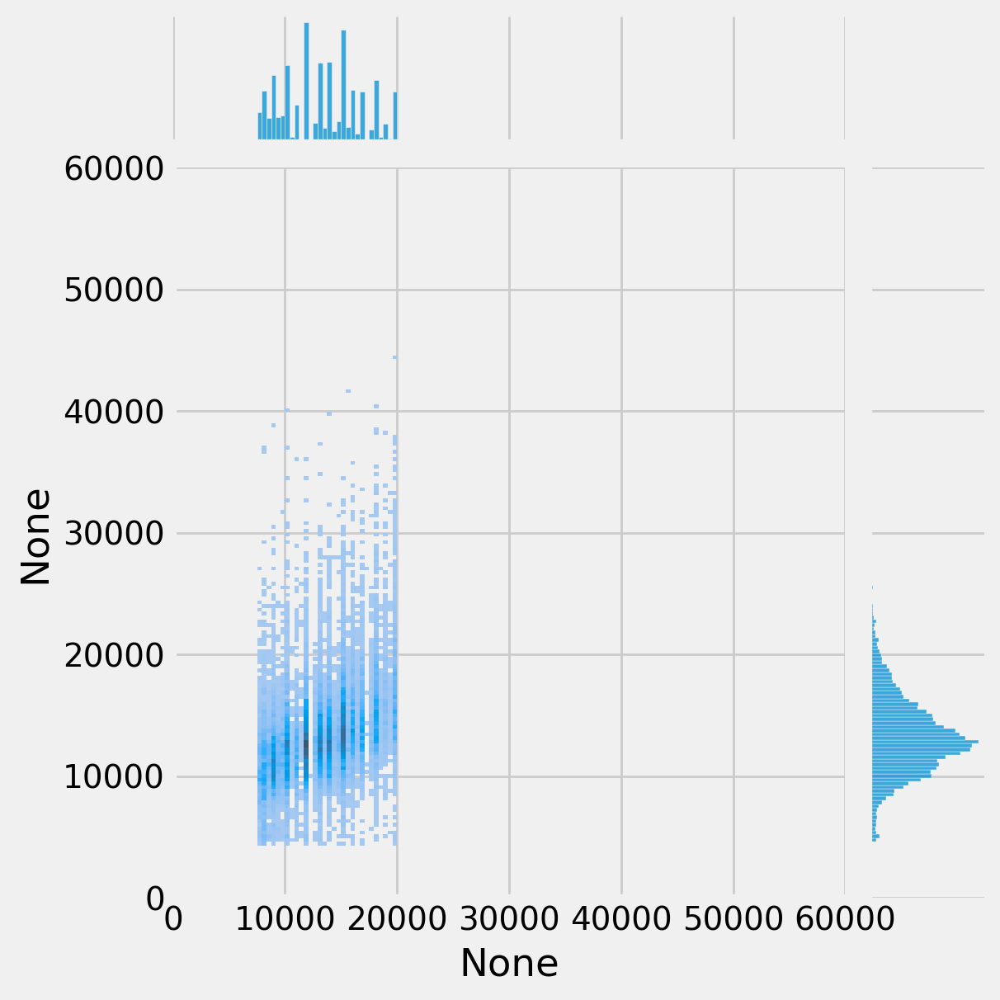

In [ ]:
test_n_plot(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict_box[7]['tst'],criterion,device,scatter=False) #gridsize 500

In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_best = val1-val2
#sns.histplot(val_best)
#sns.jointplot(x=y_true,y=val_best,kind='hist',bins=300,ylim=(0,15),cbar=True)
np.mean(1-val_best)

-0.4861754

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_total = val1-val2
#sns.histplot(val_total)
#sns.jointplot(x=y_true,y=val_total,kind='hist',bins=300,ylim=(0,15),cbar=True)
np.mean(1-val_total)

-0.4380049

<Axes: xlabel='val', ylabel='Count'>

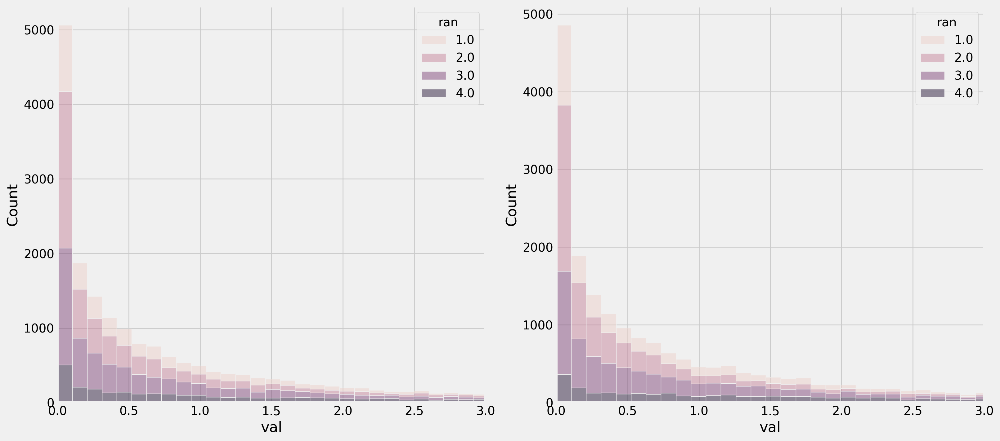

In [ ]:
ran = (y_true-3000)//3500
fig,ax=plt.subplots(1,2,figsize=(16,7))
ax[0].set_xlim(0,3)
ax[1].set_xlim(0,3)
data1 = {'val':val_best,'ran':ran}
data2 = {'val':val_total,'ran':ran}
sns.histplot(data=data1,x='val',hue='ran',alpha=0.5,ax=ax[0],multiple='stack')
sns.histplot(data=data2,x='val',hue='ran',alpha=0.5,ax=ax[1],multiple='stack')

In [ ]:
print(np.min(val_best),np.max(val_best))
print(np.min(val_total),np.max(val_total))

-2.3841858e-07 77.42485
-9.536743e-07 81.29799


In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_best = val1-val2
#sns.histplot(val_best)
#sns.jointplot(x=y_true,y=val_best,kind='hist',bins=300,ylim=(0,15),cbar=True)
y_true1 = y_true
np.mean(1-val_best)

0.49826893

In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_part= val1-val2
#sns.histplot(val_total)
#sns.jointplot(x=y_true,y=val_total,kind='hist',bins=300,ylim=(0,15),cbar=True)
y_true2 = y_true
np.mean(1-val_part)

-0.4861754

<Axes: xlabel='val', ylabel='Count'>

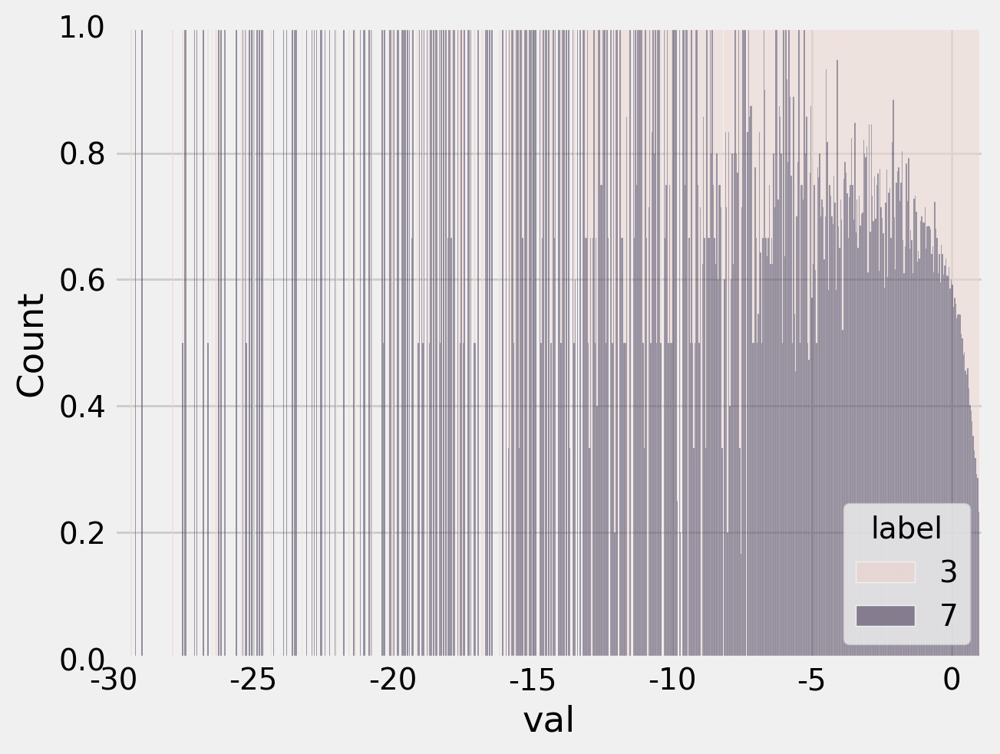

In [ ]:
ran1 = (y_true1-3000)//3500
ran2 = (y_true2-3000)//3500
fig,ax=plt.subplots()#(1,2,figsize=(16,7))
ax.set_xlim(-30,1.2)
data1 = pd.DataFrame({'val':1-val_best,'ran':ran1,'label':3})
data2 = pd.DataFrame({'val':1-val_part,'ran':ran2,'label':7})
data = pd.concat([data1,data2])
sns.histplot(data=data,x='val',hue='label',alpha=0.5,ax=ax,multiple='fill')

In [ ]:
display(data1.describe())
display(data2.describe())

,val,ran,label
count,30104.000000,30104.000000,30104.0
mean,0.498269,2.757740,3.0
std,1.484012,2.335231,0.0
min,-36.211140,0.000000,3.0
25%,0.612786,1.000000,3.0
50%,0.894864,2.000000,3.0
75%,0.981797,4.000000,3.0
max,1.000000,17.000000,3.0


,val,ran,label
count,20601.000000,20601.00000,20601.0
mean,-0.486175,2.44425,7.0
std,3.283754,1.00403,0.0
min,-76.424850,1.00000,7.0
25%,-0.536052,2.00000,7.0
50%,0.499799,2.00000,7.0
75%,0.891211,3.00000,7.0
max,1.000000,4.00000,7.0


In [ ]:
print(np.min(val_best),np.max(val_best))
print(np.min(val_total),np.max(val_total))

-2.3841858e-07 77.42485
-9.536743e-07 81.29799


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


-1.0

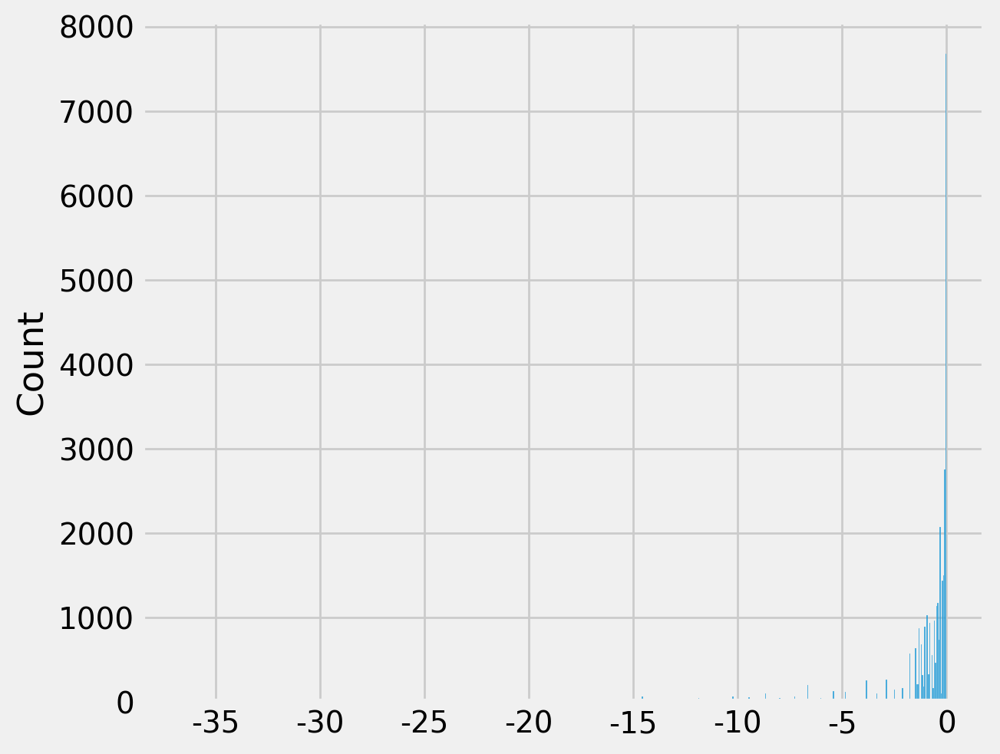

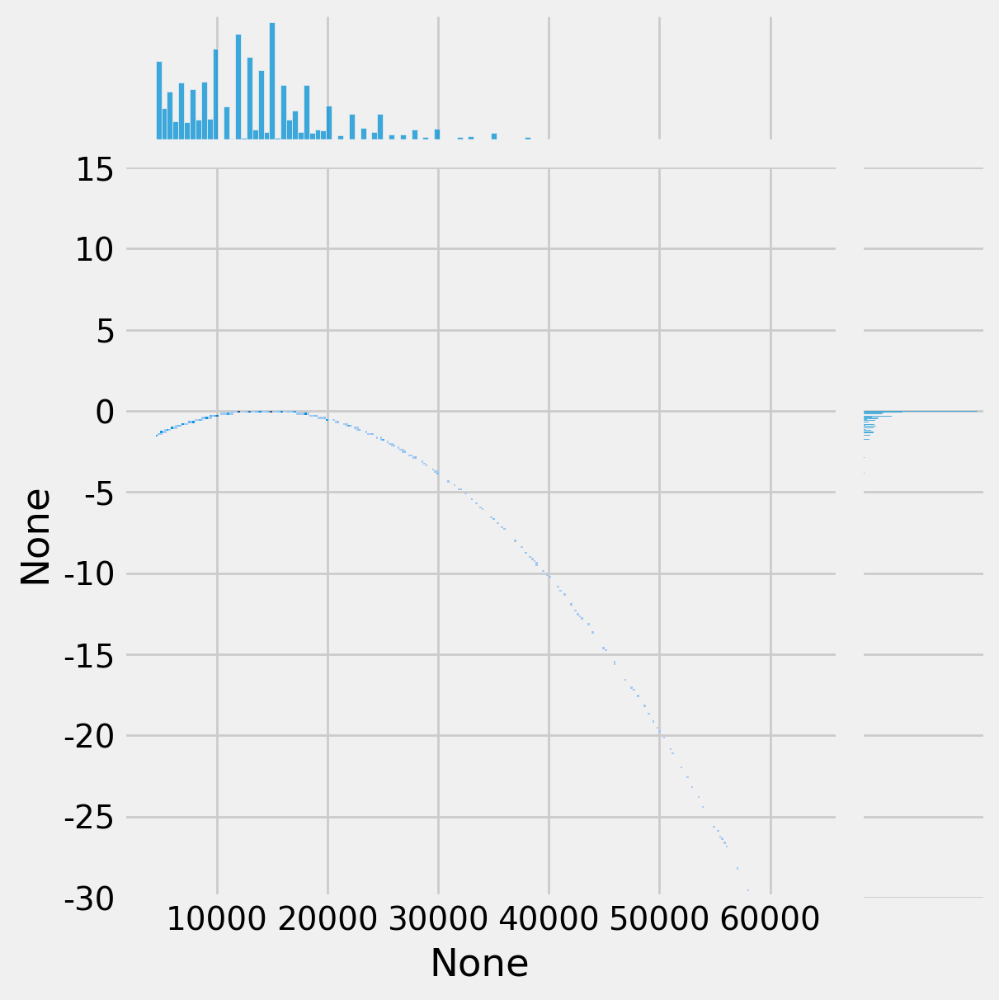

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
sns.histplot(val)
sns.jointplot(x=y_true,y=val,kind='hist',ylim=(-30,15),bins=300)
np.mean(val)

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


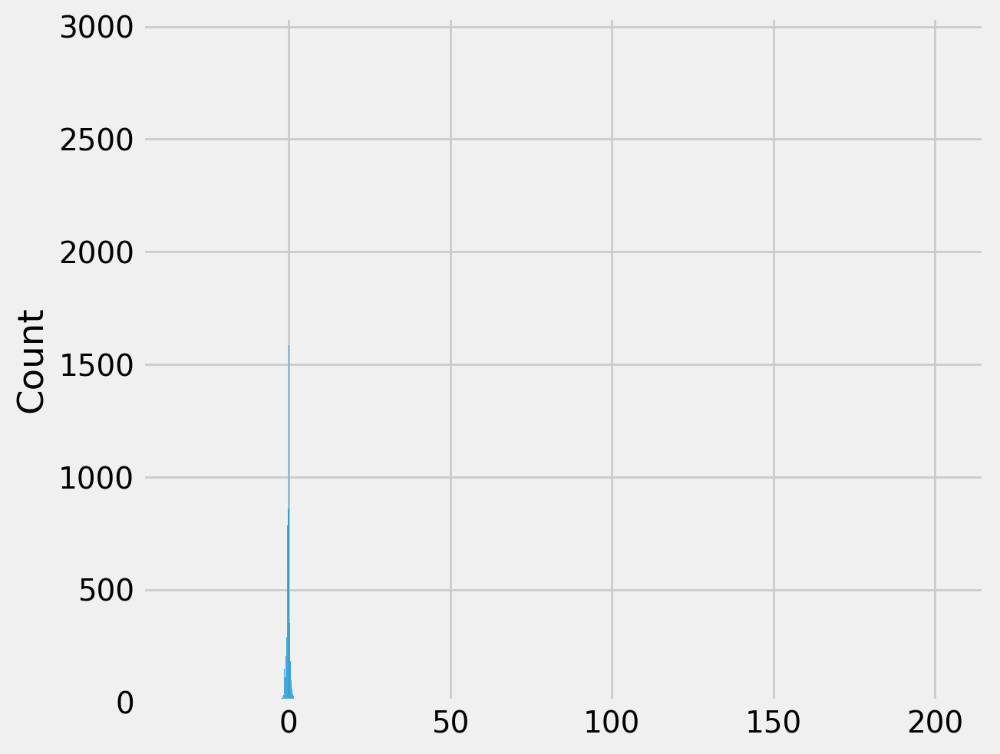

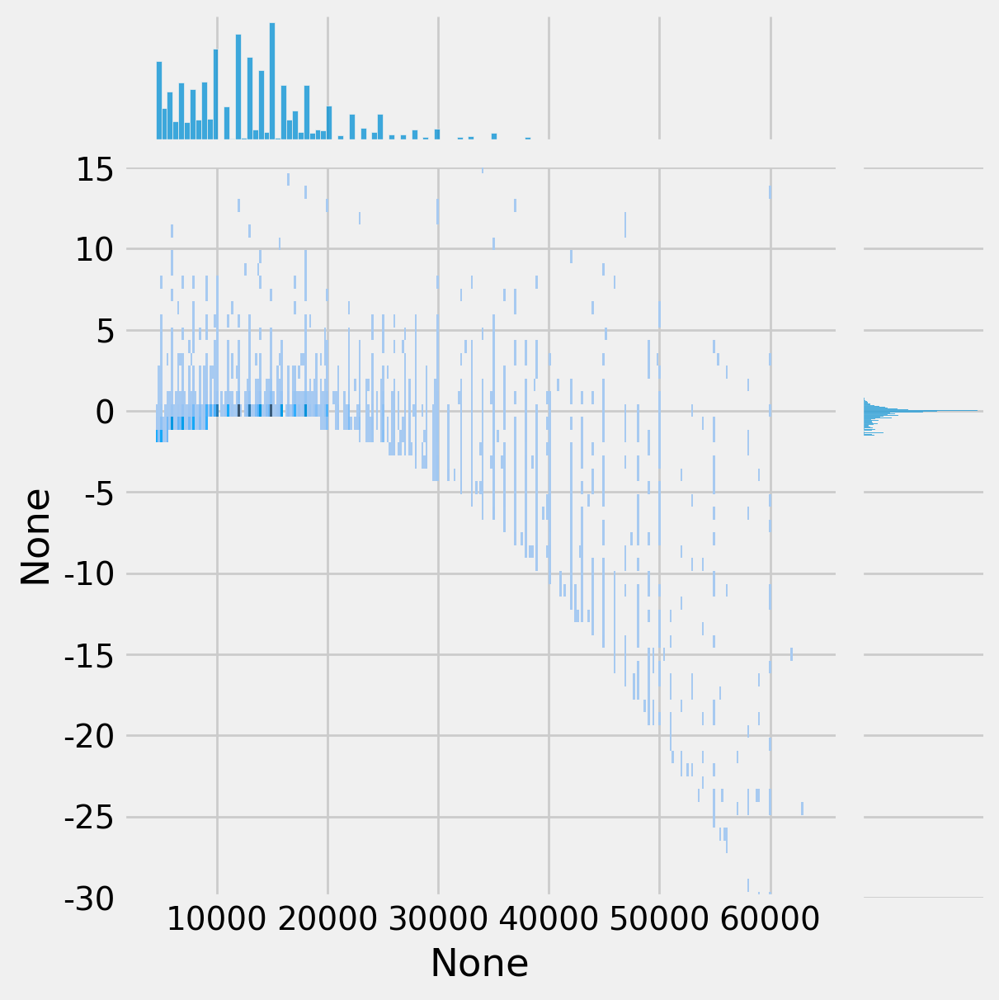

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
sns.histplot(val)
sns.jointplot(x=y_true,y=val,kind='hist',ylim=(-30,15),bins=300)

In [ ]:
np.mean(val)

-0.42722005

In [ ]:
r2_score(y_true,y_pred)

0.42722010612487793

In [ ]:
i = np.argmin(val)
y_pred[i],y_true[i],np.mean(y_true)

(44096.94, 62000.0, 14291.837)

In [ ]:
fig,ax=plt.subplots()
ax.set_xlim(0,10)
sns.histplot(val,ax=ax)
#sns.jointplot(x=y_true,y=val,kind='hist',ylim=(0,5))

In [ ]:
np.sum((y_pred-np.mean(y_true))**2)/np.sum((y_true-np.mean(y_true))**2)
1-np.sum((y_pred-y_true)**2)/np.sum((y_true-np.mean(y_true))**2)

0.49826890230178833

7829.522335366315 	r2 :  0.42619526386260986 	mape :  0.34356847


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7829.522335366315 	r2 :  0.42619526386260986 	mape :  0.34356847


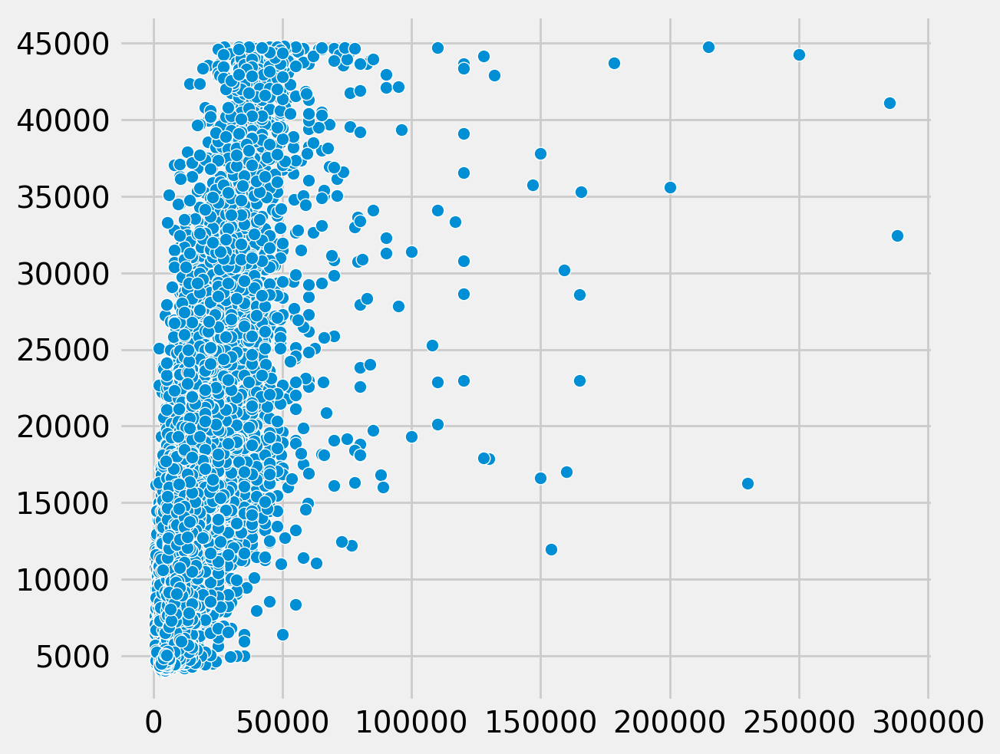

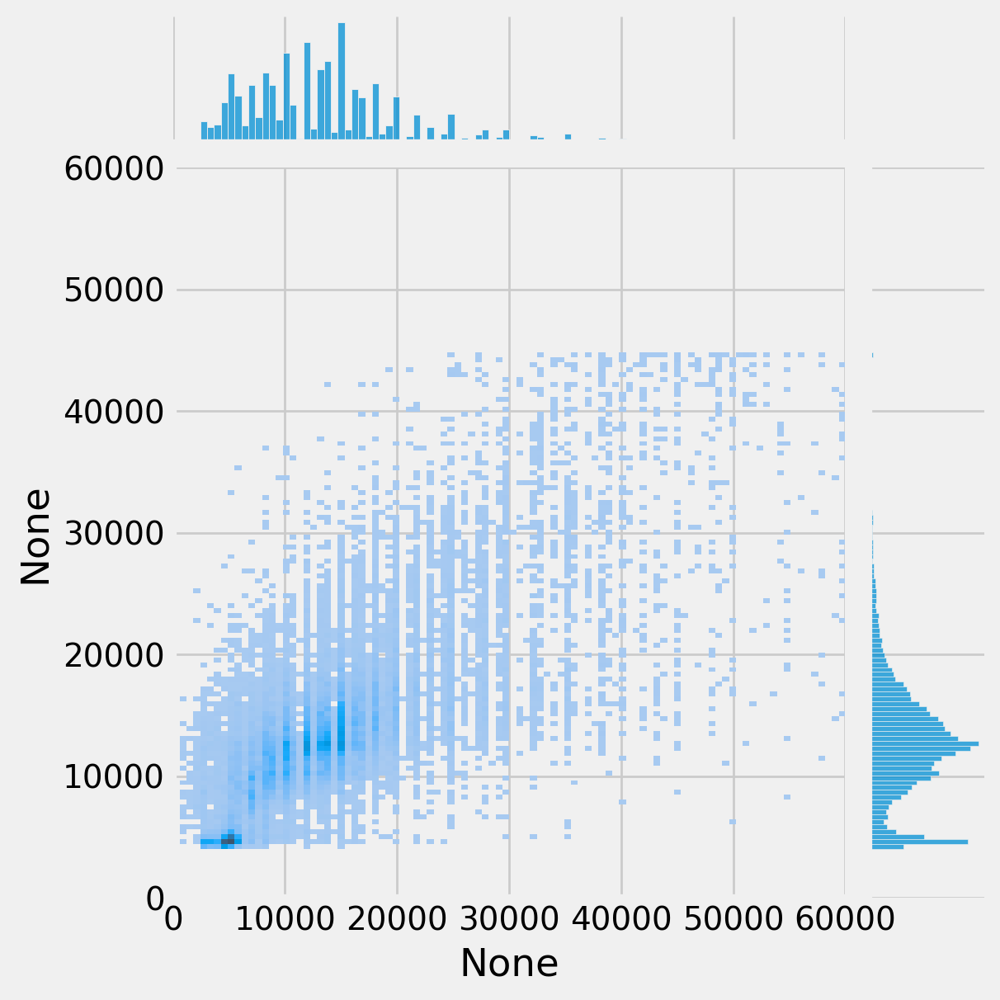

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False) #gridsize 180

9043.04373538025 	r2 :  0.381686270236969 	mape :  0.34596652


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


9043.04373538025 	r2 :  0.381686270236969 	mape :  0.34596652


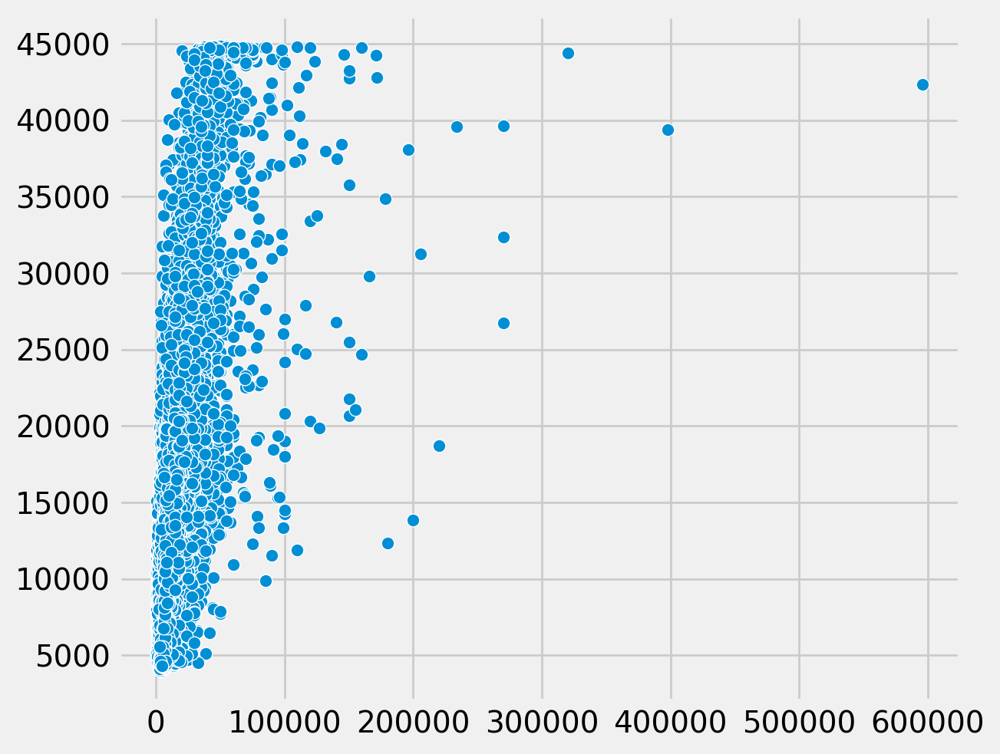

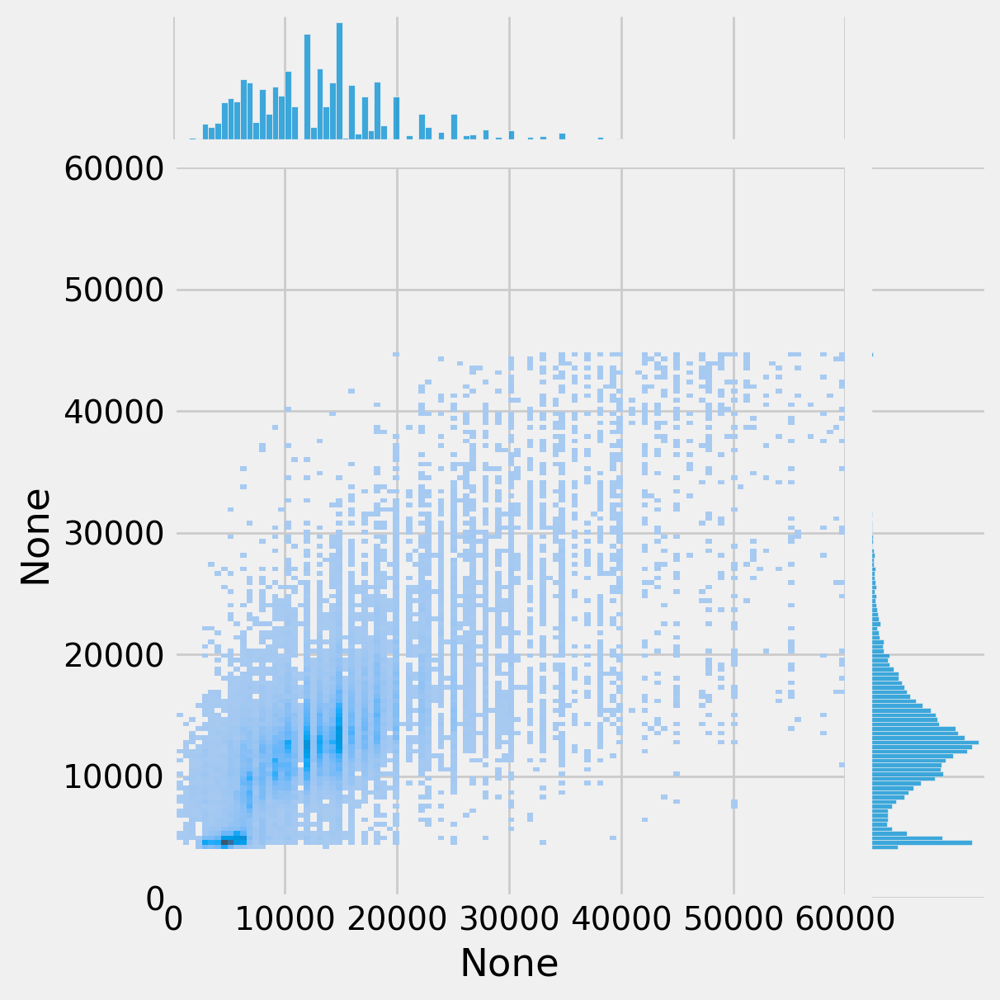

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False) #gridsize 350

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


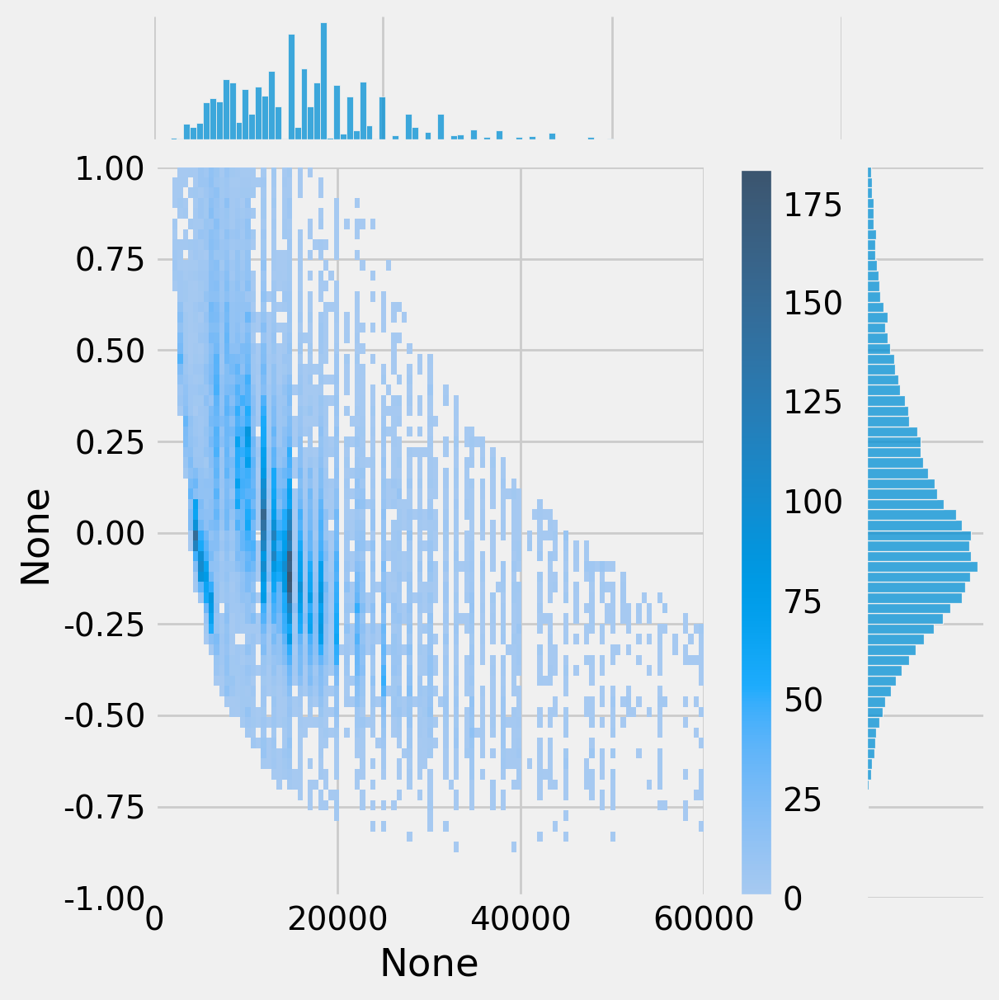

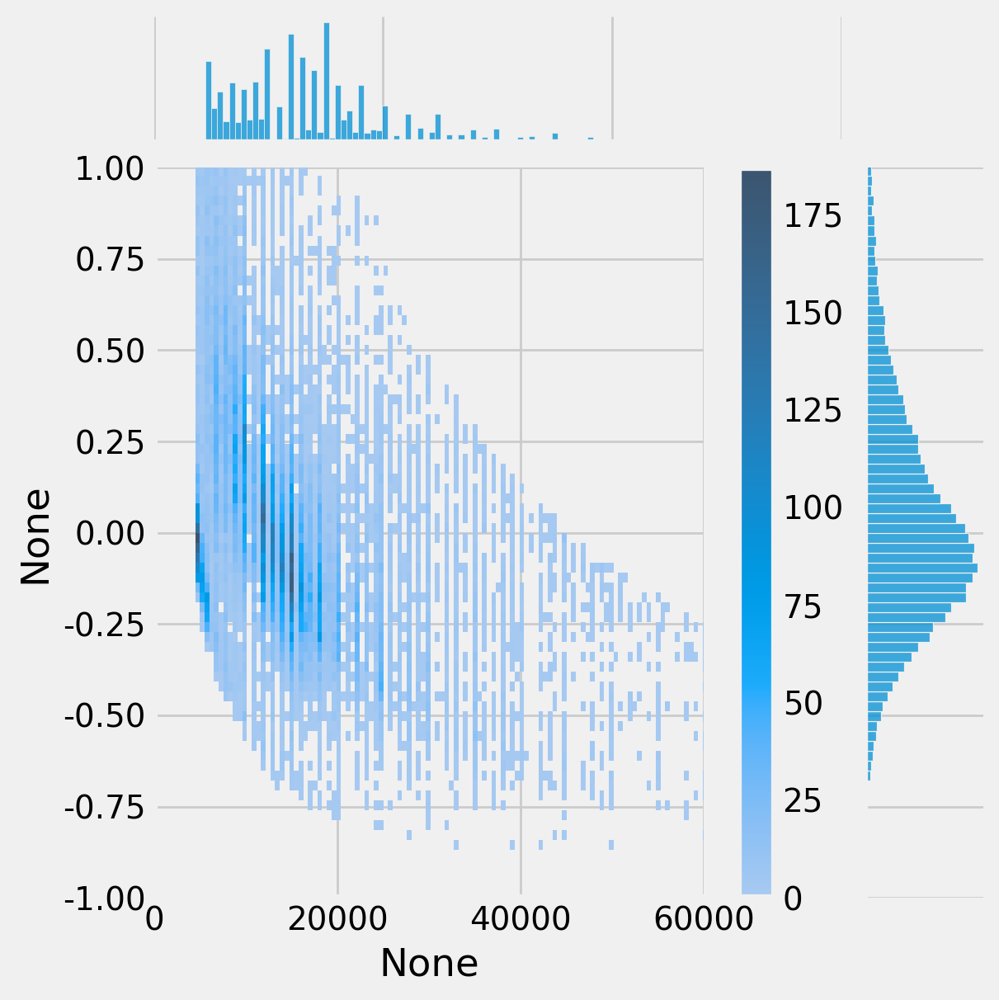

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=True,ylim=(-1,1),xlim=(0,60000),cbar=True) #gridsize 180
test_plot_err_dist(best_model,iter_dict_box[3]['tst'],criterion,device,percent=True,ylim=(-1,1),xlim=(0,60000),cbar=True) #gridsize 180

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


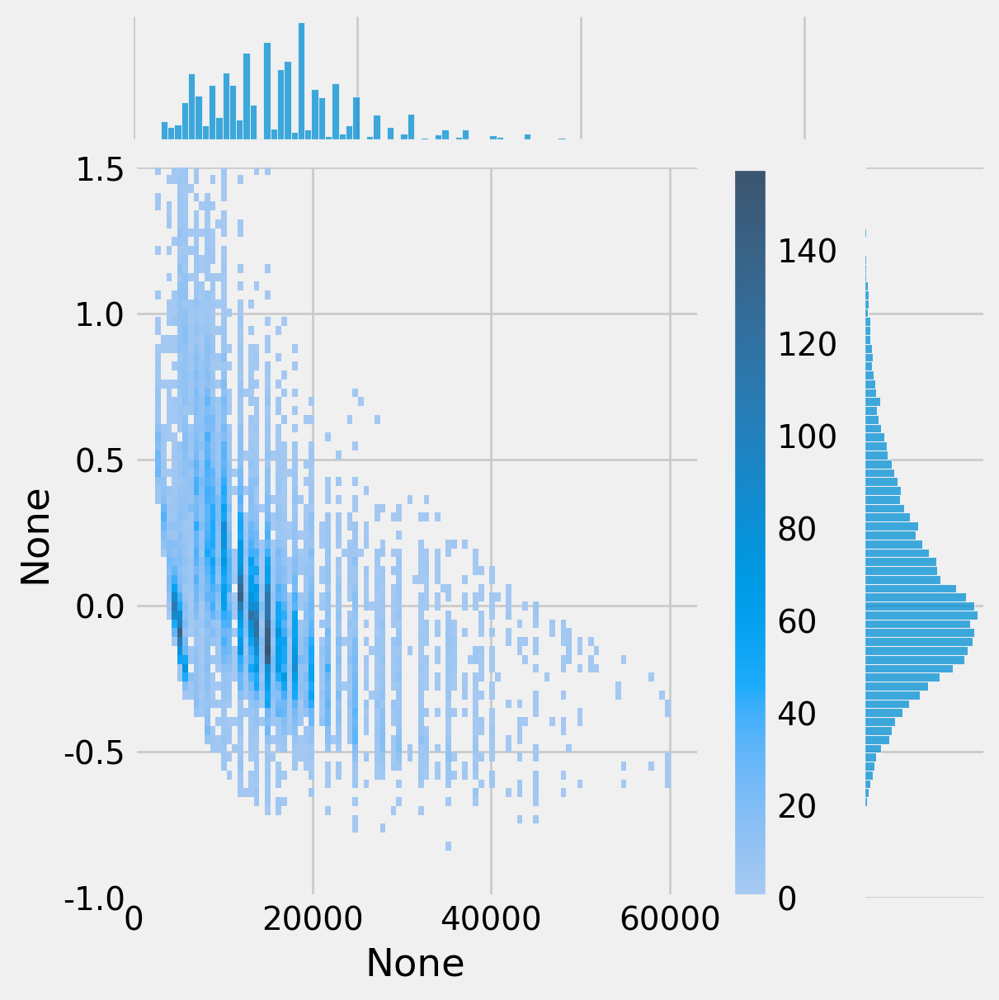

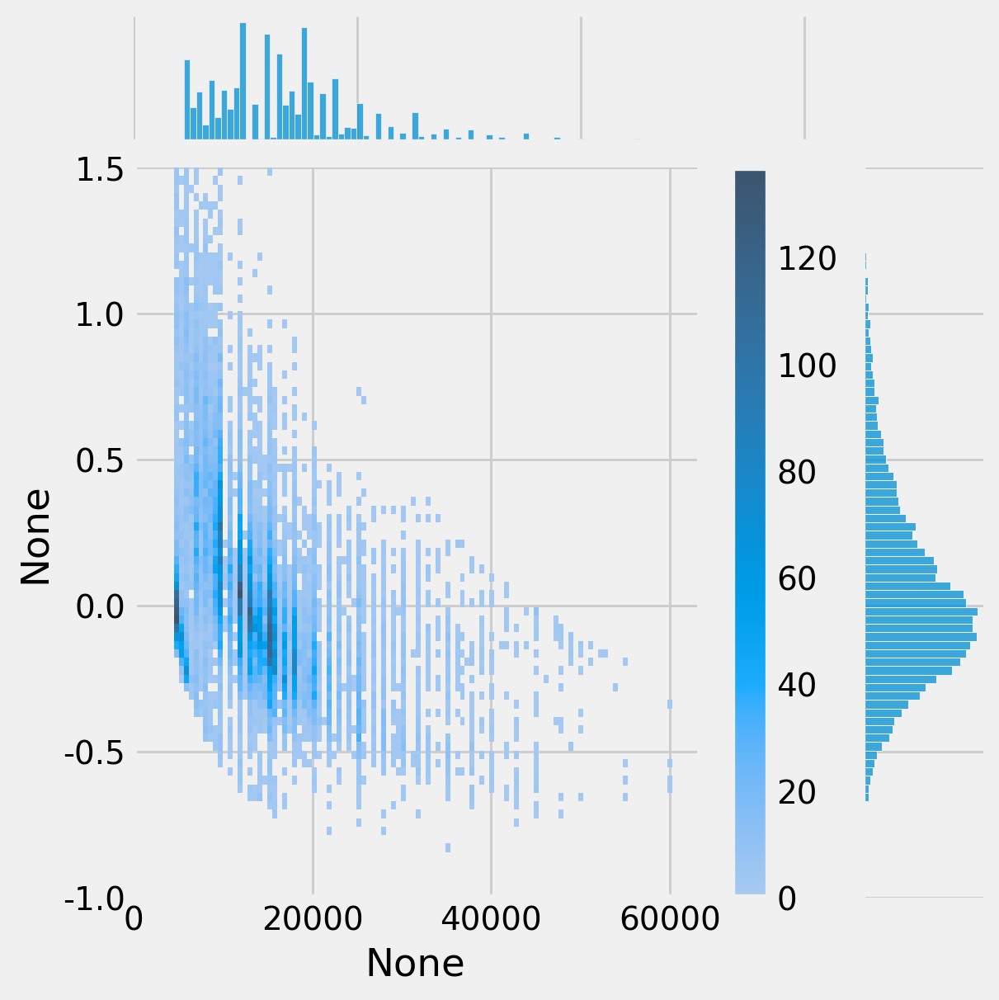

In [ ]:
test_plot_err_dist(best_model,iter_dict['vld'],criterion,device,percent=True,cbar=True,pthresh=0.00001,xlim=(0,63000),ylim=(-1,1.5)) #gridsize 180
test_plot_err_dist(best_model,iter_dict_box[3]['vld'],criterion,device,percent=True,cbar=True,pthresh=0.00001,xlim=(0,63000),ylim=(-1,1.5)) #gridsize 180

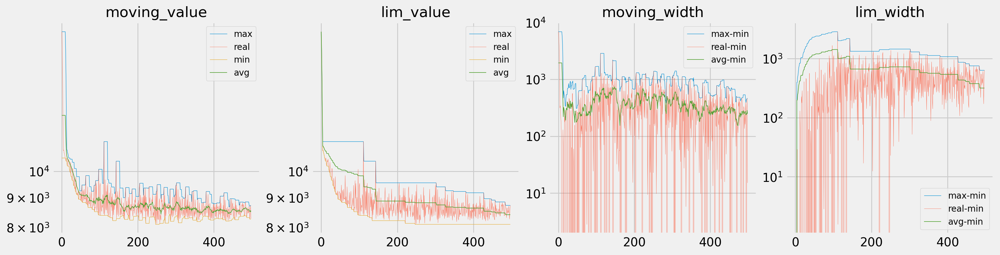

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

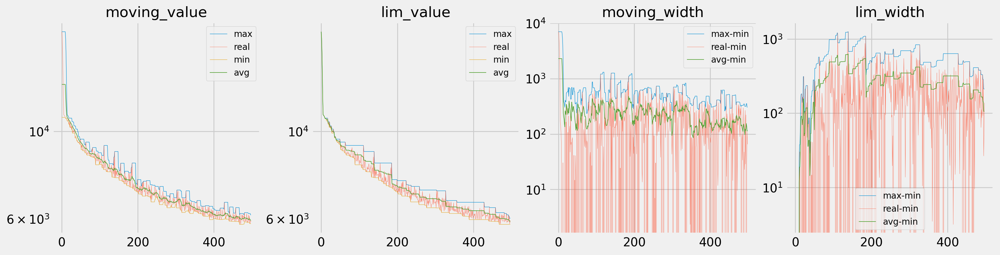

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

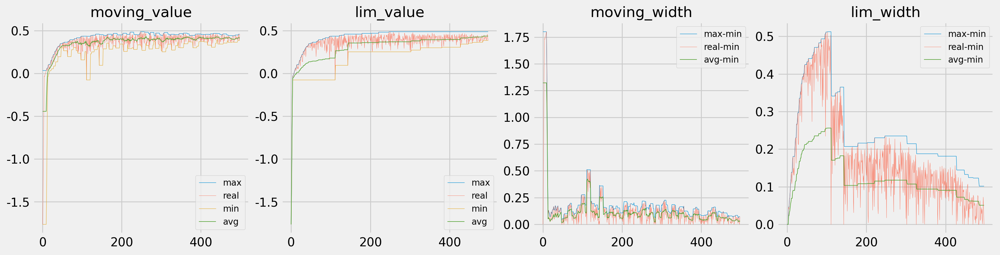

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 4

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(4)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008247
	Train Loss: 16041.199	Train Score: -2.855	Val Loss: 15946.197	Val Score: -2.849
Epoch:     2		lr: 0.00008247
	Train Loss: 15866.778	Train Score: -2.774	Val Loss: 15668.166	Val Score: -2.717
Epoch:     3		lr: 0.00008247
	Train Loss: 15529.277	Train Score: -2.618	Val Loss: 15204.042	Val Score: -2.500
Epoch:     4		lr: 0.00008247
	Train Loss: 15020.101	Train Score: -2.387	Val Loss: 14567.724	Val Score: -2.215
Epoch:     5		lr: 0.00008247
	Train Loss: 14351.619	Train Score: -2.094	Val Loss: 13772.713	Val Score: -1.875
Epoch:     6		lr: 0.00008247
	Train Loss: 13539.609	Train Score: -1.756	Val Loss: 12844.129	Val Score: -1.503
Epoch:     7		lr: 0.00008247
	Train Loss: 12603.100	Train Score: -1.390	Val Loss: 11802.895	Val Score: -1.116
Epoch:     8		lr: 0.00008247
	Train Loss: 11572.751	Train Score: -1.017	Val Loss: 10701.478	Val Score: -0.742
Epoch:     9		lr: 0.00008247
	Train Loss: 10499.588	Train Score: -0.661	Val Loss: 9616.320	Val Score: -0.410
Epoch:    1

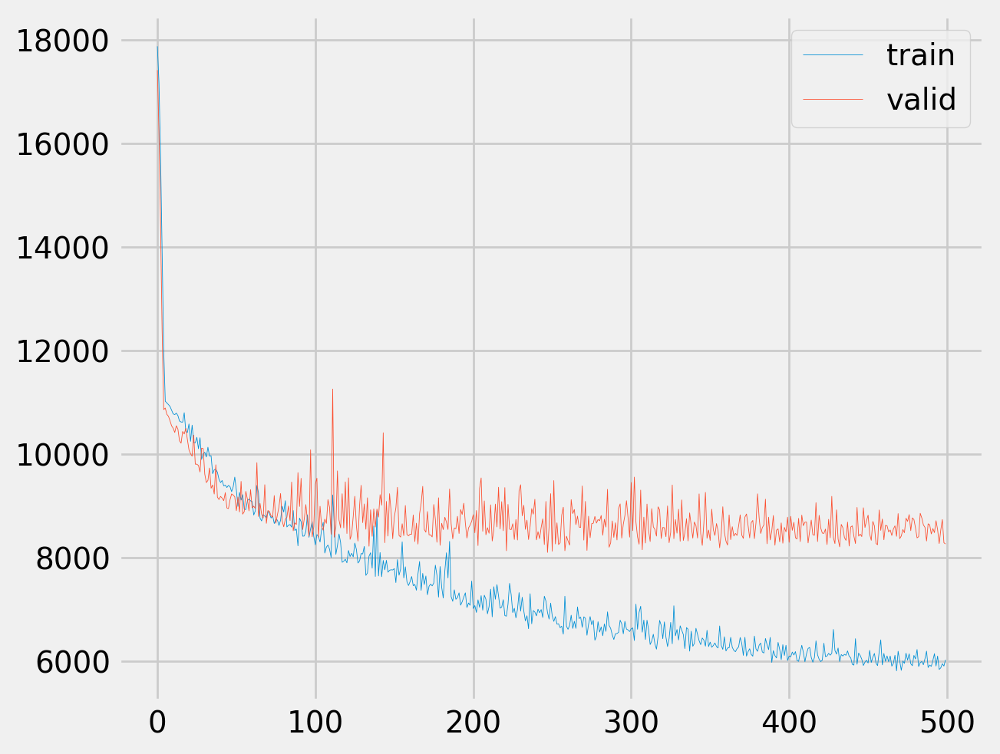

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


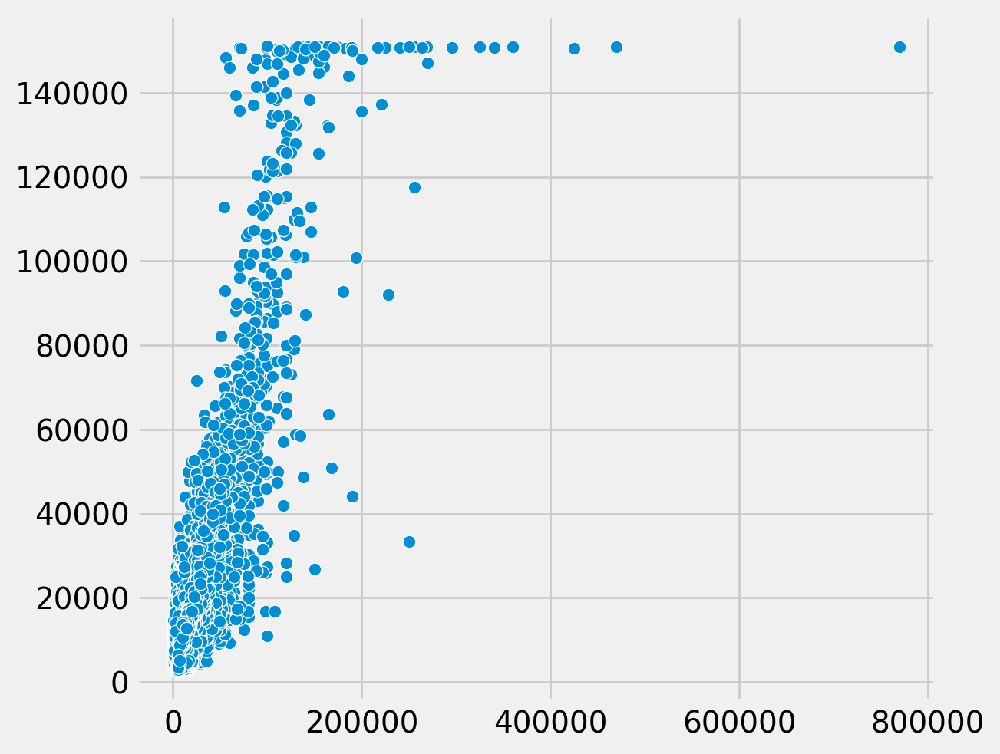

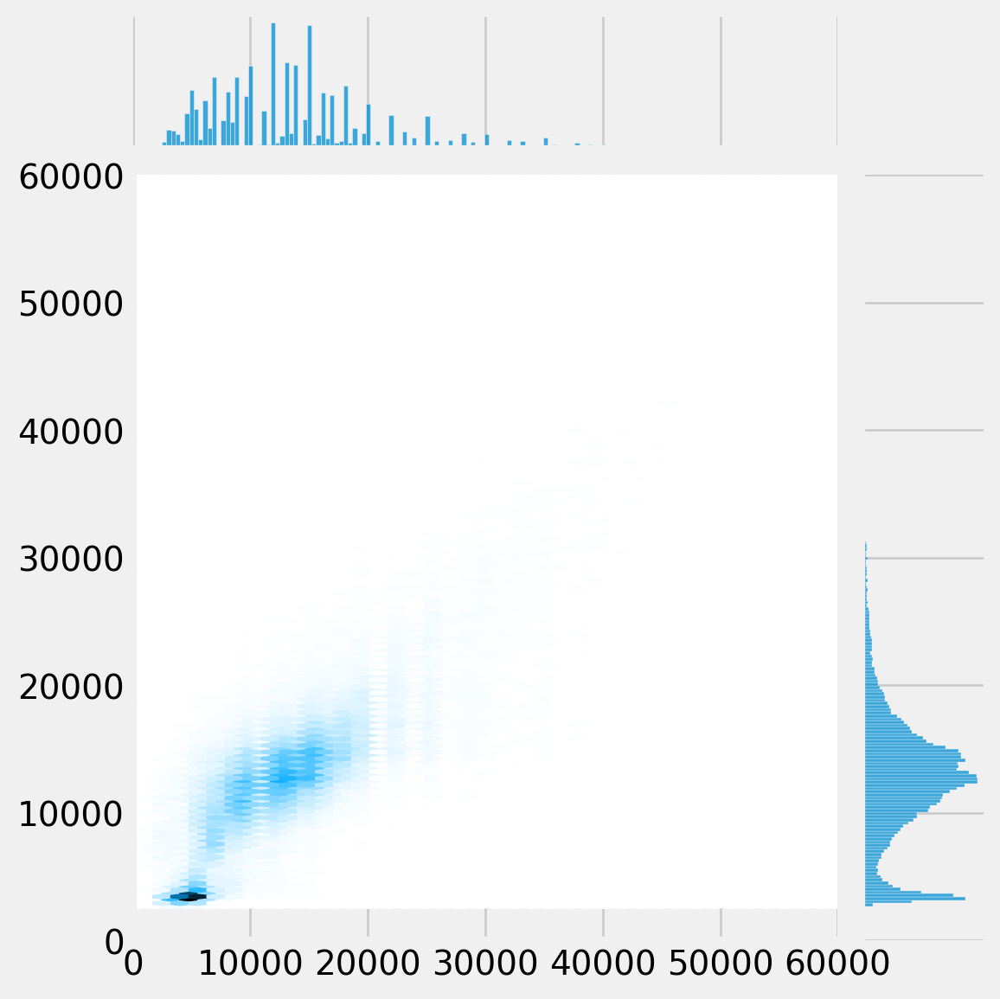

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


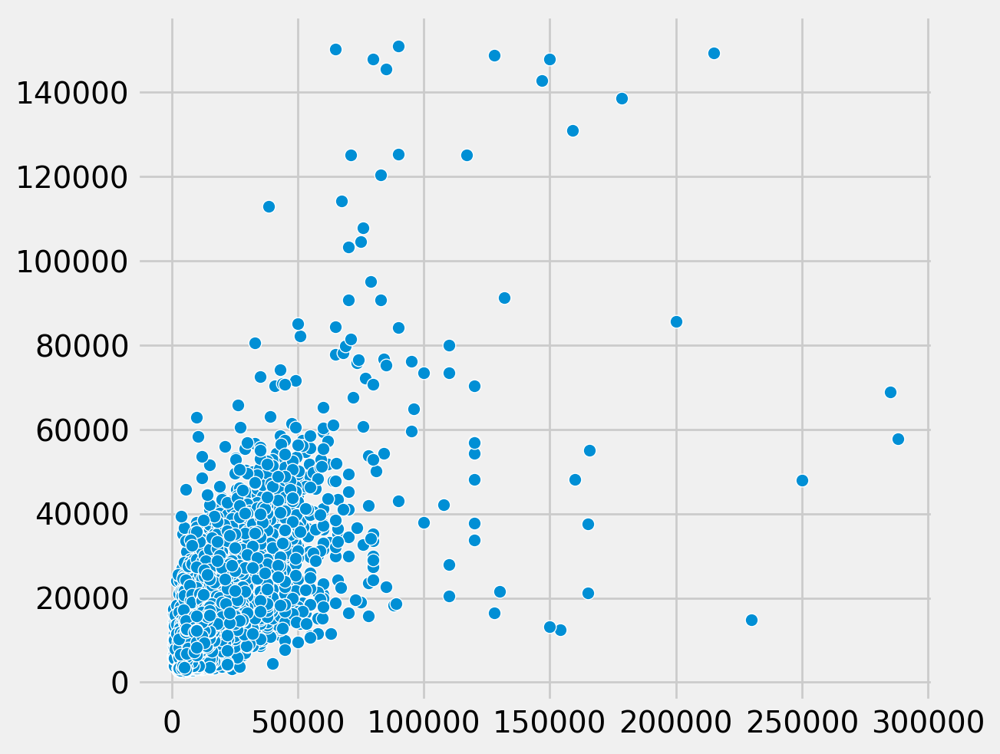

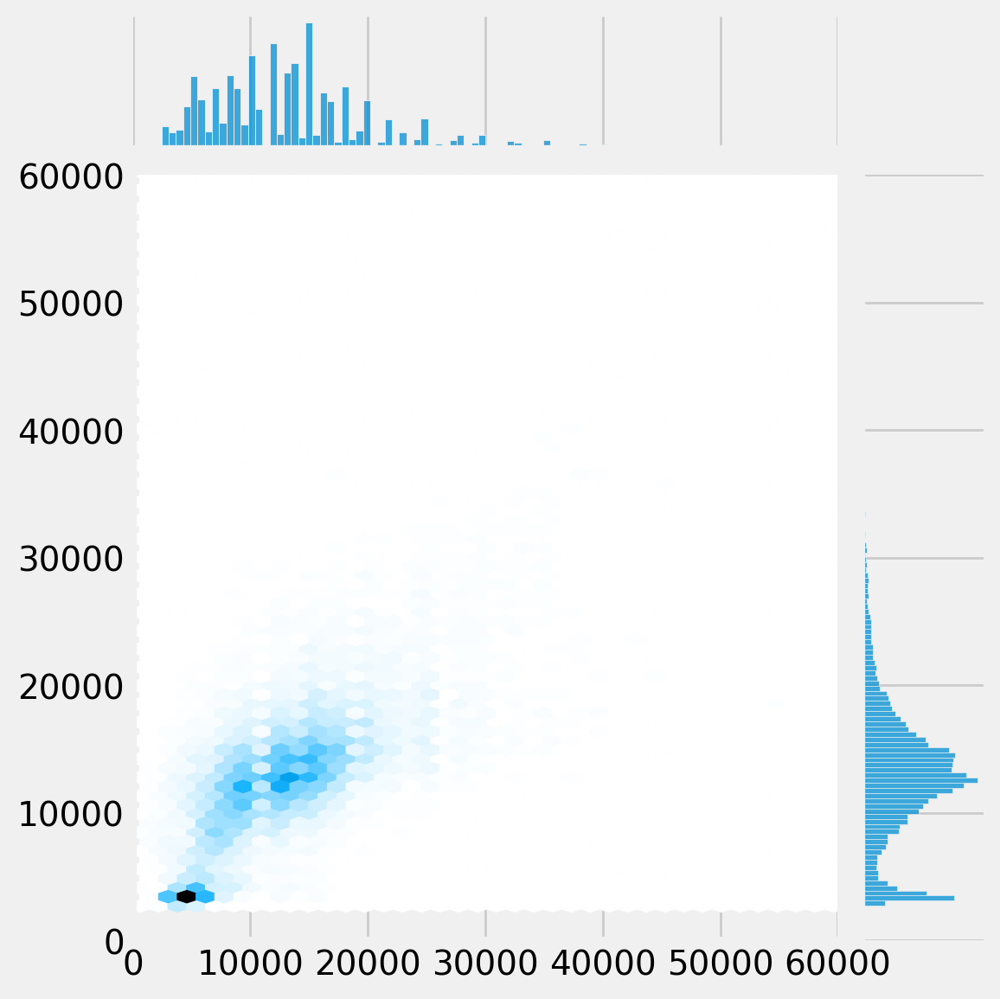

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


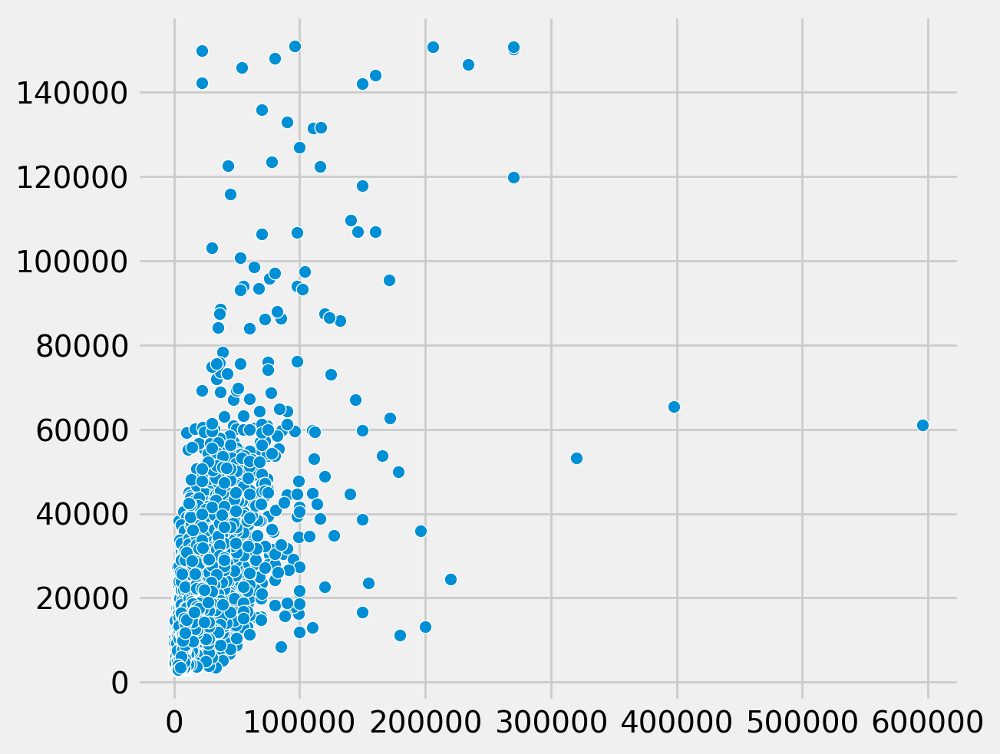

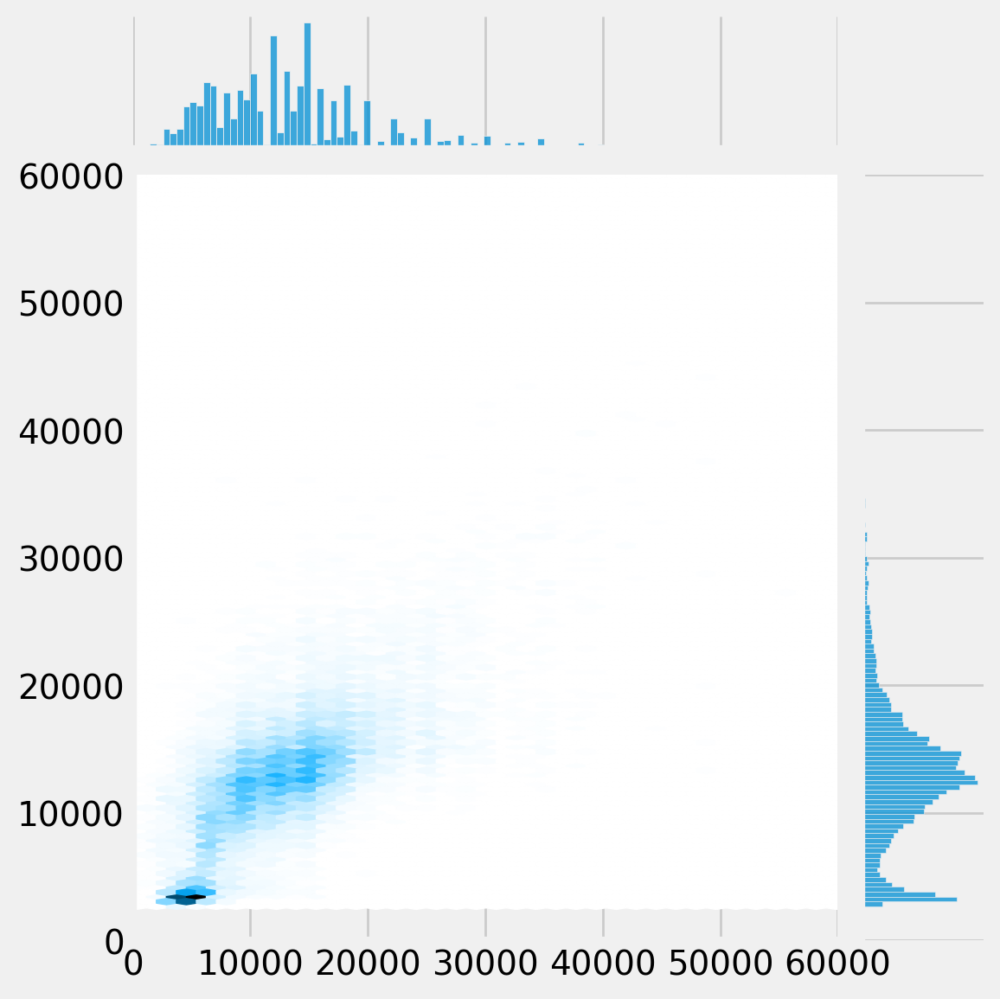

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


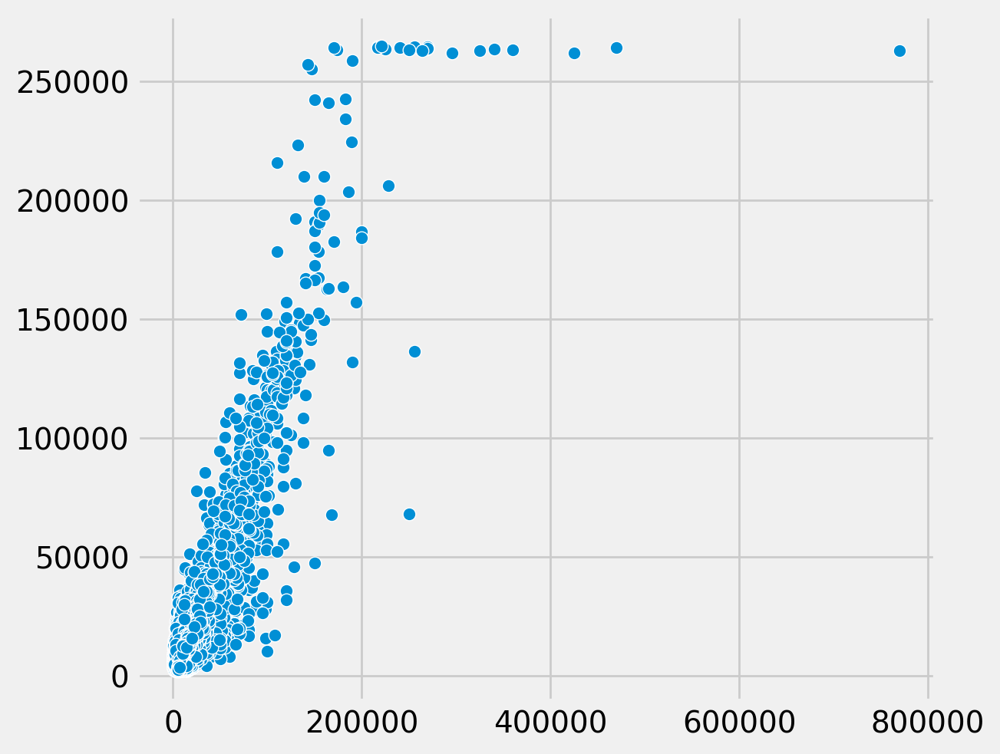

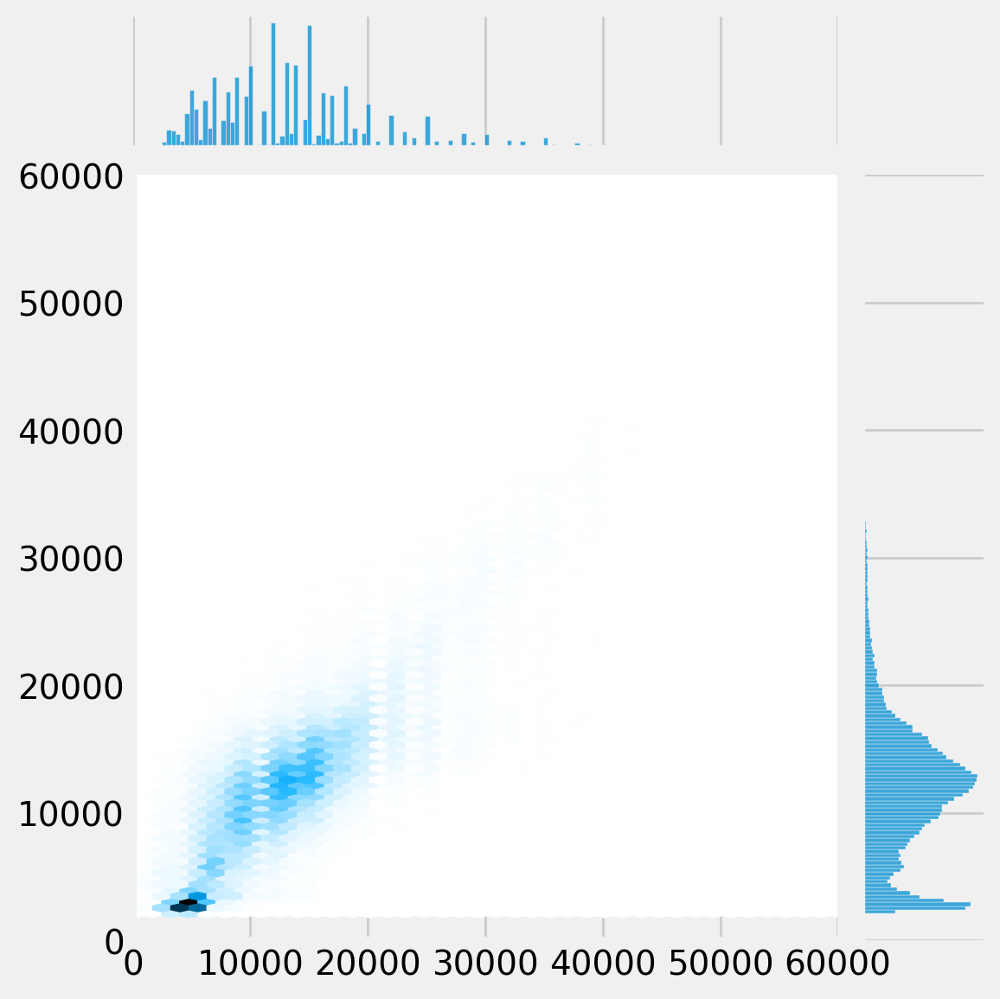

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


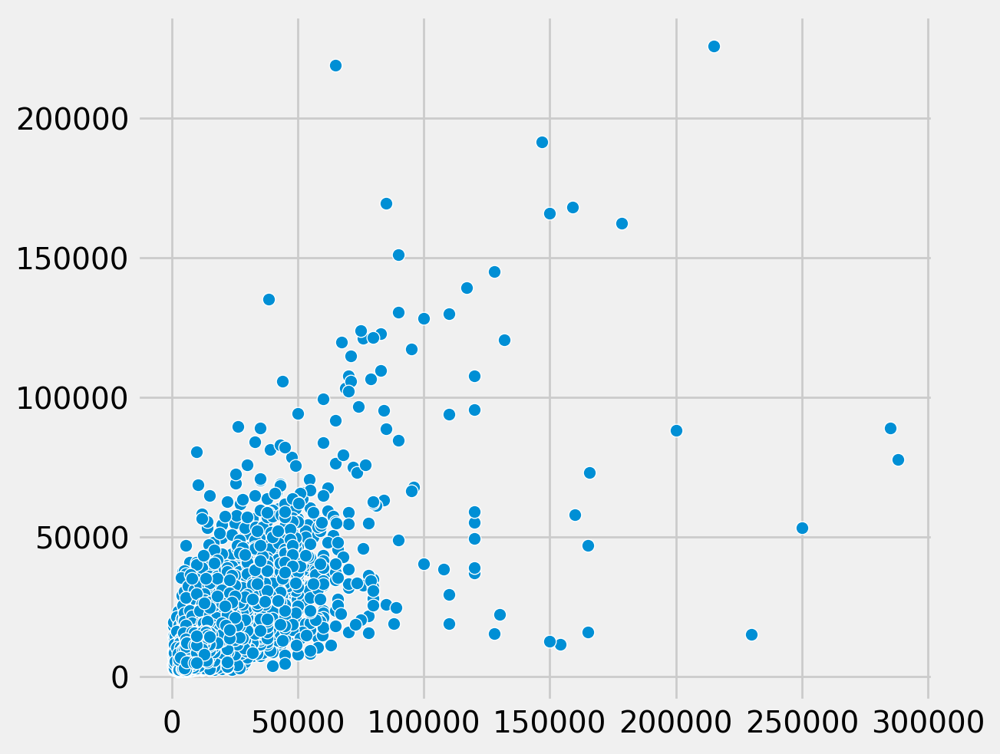

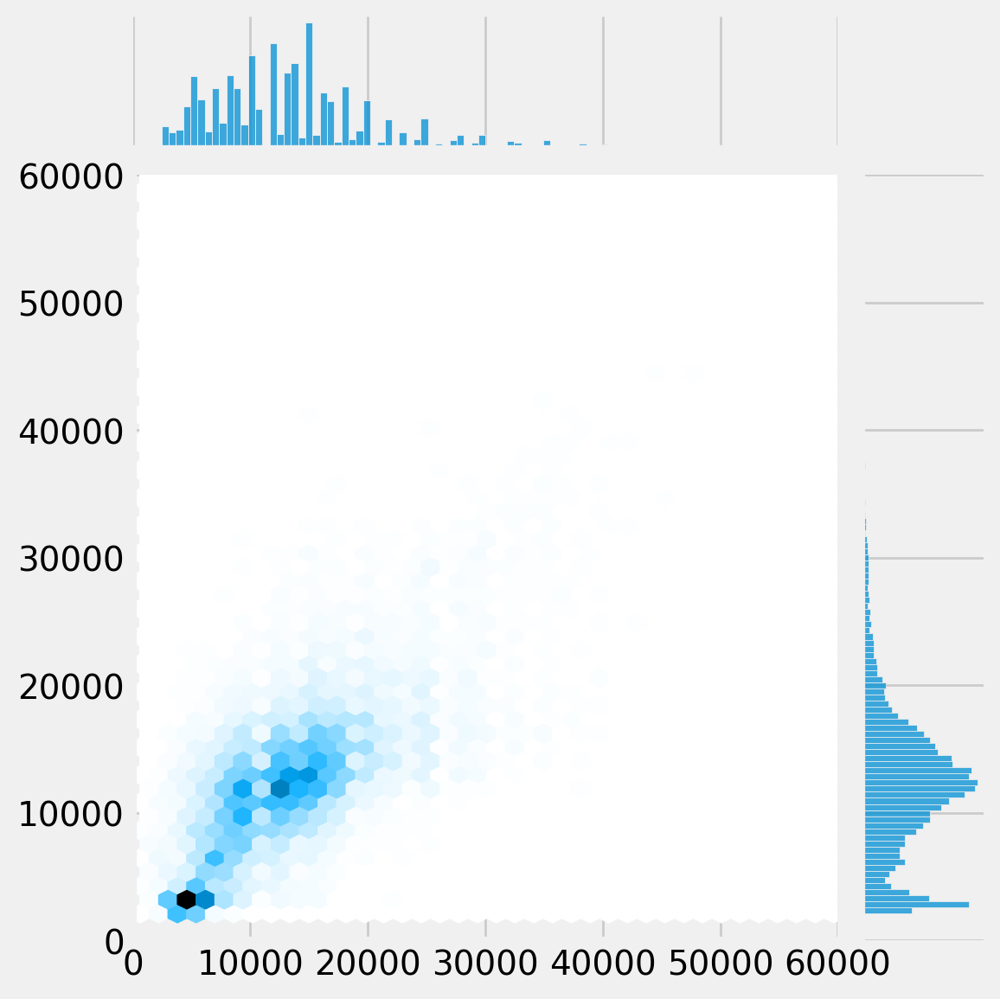

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


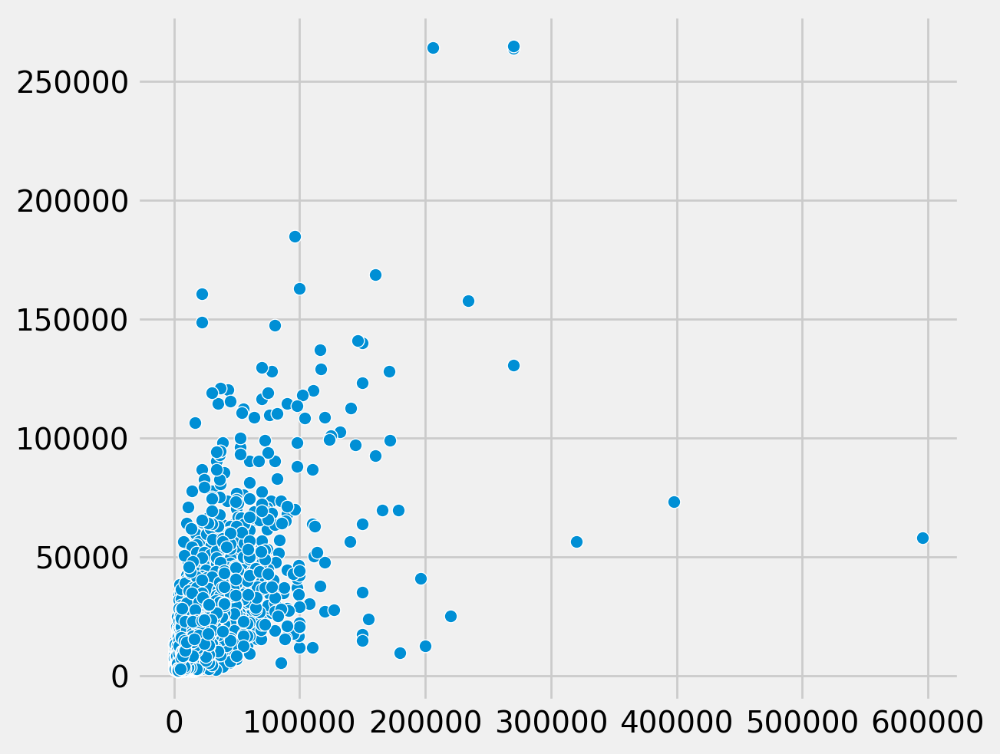

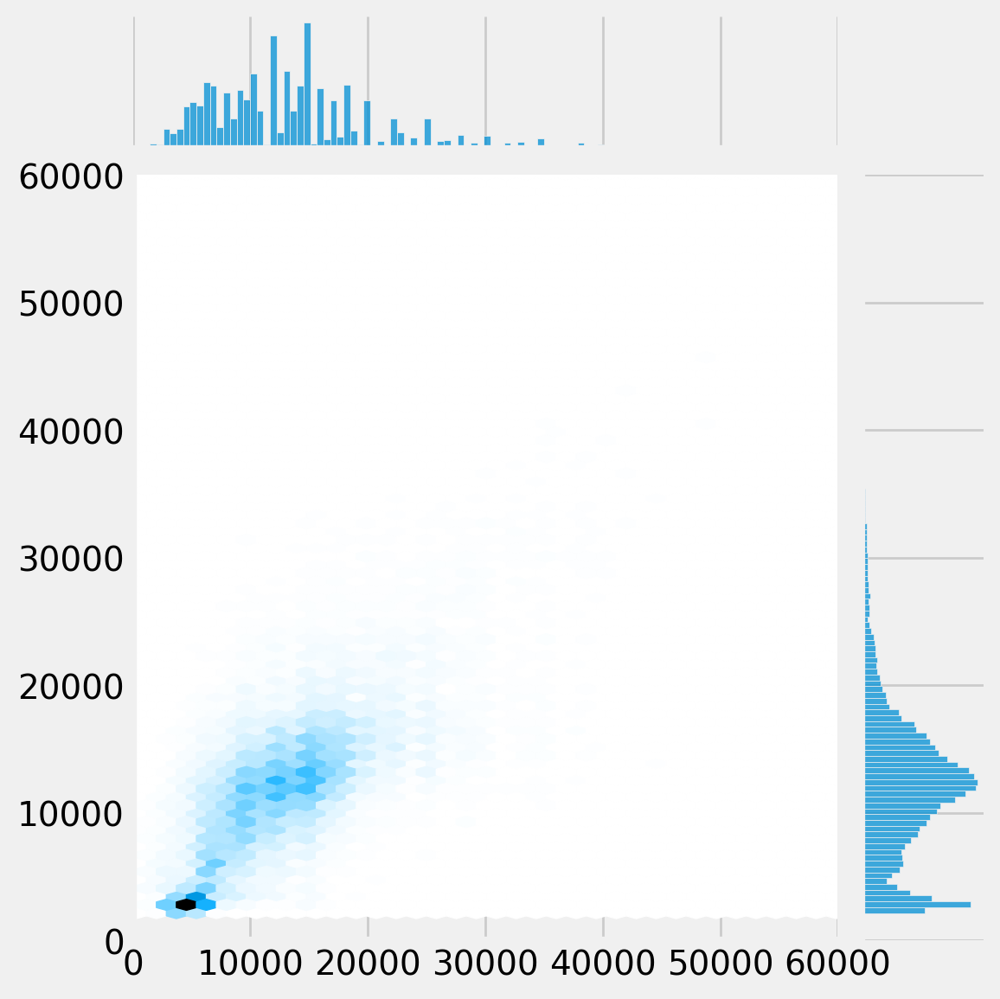

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

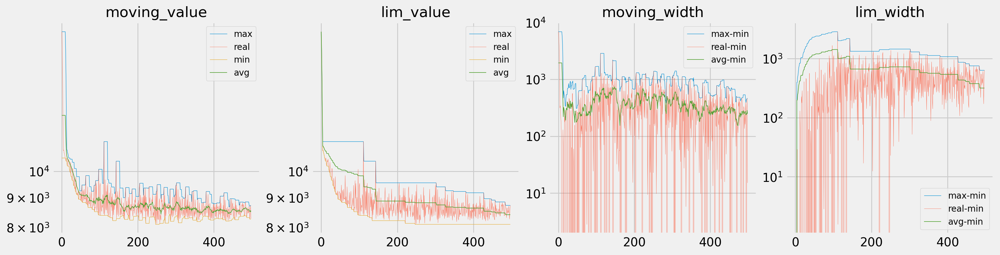

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

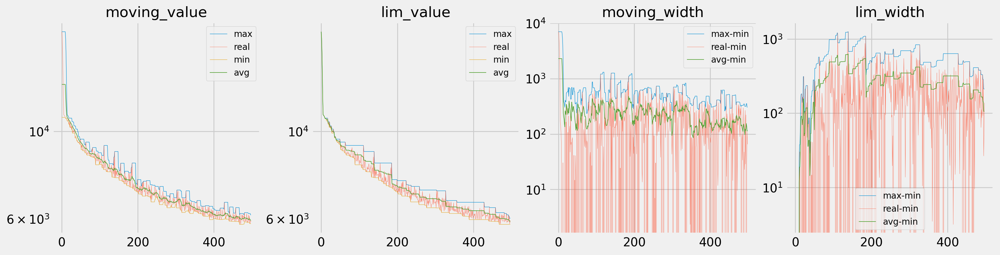

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

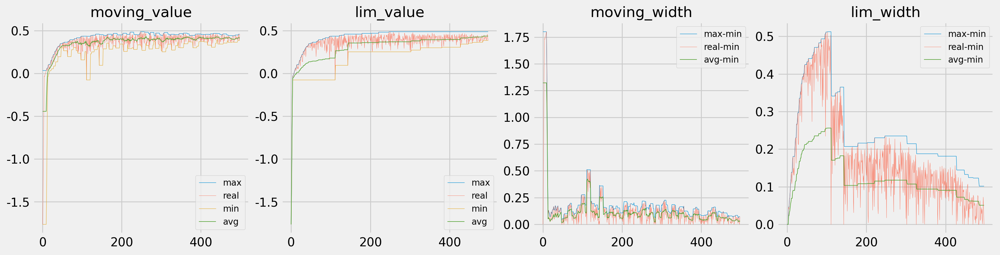

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 5

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(5)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008247
	Train Loss: 16041.199	Train Score: -2.855	Val Loss: 15946.197	Val Score: -2.849
Epoch:     2		lr: 0.00008247
	Train Loss: 15866.778	Train Score: -2.774	Val Loss: 15668.166	Val Score: -2.717
Epoch:     3		lr: 0.00008247
	Train Loss: 15529.277	Train Score: -2.618	Val Loss: 15204.042	Val Score: -2.500
Epoch:     4		lr: 0.00008247
	Train Loss: 15020.101	Train Score: -2.387	Val Loss: 14567.724	Val Score: -2.215
Epoch:     5		lr: 0.00008247
	Train Loss: 14351.619	Train Score: -2.094	Val Loss: 13772.713	Val Score: -1.875
Epoch:     6		lr: 0.00008247
	Train Loss: 13539.609	Train Score: -1.756	Val Loss: 12844.129	Val Score: -1.503
Epoch:     7		lr: 0.00008247
	Train Loss: 12603.100	Train Score: -1.390	Val Loss: 11802.895	Val Score: -1.116
Epoch:     8		lr: 0.00008247
	Train Loss: 11572.751	Train Score: -1.017	Val Loss: 10701.478	Val Score: -0.742
Epoch:     9		lr: 0.00008247
	Train Loss: 10499.588	Train Score: -0.661	Val Loss: 9616.320	Val Score: -0.410
Epoch:    1

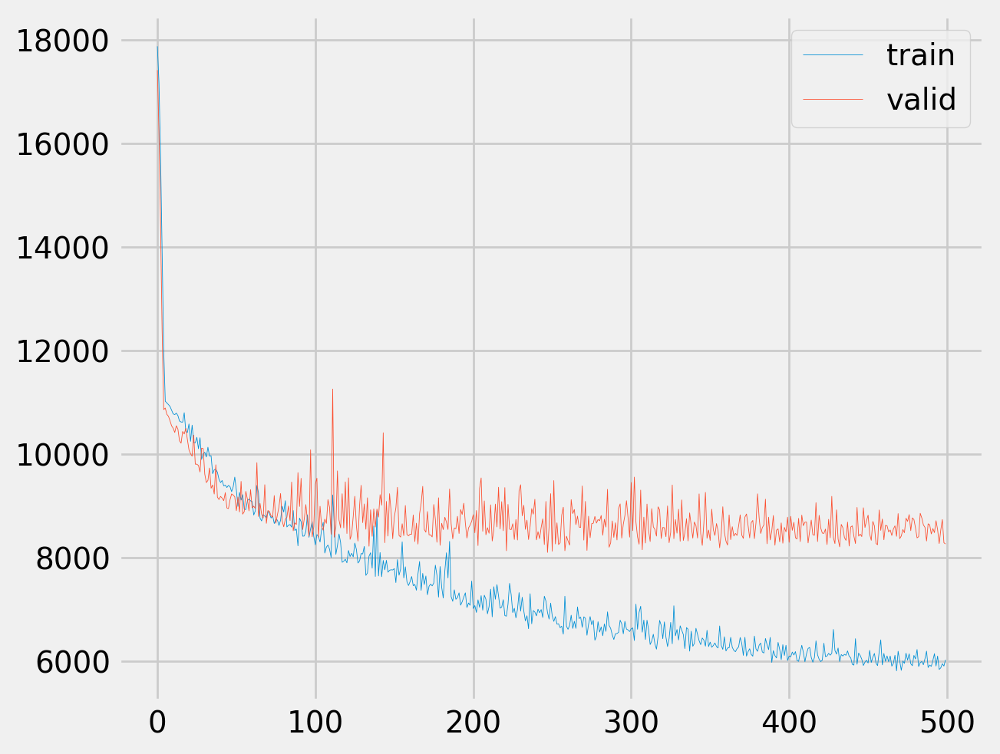

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


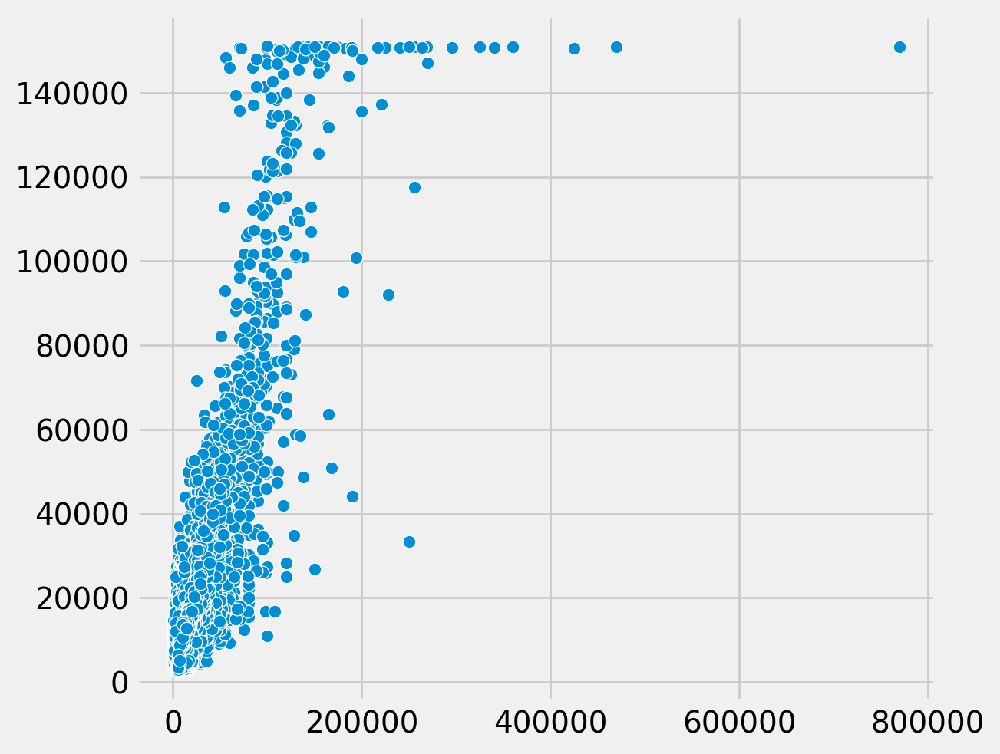

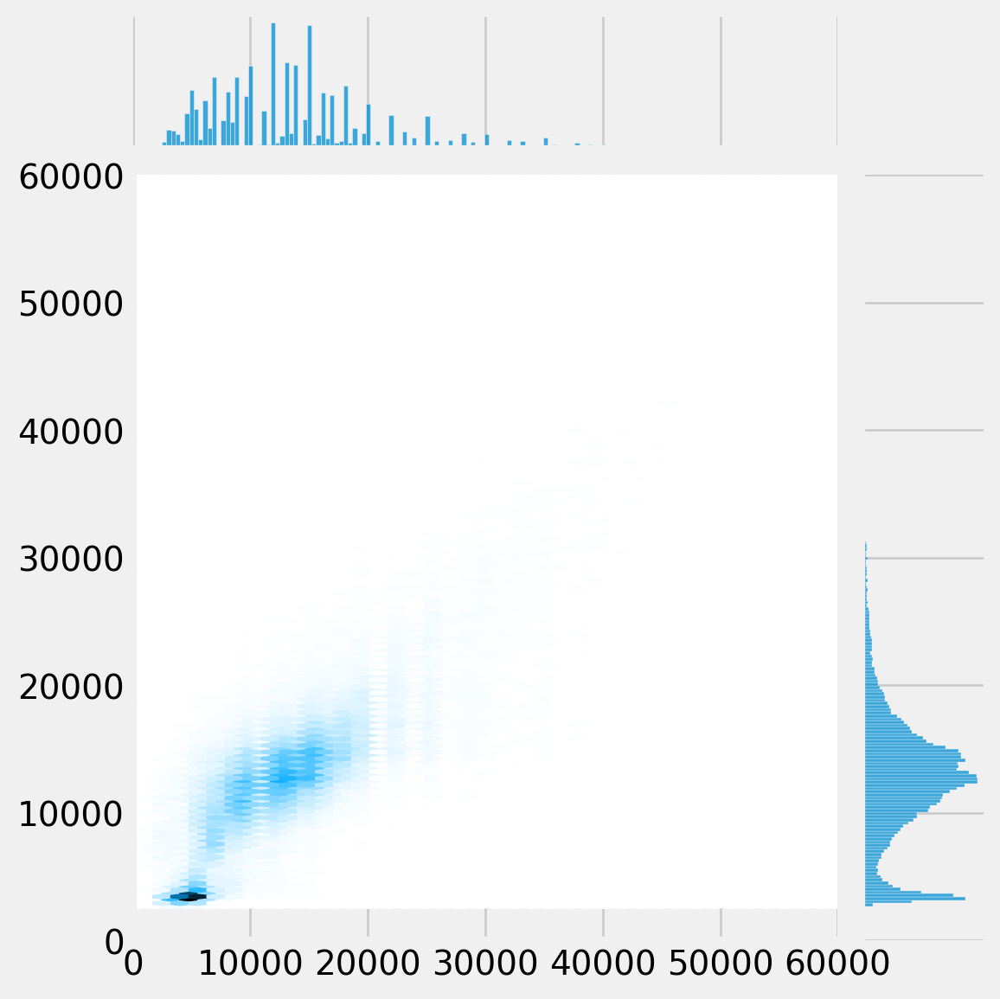

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


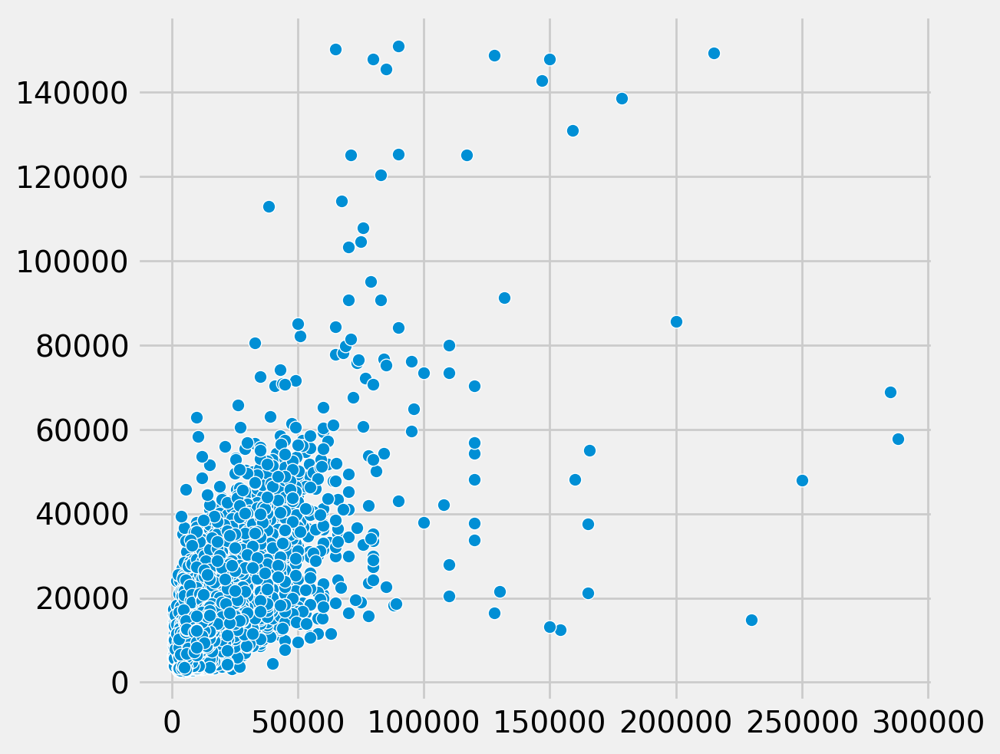

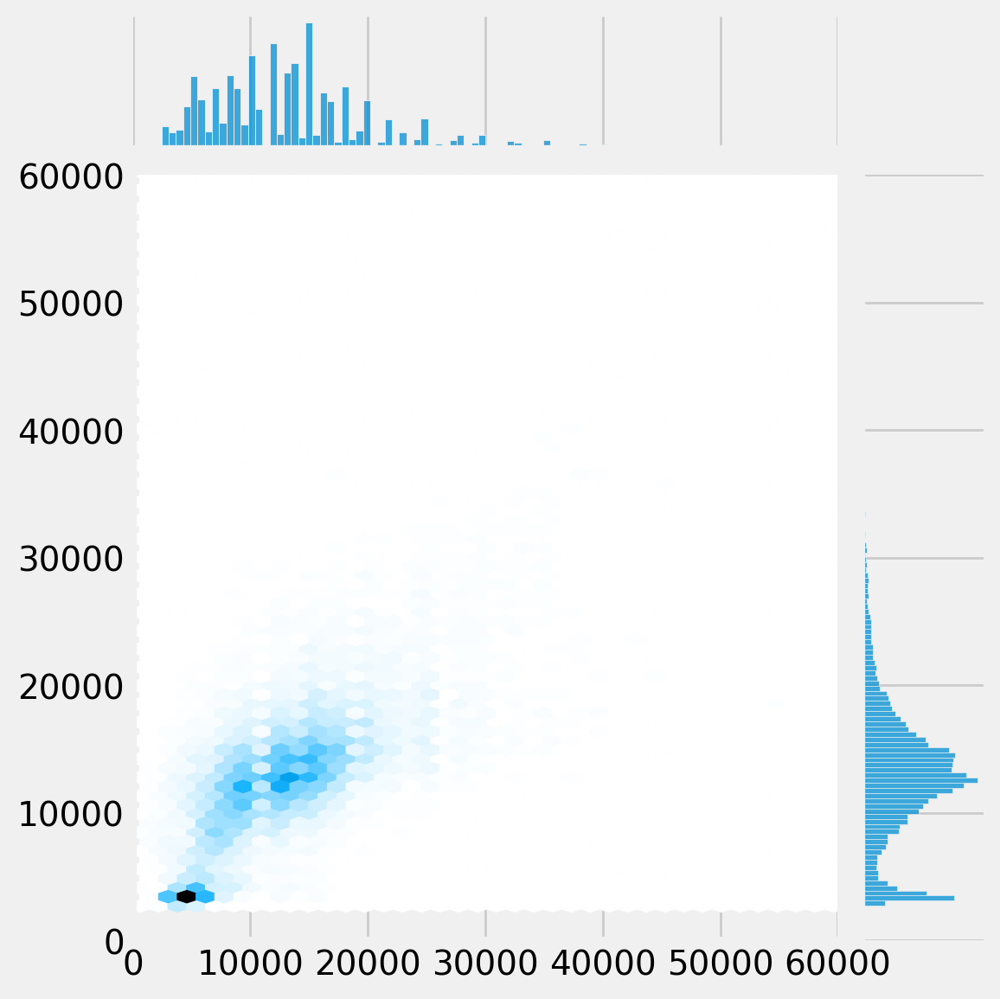

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


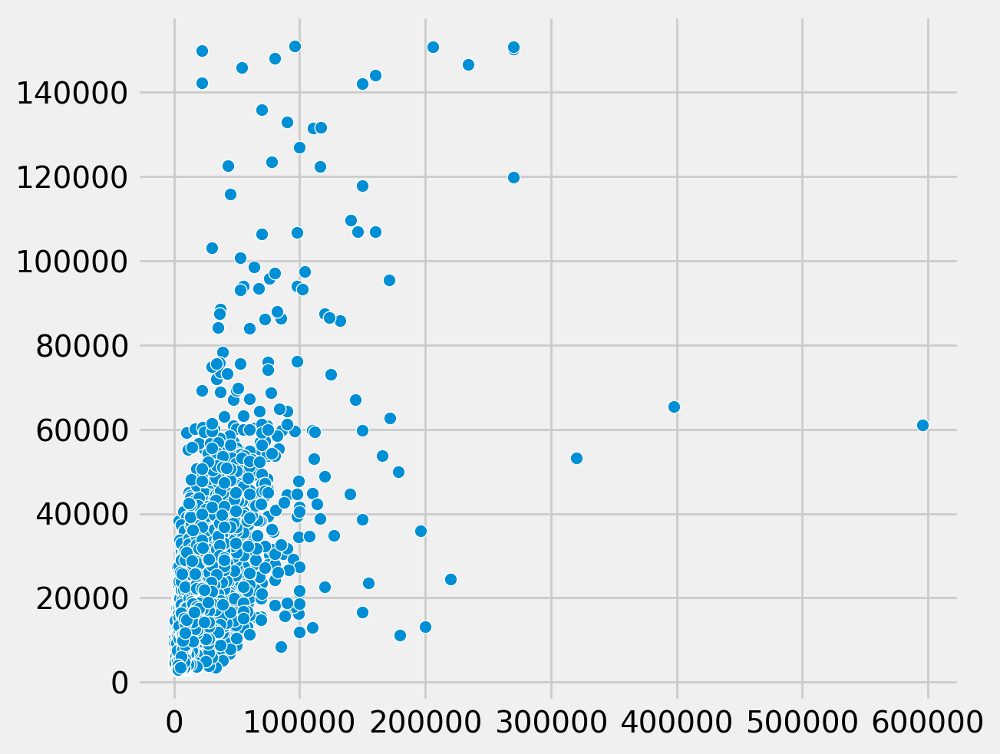

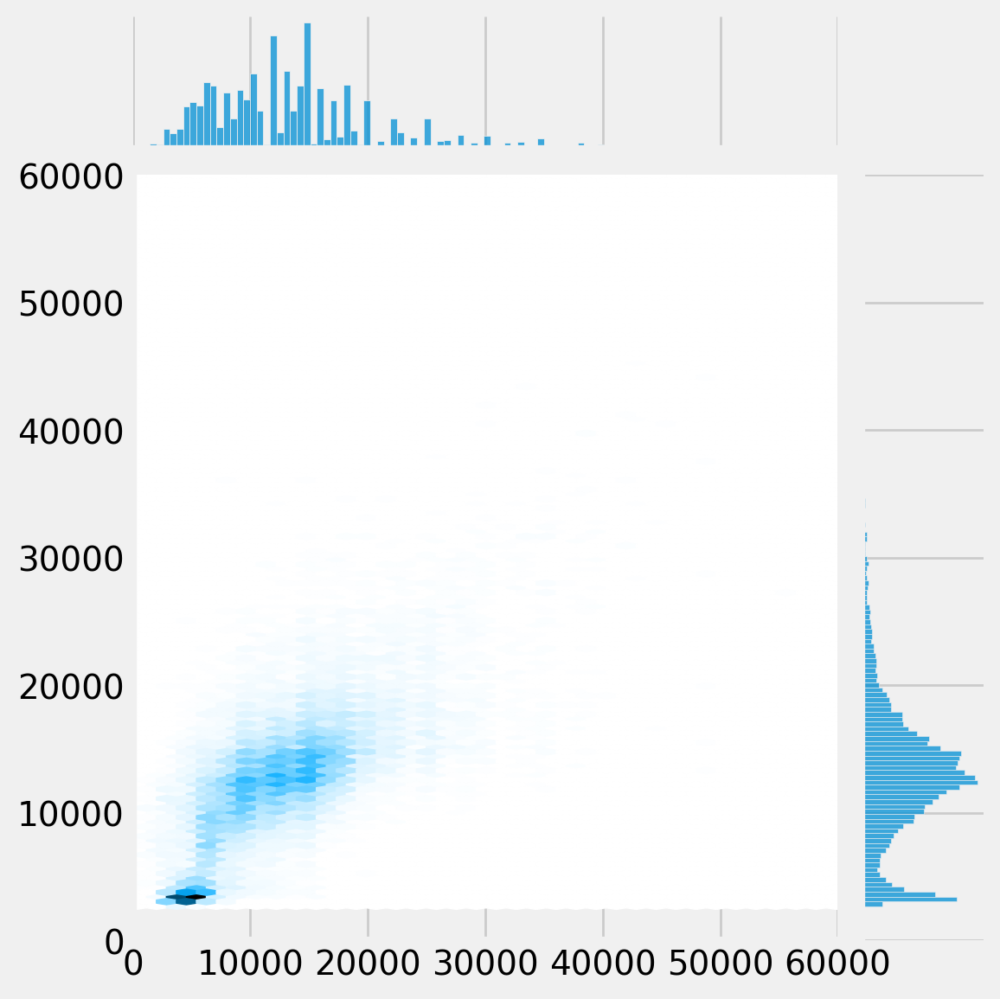

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


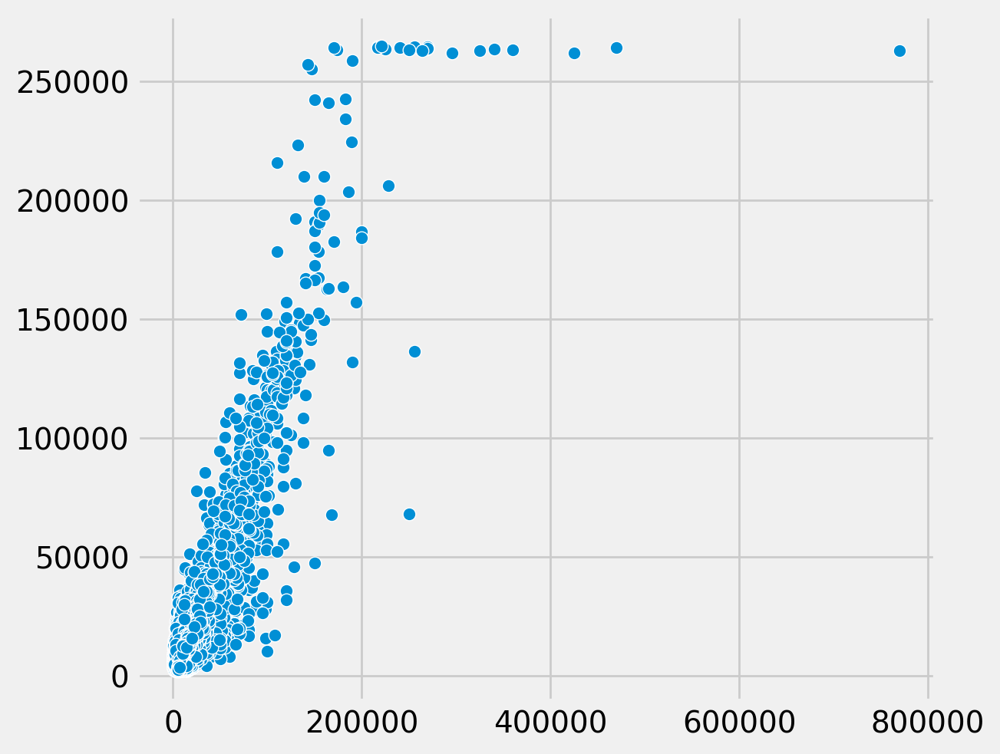

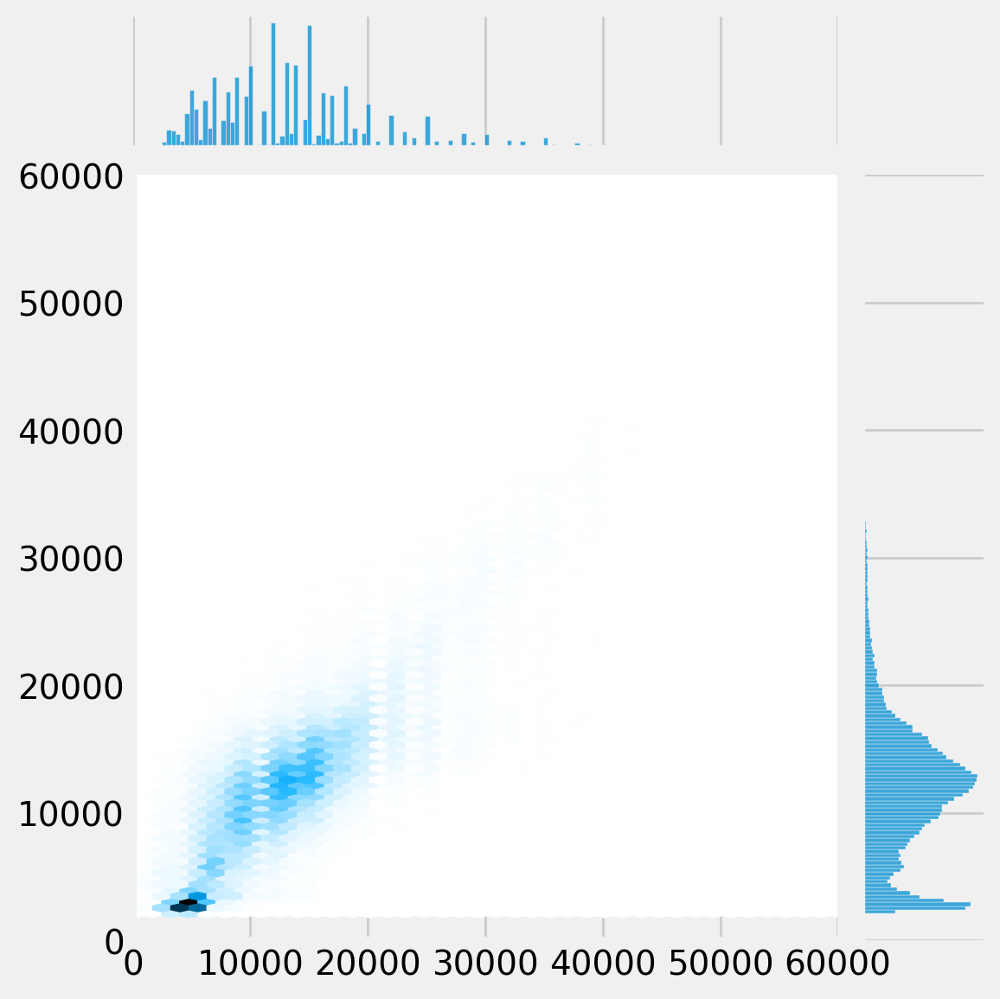

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


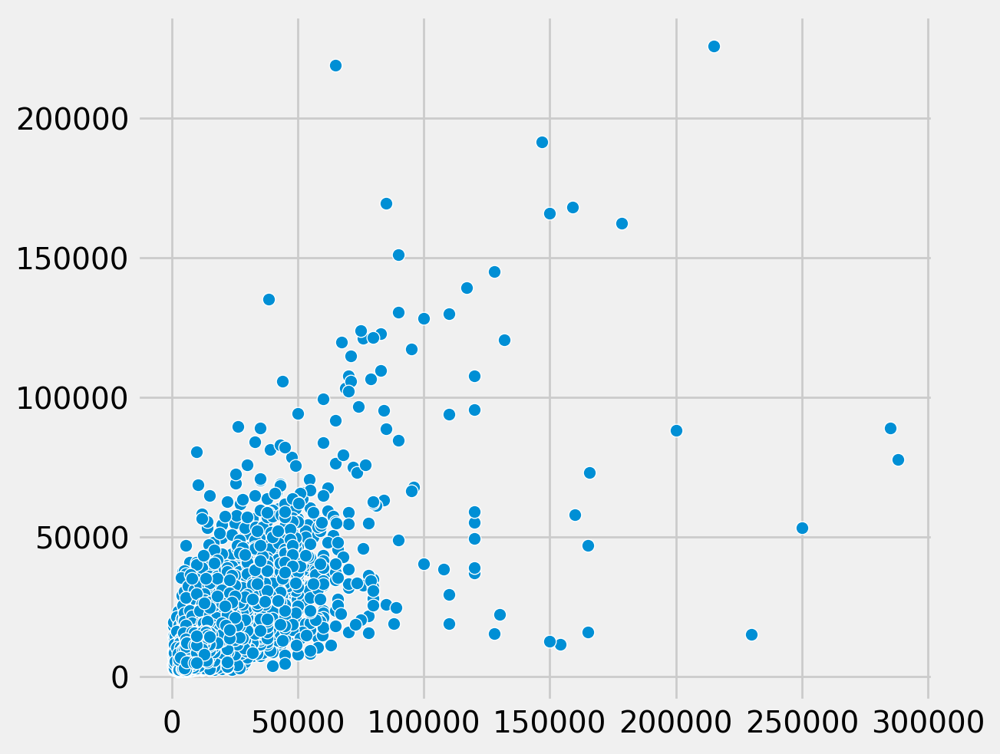

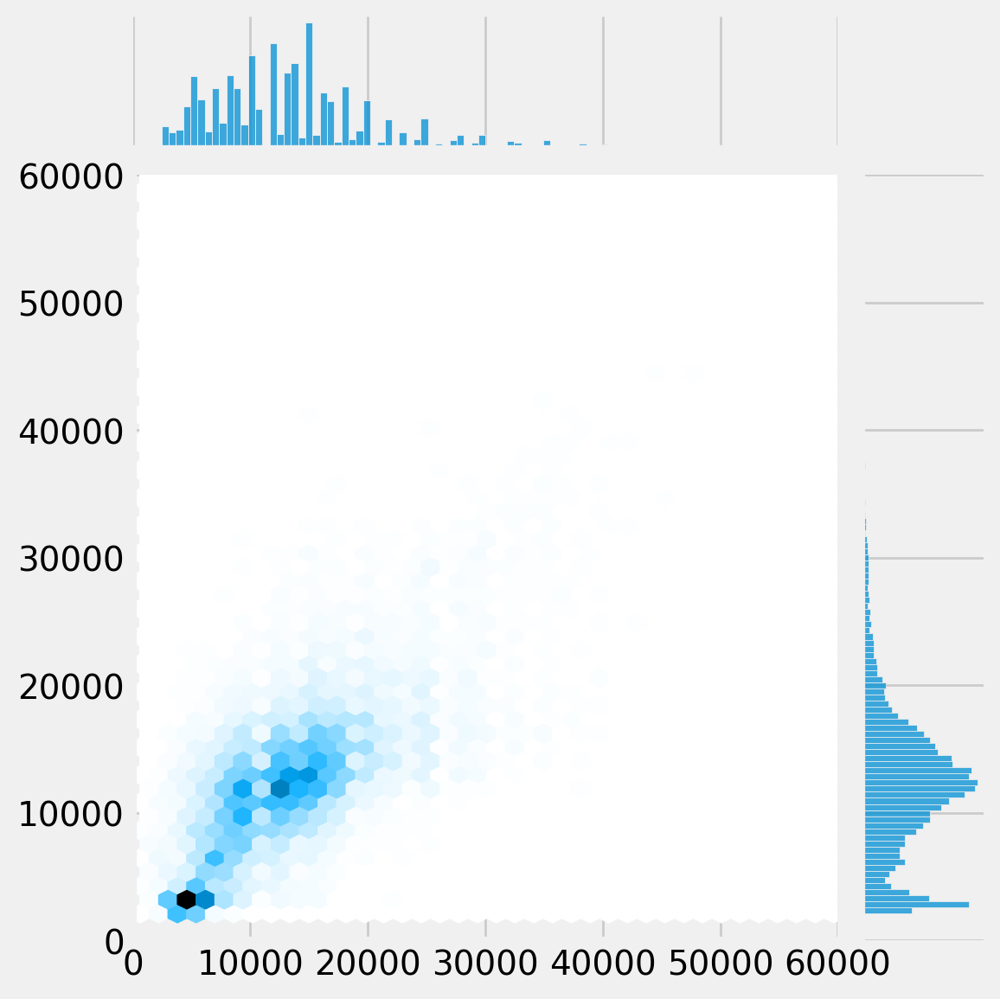

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


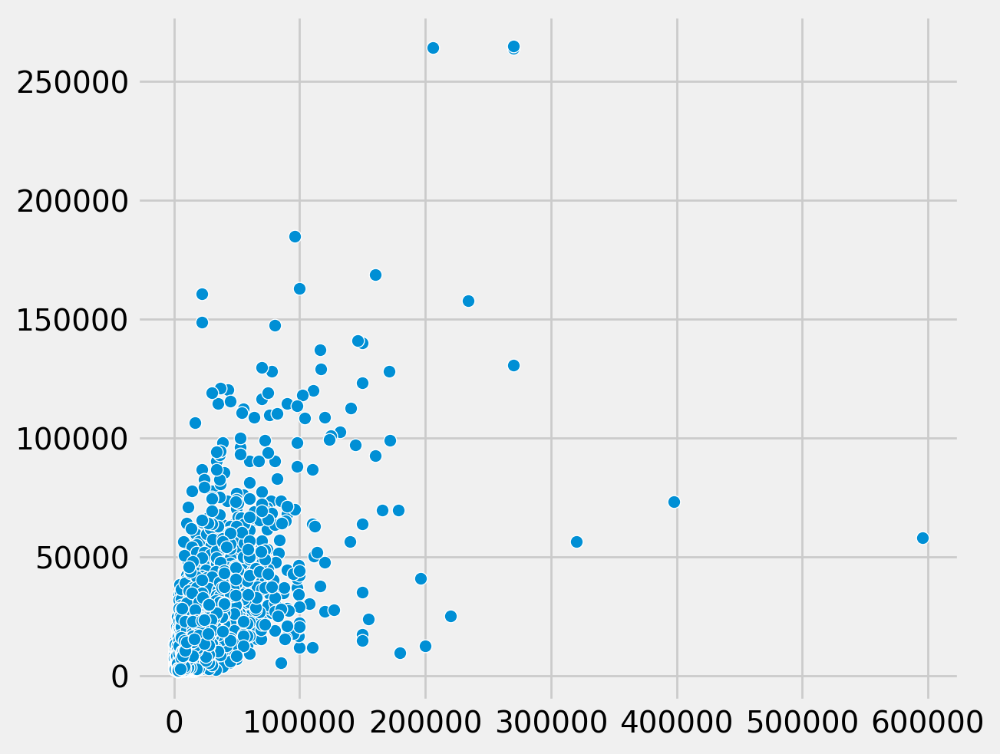

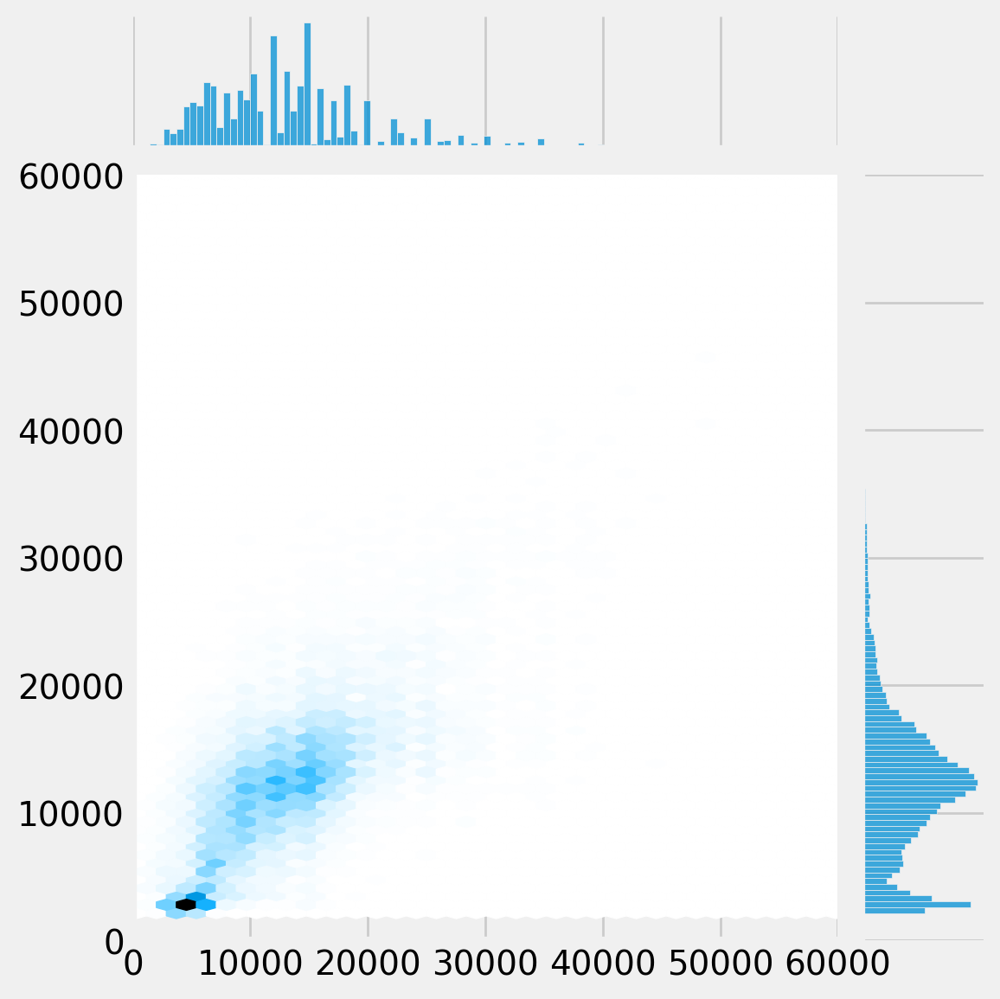

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

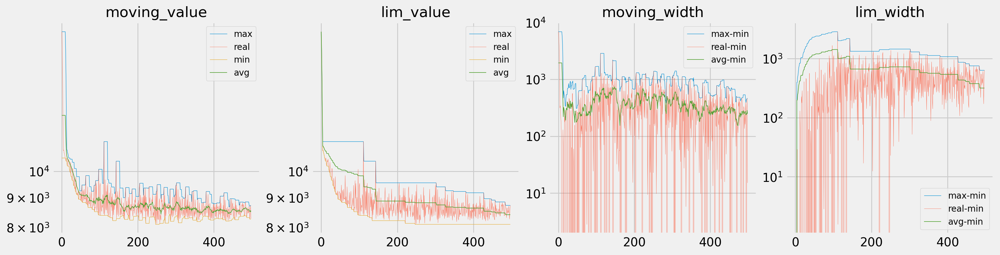

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

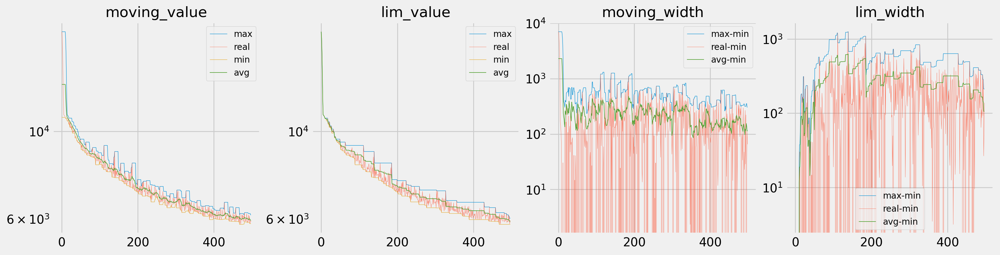

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

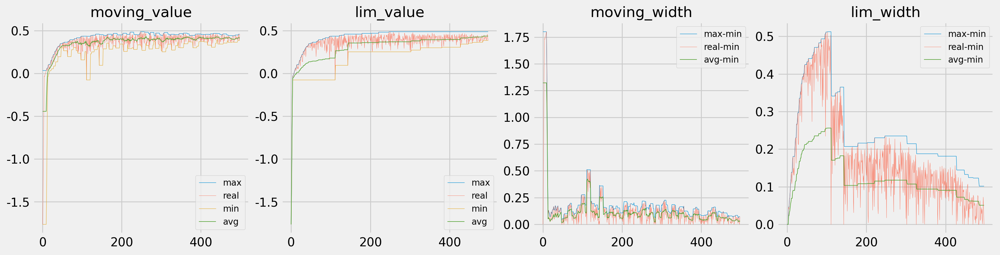

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 6

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16028.539	Train Score: -2.850	Val Loss: 15907.730	Val Score: -2.831
Epoch:     2		lr: 0.00009245
	Train Loss: 15792.346	Train Score: -2.740	Val Loss: 15527.422	Val Score: -2.650
Epoch:     3		lr: 0.00009245
	Train Loss: 15332.240	Train Score: -2.528	Val Loss: 14912.197	Val Score: -2.368
Epoch:     4		lr: 0.00009245
	Train Loss: 14660.773	Train Score: -2.229	Val Loss: 14094.904	Val Score: -2.011
Epoch:     5		lr: 0.00009245
	Train Loss: 13808.672	Train Score: -1.867	Val Loss: 13108.078	Val Score: -1.606
Epoch:     6		lr: 0.00009245
	Train Loss: 12806.008	Train Score: -1.468	Val Loss: 11990.887	Val Score: -1.183
Epoch:     7		lr: 0.00009245
	Train Loss: 11693.129	Train Score: -1.060	Val Loss: 10795.863	Val Score: -0.773
Epoch:     8		lr: 0.00009245
	Train Loss: 10530.860	Train Score: -0.672	Val Loss: 9621.622	Val Score: -0.412
Epoch:     9		lr: 0.00009245
	Train Loss: 9422.528	Train Score: -0.338	Val 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
init_lr *=(406/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16033.056	Train Score: -2.852	Val Loss: 15924.306	Val Score: -2.838
Epoch:     2		lr: 0.00009245
	Train Loss: 15818.267	Train Score: -2.752	Val Loss: 15570.205	Val Score: -2.670
Epoch:     3		lr: 0.00009245
	Train Loss: 15383.872	Train Score: -2.552	Val Loss: 14970.146	Val Score: -2.394
Epoch:     4		lr: 0.00009245
	Train Loss: 14724.848	Train Score: -2.257	Val Loss: 14143.830	Val Score: -2.031
Epoch:     5		lr: 0.00009245
	Train Loss: 13862.448	Train Score: -1.890	Val Loss: 13124.092	Val Score: -1.612
Epoch:     6		lr: 0.00009245
	Train Loss: 12826.636	Train Score: -1.477	Val Loss: 11947.307	Val Score: -1.168
Epoch:     7		lr: 0.00009245
	Train Loss: 11655.535	Train Score: -1.047	Val Loss: 10679.832	Val Score: -0.735
Epoch:     8		lr: 0.00009245
	Train Loss: 10425.184	Train Score: -0.639	Val Loss: 9446.210	Val Score: -0.361
Epoch:     9		lr: 0.00009245
	Train Loss: 9263.572	Train Score: -0.294	Val 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
init_lr *=(best_epoch/450)*(406/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16035.993	Train Score: -2.853	Val Loss: 15925.611	Val Score: -2.839
Epoch:     2		lr: 0.00009245
	Train Loss: 15818.309	Train Score: -2.752	Val Loss: 15564.046	Val Score: -2.667
Epoch:     3		lr: 0.00009245
	Train Loss: 15366.496	Train Score: -2.544	Val Loss: 14942.699	Val Score: -2.382
Epoch:     4		lr: 0.00009245
	Train Loss: 14679.490	Train Score: -2.237	Val Loss: 14090.675	Val Score: -2.009
Epoch:     5		lr: 0.00009245
	Train Loss: 13785.349	Train Score: -1.858	Val Loss: 13048.666	Val Score: -1.582
Epoch:     6		lr: 0.00009245
	Train Loss: 12719.556	Train Score: -1.436	Val Loss: 11853.793	Val Score: -1.134
Epoch:     7		lr: 0.00009245
	Train Loss: 11531.625	Train Score: -1.004	Val Loss: 10583.800	Val Score: -0.704
Epoch:     8		lr: 0.00009245
	Train Loss: 10298.075	Train Score: -0.599	Val Loss: 9359.549	Val Score: -0.337
Epoch:     9		lr: 0.00009245
	Train Loss: 9161.084	Train Score: -0.265	Val 

In [ ]:
ls {save_dir}/../

model4.1_1024_500_N6/              model4.5_512_1000_N3_0.2lr/
model4_16384_1000_N9/              model4.5_512_1000_N6_0.2lr/
model4.1_8192_500_N6/              model4.5_512_1000_N9_0.2lr/
model4_256_1000_N9/                model4.5_512_100_N3/
model4_512_1000/                   model4.5_512_450_N1/
model4_512_1500/                   model4.5_512_450_N3/
model4.5_16384_150_N1/             model4.5_512_450_N6/
model4.5_16384_150_N3/             model4.5_65536_450_N1/
model4.5_16384_150_N6/             model4.5_8192_150_N1/
model4.5_16384_300_N6/             model4.5_8192_200_N9/
model4.5_16384_450_N1/             model4.5_8192_450_N1/
model4.5_16384_500_N6/             model4.5_8192_450_N12/
model4.5_16384_500_N6_lr0.000045/  model4.5_8192_450_N3/
model4.5_16384_500_N6_lr0.000082/  model4.5_8192_450_N6/
model4.5_16384_500_N6_lr0.000087/  model4.5_8192_450_N9/
model4.5_16384_500_N6_lr0.000094/  model4.5_8192_500_N6/
model4.5_16384_500_N6_lr0.000167/  model4.5_8192_500_N6_lr0.00003/
model

In [ ]:
_, train_config, init_lr,save_dir,file_name = box_expt_config(6)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:164: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


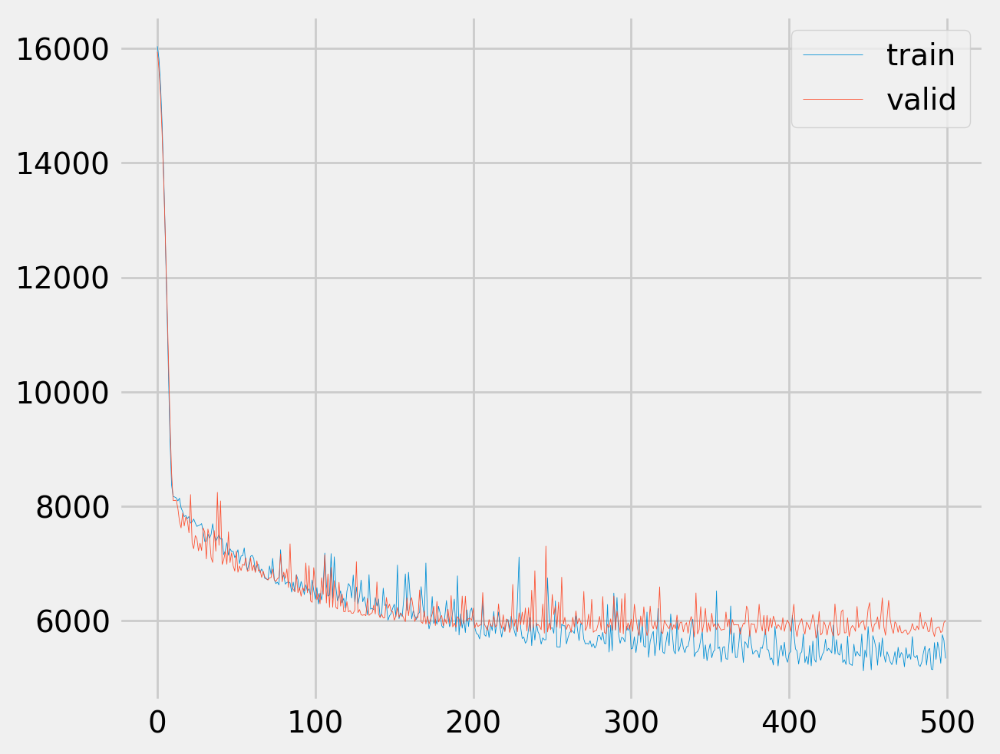

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-73-a000df0fdf5f>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


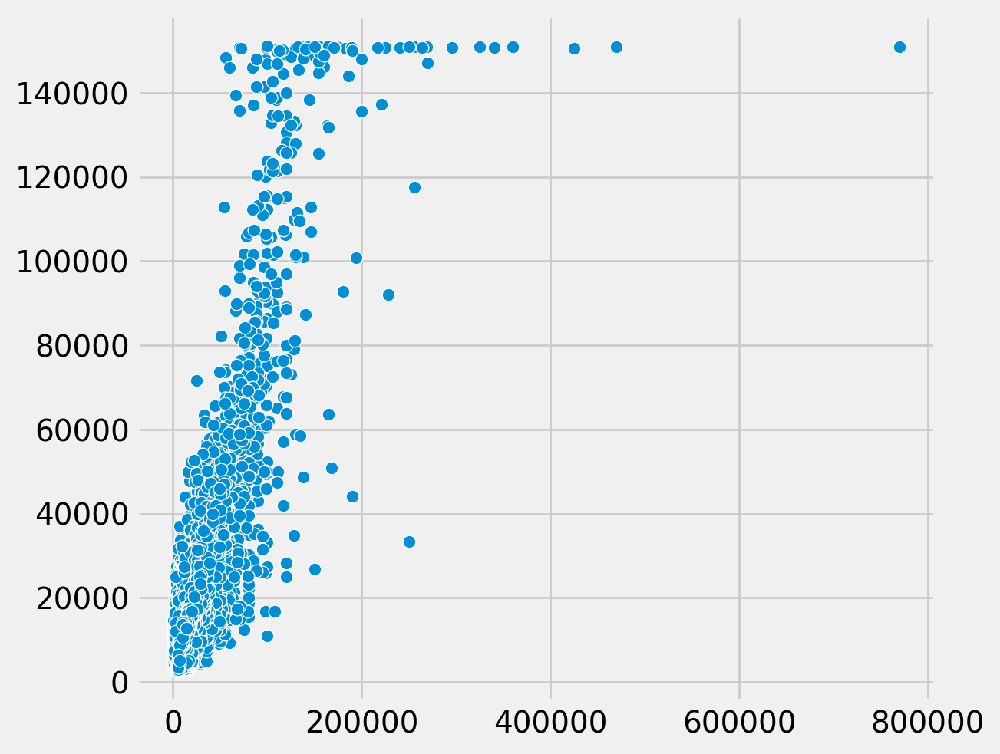

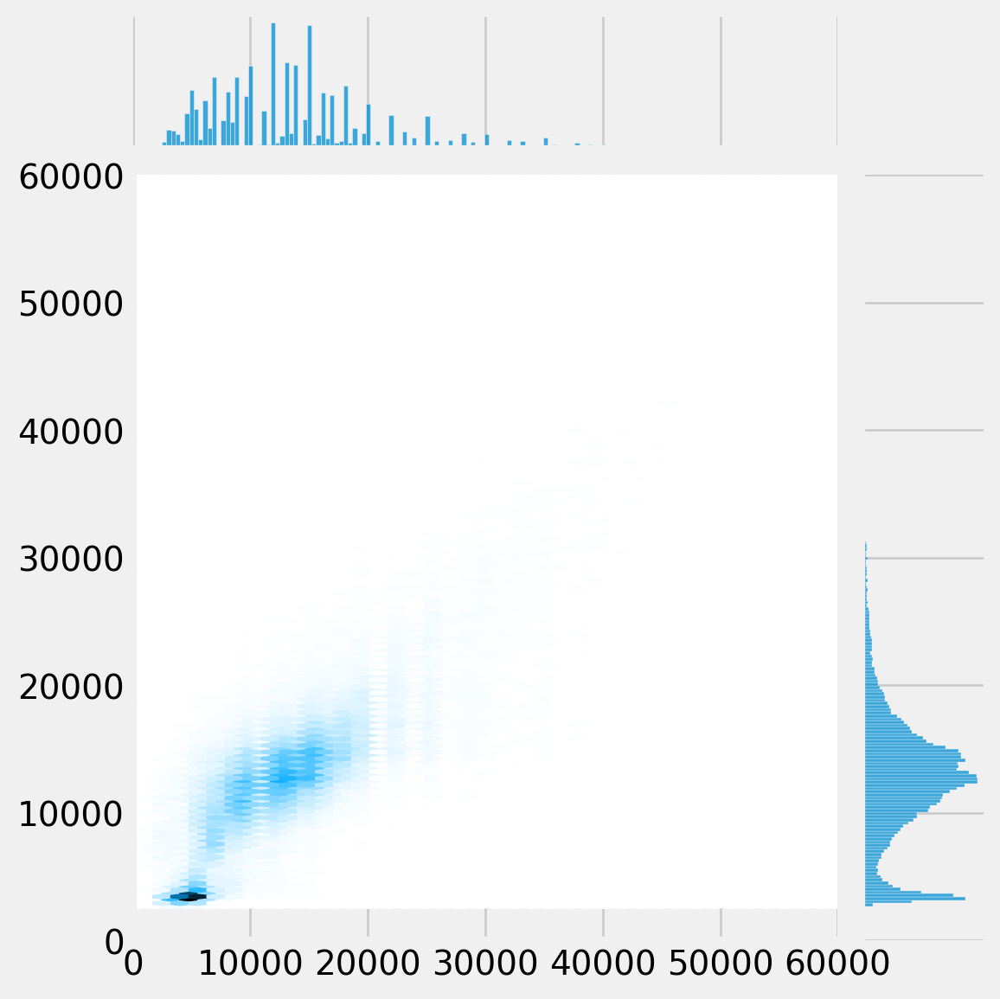

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


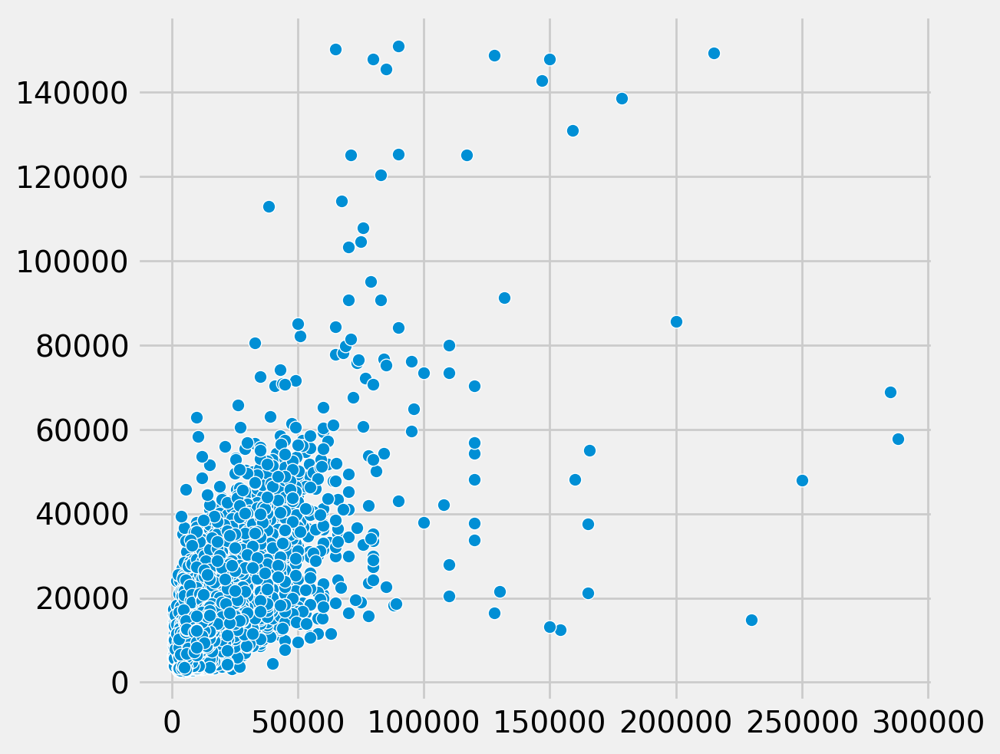

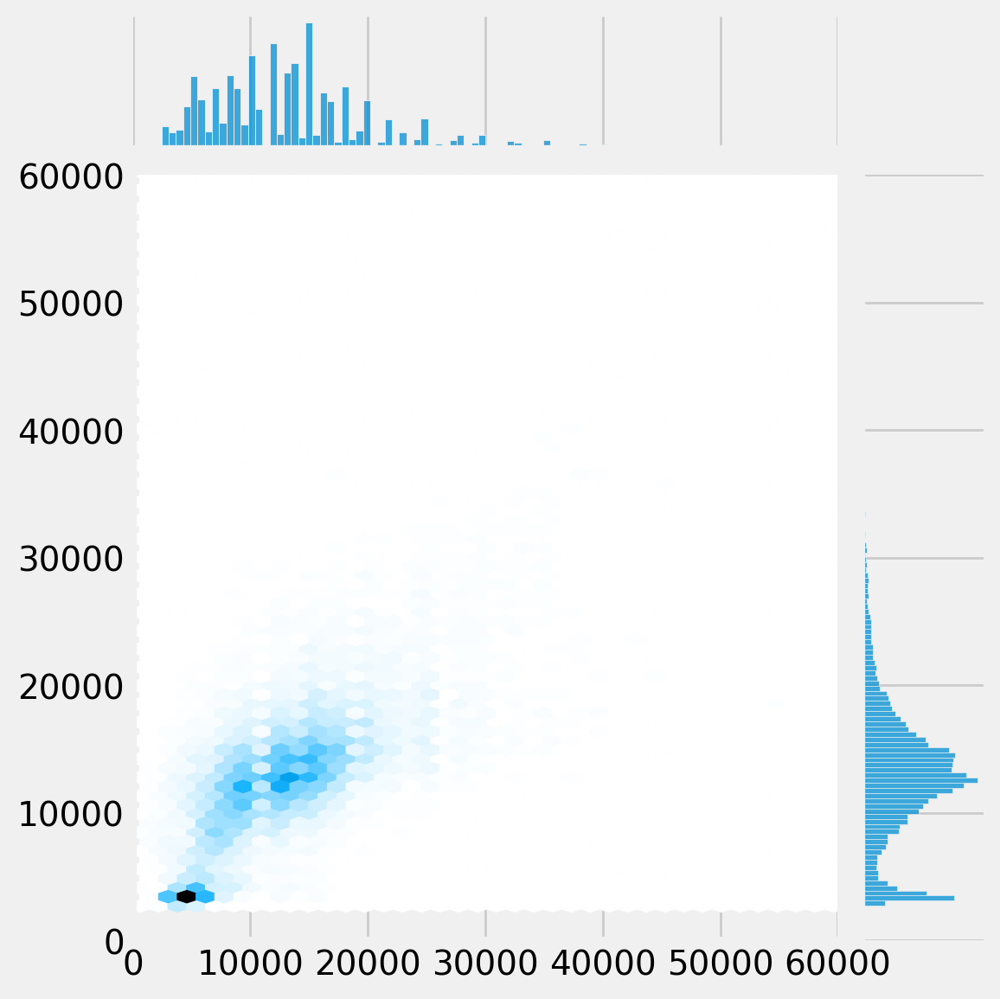

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


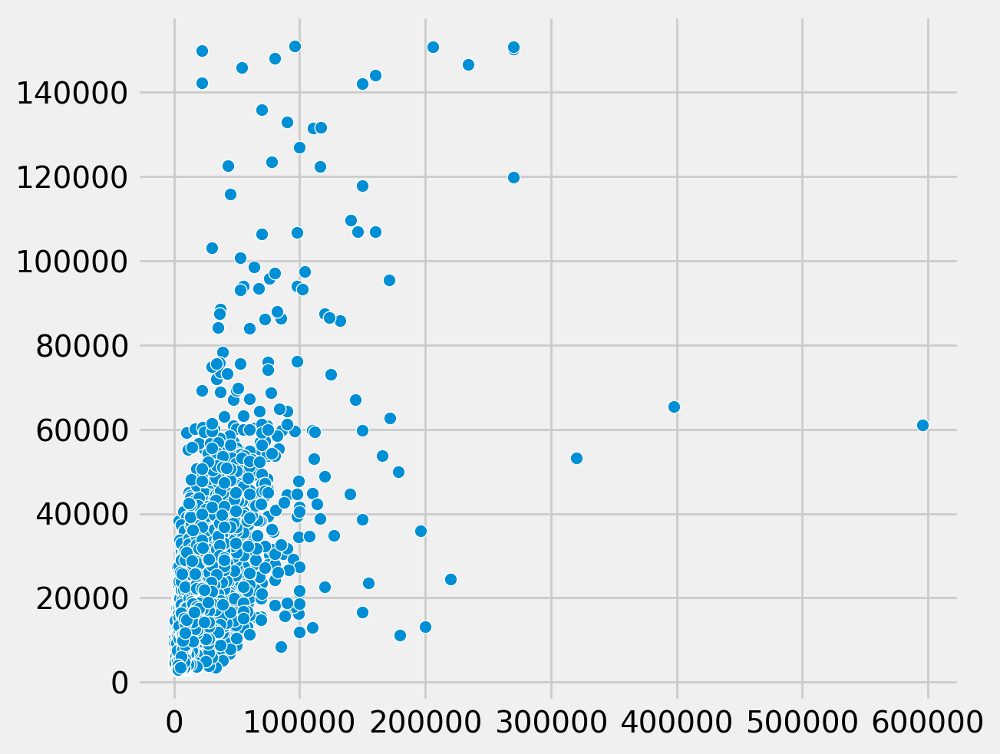

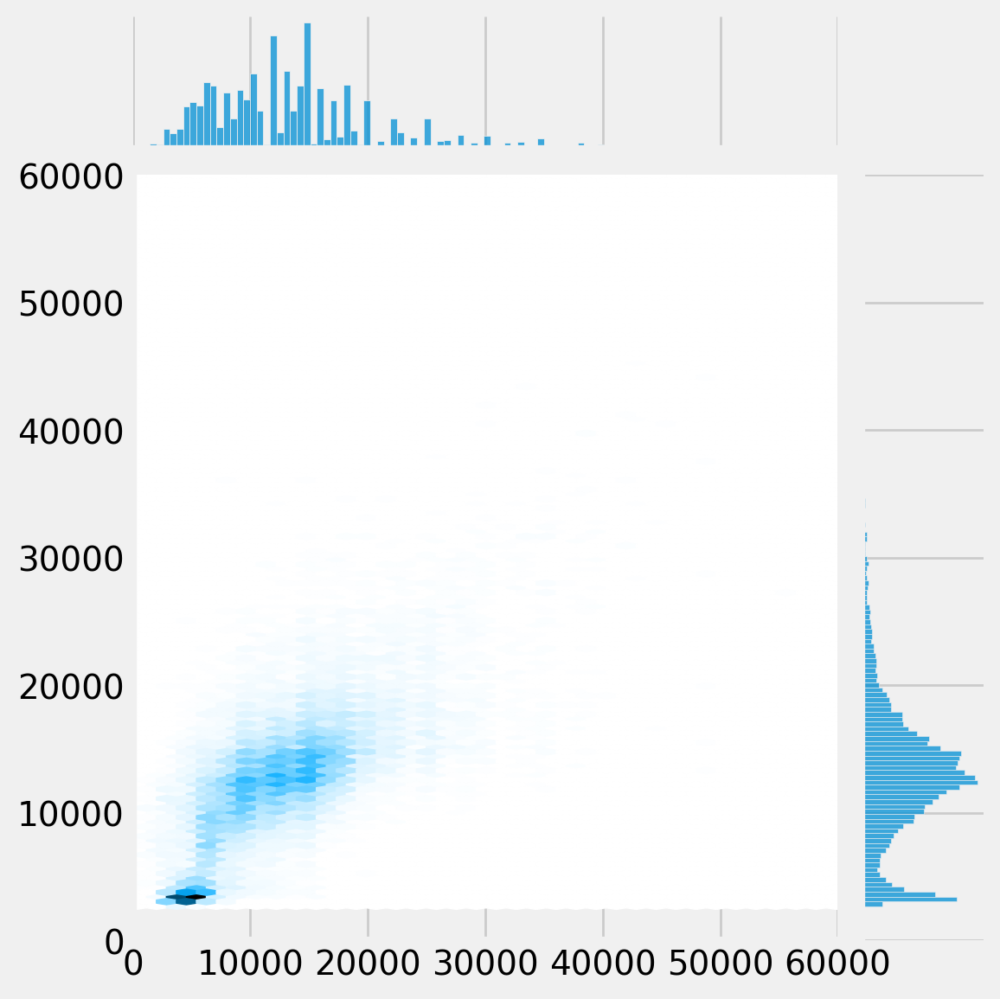

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


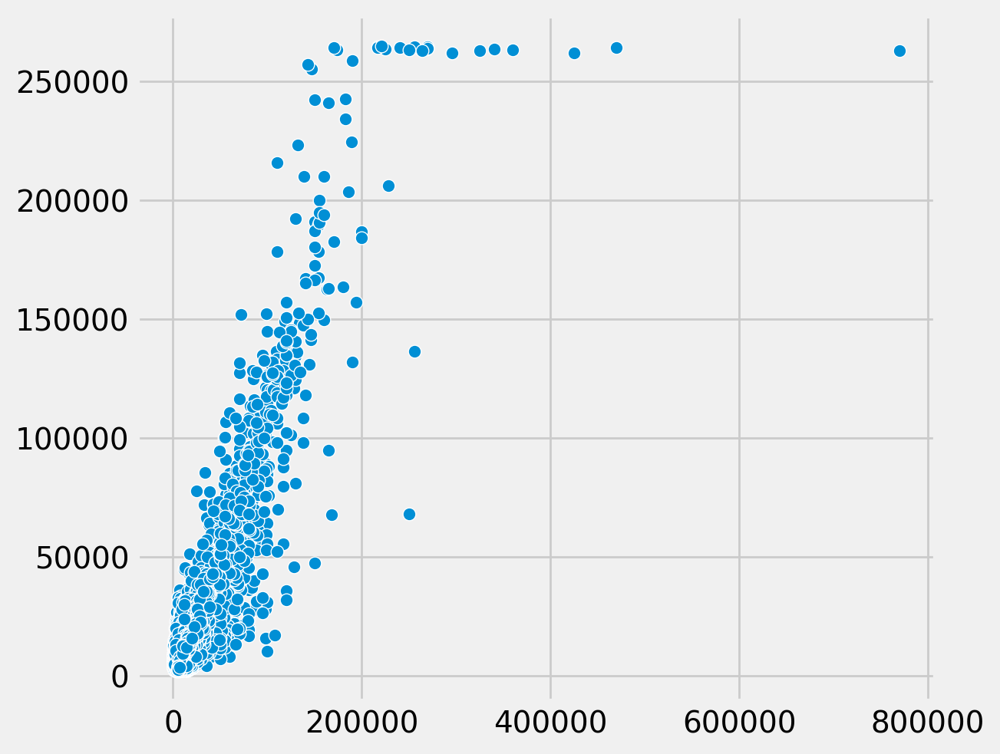

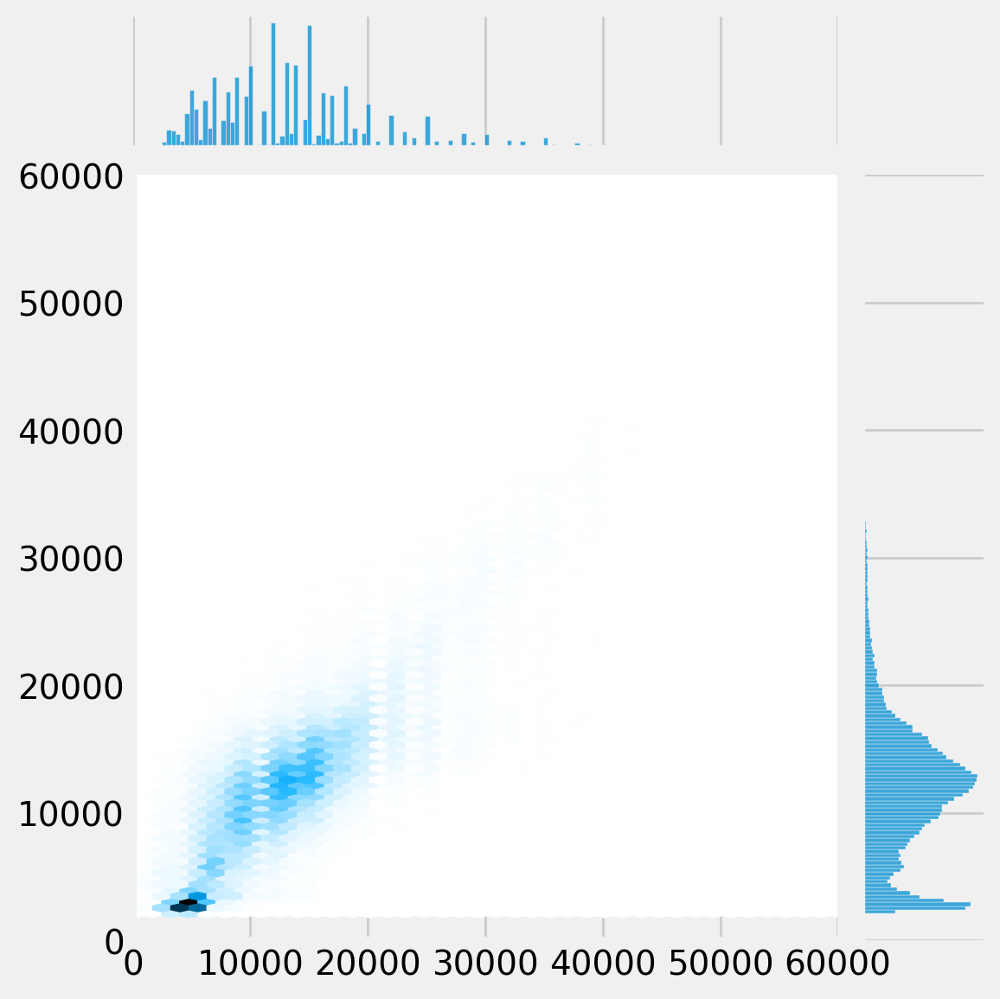

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


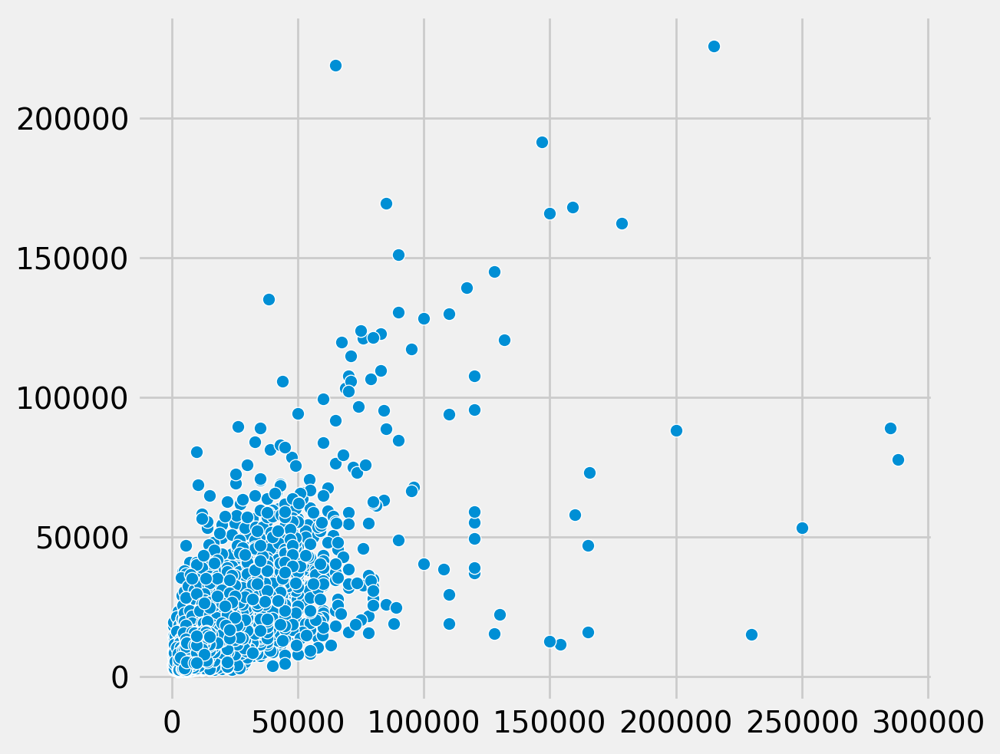

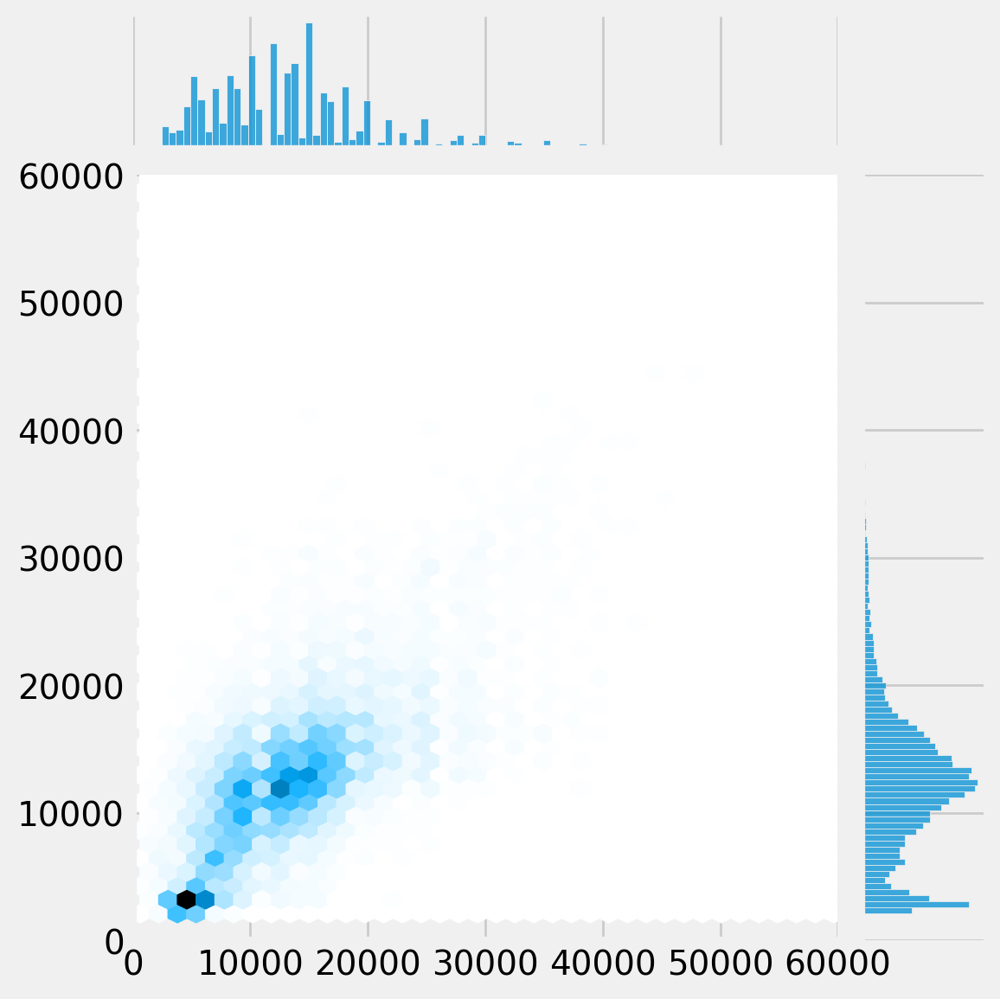

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


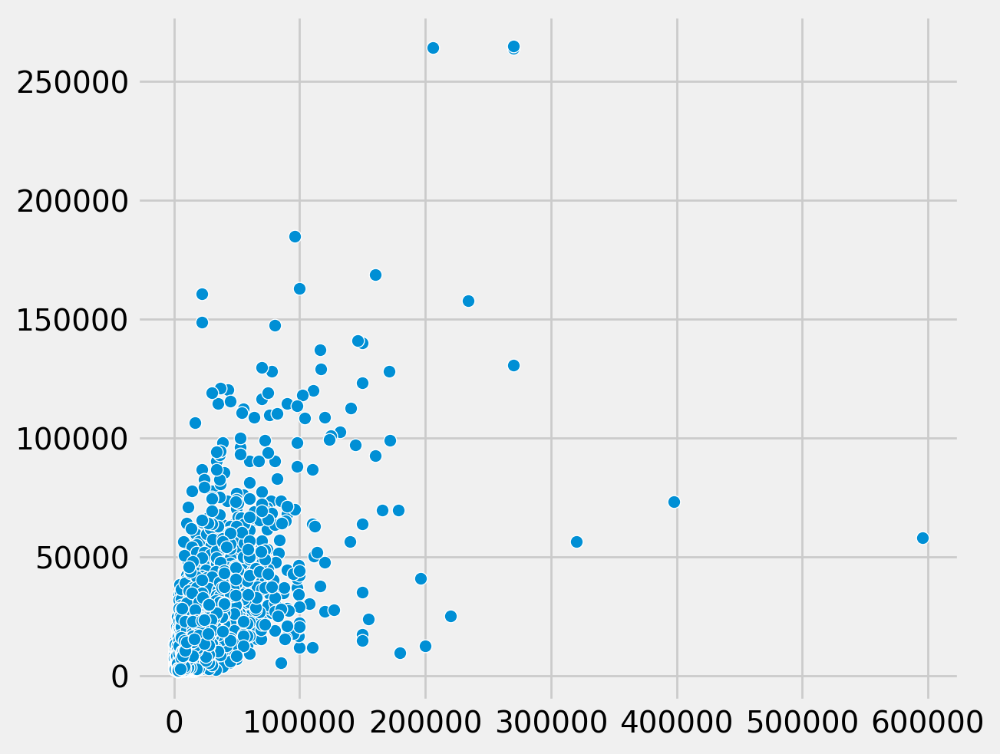

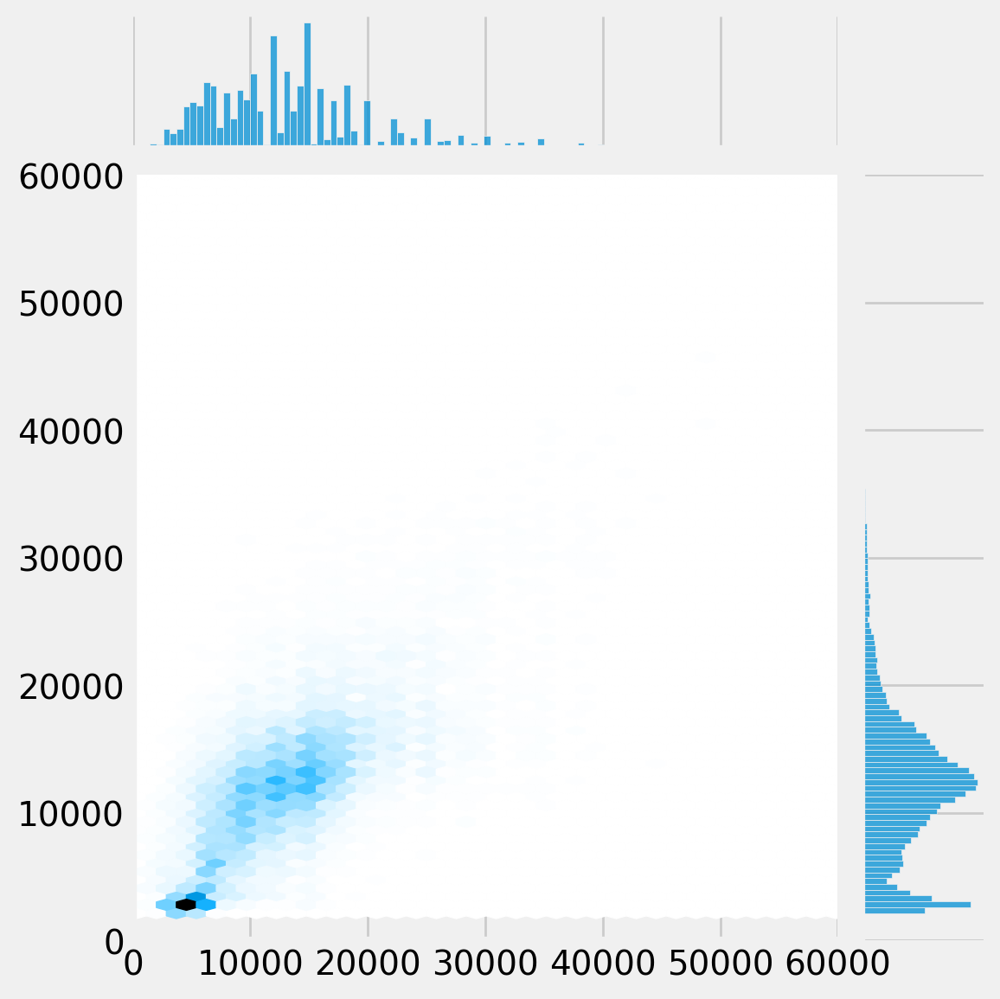

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

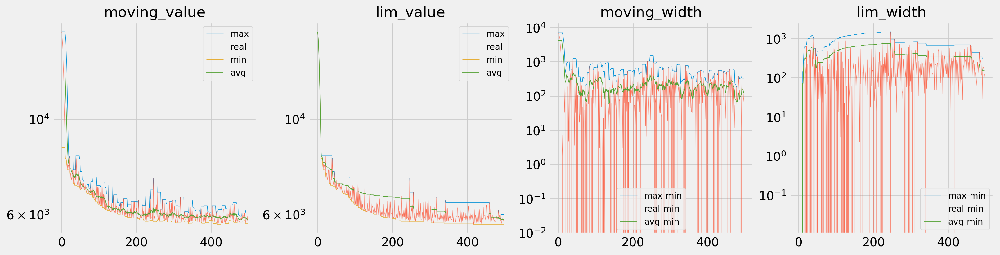

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

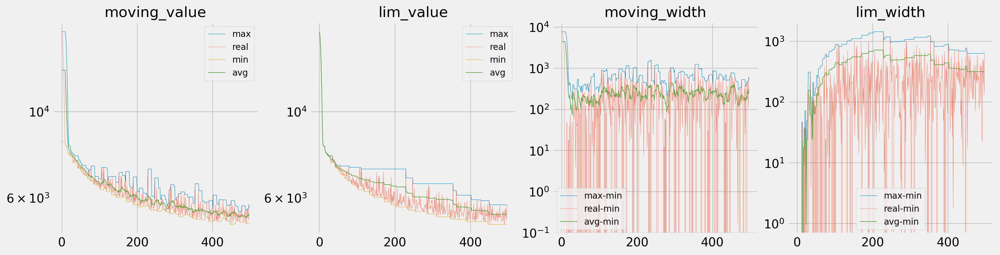

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

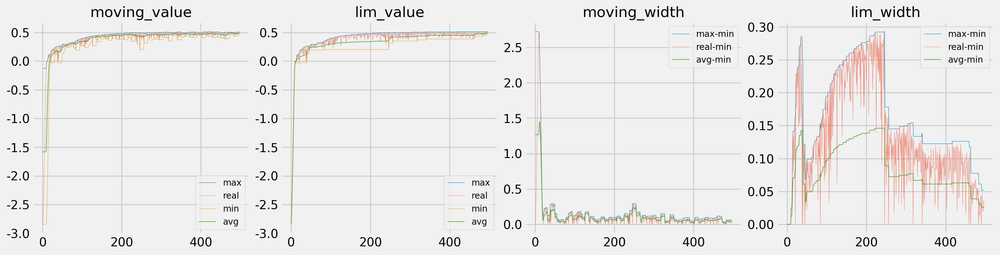

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);